## Load Datasets

In [138]:
# Utils
from joblib import Parallel, delayed
from tqdm.autonotebook import tqdm
from datetime import datetime
import json
from IPython.display import display, Audio
from pathlib2 import Path
import pickle

# data libs
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import librosa

# Clustering
import umap
import umap.plot

import hdbscan

# hyperparam tuning (Baysian
#from hyperopt import fmin, tpe, hp, partial, STATUS_OK
#from hyperopt import Trials, space_eval

# Parallelize
from joblib import Parallel, delayed
n_jobs = 20; verbosity = 1

# noise reduction
import noisereduce as nr

In [139]:
from avgn.signalprocessing.spectrogramming import spectrogram
from avgn.utils.audio import load_wav, float32_to_int16, int16_to_float32, write_wav
from avgn.visualization.spectrogram import visualize_spec, plot_spec

In [140]:
import tensorflow as tf

In [141]:
print(tf.config.list_physical_devices('GPU'))

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:2', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:3', device_type='GPU')]


In [137]:
!python -c "import tensorflow as tf; print(tf.config.list_physical_devices('GPU'))"


/bin/bash: /home/h21/luas6629/miniconda3/lib/libtinfo.so.6: no version information available (required by /bin/bash)
2023-08-03 14:24:33.309682: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-08-03 14:24:35.045899: E tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:266] failed call to cuInit: CUDA_ERROR_COMPAT_NOT_SUPPORTED_ON_DEVICE: forward compatibility was attempted on non supported HW
2023-08-03 14:24:35.046074: E tensorflow/compiler/xla/stream_executor/cuda/cuda_diagnostics.cc:312] kernel version 525.116.4 does not match DSO version 535.86.5 -- cannot find working devices in this configuration
[]


In [5]:
cd '/data0/home/h21/luas6629/Thesis/'

/data0/home/h21/luas6629/Thesis


In [115]:
# wrapper lib
from avgn.utils.paths import DATA_DIR, ensure_dir

DATA_DIR = Path('./data')
DSLOC = DATA_DIR / 'raw' / 'fruitbat'

DATA_SYLLABLES_SIM = DATA_DIR / 'Emitters'

In [116]:
context_dict = {
    0:'Unknown',
    1:'Separation',
    2:'Biting',
    3:'Feeding',
    4:'Fighting',
    5:'Grooming',
    6:'Isolation',
    7:'Kissing',
    8:'Landing',
    9:'Mating protest',
    10:'Threat-like',
    11:'General',
    12:'Sleeping',
}


In [117]:
annotations =  pd.read_csv(DSLOC/'Annotations.csv')

annotations = annotations.astype({
    'FileID' : int,
    'Emitter' : int,
    'Addressee' : int,
    'Context' :int,
    'Emitter pre-vocalization action' : int,
    'Addressee pre-vocalization action': int,
    'Emitter post-vocalization action' : int,
    'Addressee post-vocalization action' : int,
    'Start sample': float,
    'End sample' : float
})

len(annotations)

91080

In [142]:
annotations.query(f'Context not in {[0]} and Addressee not in {list(range(-300,1))}')

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
12504,53480,228,233,10,2,2,3,3,228173.0,672592.0
12510,53534,0,226,10,2,2,3,3,182388.0,492368.0
12512,53560,226,233,10,2,2,4,4,1.0,648016.0
12525,53695,0,226,11,2,2,3,3,1.0,623440.0
12530,53818,228,233,10,2,2,3,3,1.0,615248.0
...,...,...,...,...,...,...,...,...,...,...
91072,293205,208,221,12,2,2,3,3,1.0,328528.0
91073,293215,207,221,12,2,2,3,3,1.0,1229648.0
91076,293230,208,221,12,2,2,3,3,1.0,598864.0
91077,293232,207,221,12,2,2,3,3,1.0,336720.0


In [119]:
""" fruit bat db is malformed. 
Recreate the db with proper columns.
"""

with open(DSLOC/'FileInfo.csv', 'r') as temp_f:
    # get No of columns in each line
    col_count = [ len(l.split(",")) for l in temp_f.readlines() ]

### Generate column names  (names will be 0, 1, 2, ..., maximum columns - 1)
column_names = [i for i in range(0, max(col_count))]


### Read csv
file_info = pd.read_csv(DSLOC/'FileInfo.csv', header=None, delimiter=",", names=column_names)
file_info, file_info.columns = file_info[1:] , file_info.iloc[0]


# recreate the header
samples_boundaries = np.arange(1, 1 + file_info.shape[1] - 6)
voice_starts = samples_boundaries[::2]
voice_ends = samples_boundaries[1::2]
col_samples_boundaries = { val : float for pair in zip(['voice_start_sample_{}'.format(i + 1)for i in range(len(voice_starts))  ], 
        ['voice_end_sample_{}'.format(i + 1) for i in range(len(voice_ends))  ]) for val in pair }

col_names = ['FileID','TreatmentID','File name','File folder','Recording channel','Recording time'] + \
    [ val for pair in zip(['voice_start_sample_{}'.format(i + 1)for i in range(len(voice_starts))  ], 
        ['voice_end_sample_{}'.format(i + 1) for i in range(len(voice_ends))  ]) for val in pair]

columns_types = {
    'FileID' : int,
    'TreatmentID' : int,
    'File name' : str,
    'File folder' : str,
    'Recording channel' : int,
    'Recording time' : 'datetime64[ms]',
} | col_samples_boundaries

 
# set the new header
file_info.columns = columns_types.keys()


#ensure datatypes are meaningful
file_info = file_info.astype(columns_types)

# set index
#file_info.set_index('FileID', inplace=True)

# shape
file_info.shape

/tmp/ipykernel_935675/3013203441.py:14: DtypeWarning: Columns (0,1,4,6,7,8,9,10) have mixed types. Specify dtype option on import or set low_memory=False.
  file_info = pd.read_csv(DSLOC/'FileInfo.csv', header=None, delimiter=",", names=column_names)


(293238, 332)

In [182]:
len(np.unique(file_info['FileID'].values))

293238

In [183]:
file_info[file_info['File name'] == '121003123656832262.WAV']

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
59995,59995,9,121003123656832262.WAV,files201,3,2012-10-03 12:36:56,53896.0,98591.0,98613.0,140915.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Text(0.5, 0, 'Number of vocalizations (known Emitters and Addressees)')

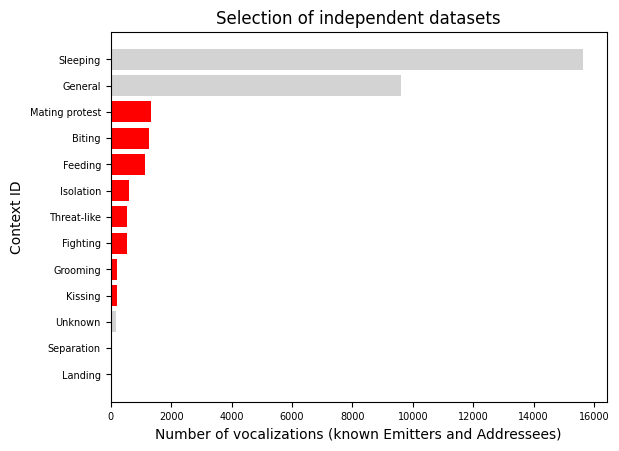

In [184]:
# Plot by Emitter

tmp = annotations.query(f'Context not in {[0, 11, 12]} and Addressee > {0} and Emitter > {0}').groupby('Emitter')[['Context']].count()
#tmp = annotations.query(f'Addressee > {0} and Emitter > {0}').groupby('Emitter')[['Context']].count()

# Plot by Context
tmp = annotations.query(f'Addressee > {0} and Emitter > {0}').groupby('Context')[['Emitter']].count()


tmp.sort_values(by = 'Emitter', ascending=True, inplace=True)
#tmp.tail(5)

colors = ['lightgray'] * len(tmp)
colors[3:10] = ['red'] * 8

#colors = np.where(tmp.index.isin([215, 216, 226, 230, 231  ]), 'red', 'lightgray').astype(str)


#plt.barh(tmp.index.astype(str), tmp.Context, color=colors)
plt.barh(list(map(lambda x : context_dict[x], tmp.index)), tmp.Emitter, color=colors)
plt.title('Selection of independent datasets') 
plt.rc('xtick', labelsize=7)
plt.rc('ytick', labelsize=7)
plt.ylabel('Context ID') 
plt.xlabel('Number of vocalizations (known Emitters and Addressees)')


In [185]:
tmp

,Emitter
Context,
8,5
1,6
0,175
7,198
5,209
4,531
10,533
6,610
3,1126


In [338]:
annotations[annotations['Emitter'] > 0].groupby('Emitter').size().sort_values()

Emitter
103      62
118      62
218      67
105      73
214      91
223      92
113      97
222     102
202     148
107     156
116     159
233     168
114     180
108     190
101     197
115     230
112     271
102     307
205     426
225     468
203     579
201     634
120     659
221     765
208     779
119     786
110    1058
204    1086
213    1239
207    1245
109    1329
111    1341
220    1426
210    1493
228    1653
211    2225
226    2310
216    2524
231    3051
230    3269
215    6150
dtype: int64

## Emitter dataset

In [11]:
#queries

'Context not in [0,11,6,12] and Emitter in [215] and Addressee  not in [0]'

# Isolations - Emitted by young pups
'TreatmentID in [11,12,13,14,15]'

# Pup to Mother
'Emitter in [207] and Addressee in [209]'



'Emitter in [207] and Addressee in [209]'

In [170]:
#mothers = [104, 106, 107, 110, 112, 114, 119, 209, 204, 212, 205, 213, 217, 226, 224, 228, 225, 232, 203]

bats = [i for i in np.unique(annotations['Emitter'].values) if i > 0]

#pups = [103, 105, 108, 111, 113, 115, 120, 202, 207, 208, 210, 211, 214, 215, 216, 220, 221, 222, 230, 231]

wild_bats = [101, 102, 109, 116, 118, 201, 218, 223, 233]

pup_to_mother_pairs = [(103, 104), (105, 106),(108, 107), (111,110), (113, 112), (115, 114), (120, 119), 
                    (207, 209), (208, 204), (210, 212), (211, 205), (214, 213), (215, 217), (216, 226),
                   (221, 228), (222, 225), (230, 232), (231,203)]

pups = [t[0] for t in pup_to_mother_pairs]

mothers = [t[1] for t in pup_to_mother_pairs]

# 211 > 205 ? 202 - 202 ??

In [207]:
q = annotations.query(f'Emitter in {bats} and Addressee in {bats} and Context in [9, 12] ')

In [52]:
annotations.query(f'Context not in [0]').Emitter.loc[lambda x : x > 0].value_counts()

215    6136
230    3258
231    3039
216    2512
226    2304
211    2220
228    1648
210    1484
220    1422
109    1327
111    1325
213    1238
207    1235
204    1083
110    1055
119     784
208     778
221     763
120     652
201     632
203     578
225     462
205     426
102     307
112     270
115     229
101     197
108     189
114     179
233     166
116     158
107     155
202     148
222     102
113      93
223      92
214      90
218      67
118      61
105      43
103      11
Name: Emitter, dtype: int64

In [185]:
q = annotations.query(f'Emitter in {mothers} and Context not in [0] ')

In [187]:
q.groupby('Emitter').size()

Emitter
107     155
110    1055
112     270
114     179
119     784
203     578
204    1083
205     426
213    1238
225     462
226    2304
228    1648
dtype: int64

In [255]:
q = annotations.query(f'Emitter in {[226]} and Context not in [0] ')
q

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
12506,53520,226,0,11,2,2,3,3,1.0,328528.0
12512,53560,226,233,10,2,2,4,4,1.0,648016.0
12523,53642,226,0,11,2,2,3,4,1.0,992080.0
12524,53643,226,0,10,2,2,3,3,1.0,525136.0
12572,54242,226,233,10,2,2,3,3,1.0,410448.0
...,...,...,...,...,...,...,...,...,...,...
37782,146298,226,233,11,2,3,3,3,1.0,344912.0
37783,146300,226,233,11,2,2,3,3,1.0,344912.0
37788,146381,226,233,12,2,2,3,3,1.0,459600.0
37811,146475,226,213,3,2,2,3,3,1.0,394064.0


In [256]:
q.groupby('Addressee').size()

Addressee
0        86
111       8
120       6
213      69
214       3
216      17
221       5
228     176
233    1934
dtype: int64

In [87]:
q['FileID'].value_counts()

174421    3
177978    2
176522    2
200462    2
173590    2
         ..
183110    1
183116    1
183117    1
183118    1
275508    1
Name: FileID, Length: 3010, dtype: int64

In [220]:
q.set_index('FileID').loc[q['FileID'].value_counts() != 1]

,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
FileID,,,,,,,,,
61705,223,218,12,2,2,3,3,1.0,159398.0
61705,223,218,12,2,2,3,3,347139.0,787280.0
61738,228,233,12,2,2,3,3,219463.0,565903.0
61738,228,233,12,2,2,3,3,3059026.0,3384144.0
61764,225,218,12,2,2,3,3,1.0,50288.0
...,...,...,...,...,...,...,...,...,...
275158,216,221,12,2,2,3,3,477168.0,688078.0
289875,216,208,12,2,2,3,3,1.0,741278.0
289875,216,221,12,2,2,3,3,741279.0,2196304.0


In [14]:
#q = annotations.query(f'Emitter in {bats} and Addressee in {bats} and Context not in [0,11]')
#sample_fileIDs = file_info.query('FileID in [{}]'.format(','.join(str(x) for x in q['FileID'])))

In [59]:
pups, mothers = [x[0] for x in pup_to_mother_pairs], [x[1] for x in pup_to_mother_pairs]

In [16]:
#!tar -cf bat_archive_40000.tar $(cat annotated_files_40000.txt)

In [21]:
q = annotations.query(f'Emitter in {wild_bats} and Addressee in {wild_bats} and Context not in [0] ')

#sample_files = file_info.query('FileID in [{}]'.format(','.join(str(x) for x in q['FileID'])))
#sample_files = file_info.set_index('FileID').loc[q['FileID']].reset_index()
#sample_fileIDs = sample_files.index.values

q['Context'].value_counts()

11    178
9      88
12     83
4      10
10      2
2       2
3       2
Name: Context, dtype: int64

In [257]:
def get_sample_files(q):
    
    #if file_info.index.name != 'FileID':
    #    file_info.set_index('FileID') 
        
    #return file_info.query('FileID in [{}]'.format(','.join(str(x) for x in q['FileID'])))
    sample_files = file_info.set_index('FileID').loc[q['FileID']].reset_index()
    return sample_files
    
get_sample_files(q).shape

(2304, 332)

In [258]:
# how many segments there should be, at most?
# At most - some files have annotations of different animals

def test_segment_numbers(q):
    sample_files = get_sample_files(q)
    
    s = 0
    for i in range(sample_files.shape[0]):
        s += (len(sample_files.iloc[i].dropna()) - 6) / 2
        
    return s

test_segment_numbers(q)

15340.0

In [24]:
# Test - Is There are duplicate file ?
len(get_sample_files(q).FileID.unique()) < get_sample_files(q).shape[0]

True

In [19]:
fileID, c, ix = np.unique(get_sample_files(q).FileID.values, return_counts=True, return_index=True)

In [30]:
fileID

array([ 58196,  59887,  61127, ..., 146699, 146701, 146708])

In [20]:
get_sample_files(q)[get_sample_files(q)['FileID'] == 58196]

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
0,58196,11,121002212651151905.WAV,files201,11,2012-10-02 21:26:51,37678.0,66019.0,105273.0,124646.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
q[q['FileID'] == 87179]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
22988,87179,216,228,11,3,2,2,3,1.0,52069.0
22989,87179,216,228,6,3,2,2,3,52070.0,129350.0
22990,87179,216,228,11,3,2,2,3,129351.0,178630.0
22991,87179,216,228,6,3,2,2,3,178631.0,697168.0


In [21]:
# some files are annotated twice
file_info.loc[ 87179].dropna()

FileID                                   87179
TreatmentID                                  9
File name               121103045057225251.WAV
File folder                           files204
Recording channel                            3
Recording time             2012-11-03 05:10:08
voice_start_sample_1                       1.0
voice_end_sample_1                     14957.0
voice_start_sample_2                   52070.0
voice_end_sample_2                    102957.0
voice_start_sample_3                  129351.0
voice_end_sample_3                    154044.0
voice_start_sample_4                  178631.0
voice_end_sample_4                    193332.0
voice_start_sample_5                  207141.0
voice_end_sample_5                    223457.0
voice_start_sample_6                  321546.0
voice_end_sample_6                    334190.0
voice_start_sample_7                  380586.0
voice_end_sample_7                    419457.0
voice_start_sample_8                  608211.0
voice_end_sam

In [28]:
sample_files['File name'].unique().shape == sample_files.FileID.unique().shape, sample_files['File name'].unique().shape

(True, (1582,))

## Acoustics Properties

#### Functions

In [33]:
# This is another useful approach to unsupervised clustering, once clusters are inferred from dendrograms

In [188]:
import librosa
from scipy.signal import butter, lfilter

from matplotlib import pyplot as plt

In [121]:
# Global Settings

sr = 250000
n_fft = 2048
fmin = 200
fmax = 120000
n_mels = 64
hop_length = 256
win_length=1024


In [122]:
(256 / 2500000)

0.0001024

In [123]:
# sepctrograms and preprocessing

def stft(audio, **kwargs):
    # Compute the spectrogram using Short-Time Fourier Transform (STFT)

    stft = librosa.stft(y=audio, n_fft=n_fft, hop_length=hop_length, win_length = win_length)

    #using avgn
    #stft = _stft(segment, rate, bat_hparams)

    spec = np.abs(stft)
    return spec

def spectral_constrast(spectrogram, **kwargs):
    return librosa.feature.spectral_contrast(sr=sr, S=spectrogram, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window='hann', center=True, pad_mode='constant', freq=None, fmin=fmin, n_bands=6, quantile=0.02, linear=False)

def spectral_centroids(spectrogram, **kwargs):
    return librosa.feature.spectral_centroid(sr=sr, S=spectrogram, n_fft=n_fft, hop_length=hop_length, freq=None, win_length=win_length, window='hann', center=True, pad_mode='constant')
    
def spectral_centroid_descriptive(centroids):
    return np.mean(centroids), np.median(centroids), np.std(centroids)

def temporal_centroid_descriptive(spectrogram, sr=sr):
    
    sample_indices = np.arange(spectrogram.shape[1])
    temporal_centroid = np.sum(sample_indices * spectrogram) / np.sum(spectrogram)

    # Convert sample index to time in seconds
    temporal_centroid_sec = librosa.samples_to_time(temporal_centroid, sr=sr)
    return temporal_centroid_sec
    
def spectral_rolloff(spectrogram, roll_percent=0.85, **kwargs):
    return librosa.feature.spectral_rolloff(S=spectrogram,  sr=sr, n_fft=n_fft, hop_length=hop_length, win_length=win_length, roll_percent=roll_percent)

def spectral_bandwidth (spectrogram, **kwargs):
    return librosa.feature.spectral_bandwidth(sr=sr, S=spectrogram, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window='hann', center=True, pad_mode='constant', freq=None, centroid=None, norm=True, p=2)

def spectral_flatness(spectrogram, **kwargs):
    # passing a spec, not a power spec
    return librosa.feature.spectral_flatness(S=spectrogram, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window='hann', center=True, pad_mode='constant', amin=1e-10, power=2.0)


def fundamental_note(segment):
    # denoise and preemphasise first
    # nan values are turn into 0
    f0, voiced, prob = librosa.pyin(y=segment, fmin=fmin, fmax=fmax, sr=sr, frame_length=n_fft, win_length=win_length, hop_length=hop_length, n_thresholds=100, beta_parameters=(2, 18), boltzmann_parameter=2, resolution=0.1, max_transition_rate=35.92, switch_prob=0.01, no_trough_prob=0.01, fill_na=0, center=True, pad_mode='constant')
    return f0
    

def butter_bandpass(lowcut=256, highcut=120000, fs=250000, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut=256, highcut=120000, fs=250000, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y


# filter signal

from scipy.signal import butter, sosfilt

def bandpass_filter(audio_data, low_freq=256, high_freq=120000, rate=250000, order=5):
    sos = butter(order, Wn = [low_freq, high_freq], btype='bandpass', fs=rate, output='sos')
    filtered_audio = sosfilt(sos, audio_data)
    return filtered_audio
    

def denoise(y, sr ):
    """
    https://github.com/timsainb/noisereduce
    I tuned them check with files
    """

    y = nr.reduce_noise(y=y, sr=sr, 
                        time_constant_s= 0.2,
                        time_mask_smooth_ms = 5,
                        stationary = False,
                        freq_mask_smooth_hz = 256,
                        n_fft = n_fft,
                        hop_length = hop_length,
                        win_length = win_length,
                        n_jobs = 4
                        )
    
    return y

def preemphasise(y, pre_emphasis = 0.97):
    
    #  emphasized_signal
    y = np.append(y[0], y[1:] - pre_emphasis * y[:-1])
    
    return y

    

# Utils for testing

def plot_and_play_wav(filename, desired_rate = 44100, labels = None):
    
    """
    Plots and plays a WAV file with optional labels on the X-axis.
    
    Args:
        filename (str): Filepath of the WAV file to be plotted and played.
        desired_rate (int): Desired sampling rate for audio playback (default: 44100).
        labels (list): List of labels to be plotted on the X-axis (default: None).
        
    Returns:
        None
    """
    
    rate, data, start_times, end_times = get_wav_info(filename)
    
    fig, ax = plt.subplots(nrows=1,ncols=1, figsize=(20,4))
    plt.plot(data, color='black')
    ax.set_xlim((0, len(data)))
    ax.axis('off')

    # not selected silence
    for st, et in zip(end_times[:-1], start_times[1:]):
        ax.axvspan(st, et, alpha=0.8, color='black')

    ax.axvspan(0, start_times[0], alpha=0.8, color='black')
    ax.axvspan(end_times[-1], len(data), alpha=0.8, color='black')

    # selected
    for st, et in zip(start_times, end_times):
        ax.axvline(x=st, color = 'red', lw=2)
        ax.axvline(x=et, color='red', lw=2)
    
    # place labels
    if labels is not None:
        # position
        index_positions = [(et - st) / 2 + st for st, et in zip(start_times, end_times)]

        # Plot labels on the X-axis
        for i, label in enumerate(labels):
            ax.text(index_positions[i], min(data), label, ha='center', va='bottom', fontsize=24, color='white', backgroundcolor='red')

        
        
    plt.show()

    display(Audio(data = data, rate = desired_rate))
   

In [124]:
# props files

def get_wav_info(filename):
    #print('get_wav_info', filename)
    #wav_info = file_info[file_info['File name'] == filename]
    wav_info = file_info.set_index('File name').loc[filename]
    folder_loc = wav_info['File folder']
    wav_loc = DSLOC/'zip_contents'/ folder_loc / filename
    
    rate, data = load_wav(wav_loc)
    
    wav_info = wav_info.to_frame().T
    start_times = wav_info.loc[:, wav_info.columns.str.startswith('voice_start_')].dropna(axis=1).values[0]
    end_times = wav_info.loc[:, wav_info.columns.str.startswith('voice_end_')].dropna(axis=1).values[0]

    
    return rate, data, start_times, end_times


def preprocess_wavefile(filename):
    
    rate, data, start_times, end_times = get_wav_info(filename)    

    #y_filtered = butter_bandpass_filter(data)
    #y_filtered = data

    y_filtered = denoise(data, rate)
    y_filtered = preemphasise(y_filtered)
    
    return rate, y_filtered, start_times, end_times

def get_segment_list(start_times, end_times ):
    # duration all segments + intervals
    #l = list(zip(zip(start_times, end_times), zip(end_times,start_times[1:])))
    #segments = [item for sublist in l for item in sublist]
    
    # duration all segments (no intervals)
    segments = list(zip(start_times, end_times))
    durations = [end_time - start_time for start_time, end_time in segments]
    return segments, durations

def get_mfccs(y, sr, start_times, end_times):
    mfccs = []
    
    # duration
    segments, durations = get_segment_list(start_times, end_times)

    #for start, end in zip(start_times, end_times):
    for segment in segments:
        #start, end = int(start), int(end)
        start, end = int(segment[0]), int(segment[1])
        segment = y[start:end]
        
        mfcc = librosa.feature.mfcc(y = segment, sr=sr, n_fft = n_fft, win_length=win_length, hop_length=hop_length, n_mels=n_mels, fmax=fmax)
        mfccs.append(mfcc)

    return mfccs


def get_segments_audio(y, sr, start_times, end_times):
    voc_segments = []
    
    # duration
    segments, durations = get_segment_list(start_times, end_times)
    for segment in segments:
        start, end = int(segment[0]), int(segment[1])
        
        voc_segments.append(y[start:end])
        
    return voc_segments


def get_segments_ix(filename, start_times, end_times ):
    voc_segments_ix = []
    
    # folder_loc
    #wav_info = file_info[file_info['File name'] == filename]
    #folder_loc = wav_info['File folder']
    
    wav_info = file_info.set_index('File name').loc[filename]
    folder_loc = wav_info['File folder']
    
    
    segments, durations = get_segment_list(start_times, end_times)
    for i, segment in enumerate(segments):
        start, end = int(segment[0]), int(segment[1])
        
        voc_segments_ix.append((folder_loc, filename, i, start, end))
        
    return voc_segments_ix
        

def get_segments_spectrogram(y, sr, start_times, end_times):
    specs = []
    
    # duration
    segments, durations = get_segment_list(start_times, end_times)
    for segment in segments:
        start, end = int(segment[0]), int(segment[1])
        segment = y[ start : end]
        s = librosa.stft(segment, n_fft = n_fft, win_length=win_length, hop_length=hop_length)
        specs.append( np.abs(s) )
    
    return specs
    
def dynamic_time_warping_by_mfcc(mfccs):
    # Calculate dynamic time warping distances
    #distances = pairwise_distances(mfccs, metric='euclidean')
    distances = []
    for x in mfccs:
        for y in mfccs:
            D, wp = librosa.sequence.dtw(x, y)
            distances.append(D[wp[-1, 0], wp[-1, 1]])
            
    return distances

def get_segment_classes(filename, start_times, end_times, label_list):
    
    segments, durations = get_segment_list(start_times, end_times)
    
    # FileID
    fileID = file_info[file_info['File name'] == filename].index[0]
    #fileID = file_info.reset_index().set_index('File name').loc['121215185639207203.WAV']['FileID']
    
    labels = annotations.set_index('FileID').loc[int(fileID)][[*label_list]].values
    labels = ' '.join(map(str,map(int, np.unique(labels))))
    
    return [labels for segment in segments]
        

def get_mel_filterbanks(spectrogram, sr, start_times, end_times):
    melfb = librosa.filters.mel(sr=sr, n_fft=n_fft, fmin=fmin, n_mels=n_mels)
    return melfb.dot(spectrogram)


"""
Use the following
"""

def filter_segments_by_emitter(emitter, filename, annotations_by_emitter, preprocess = True):
    
    # get file
    
    if preprocess:
        
        sr, y, start_times, end_times = preprocess_wavefile(filename)
        
    else:
        
        sr, y, start_times, end_times = get_wav_info(filename)
    
    # get segments of file
    segments_in_file, durations = get_segment_list(start_times, end_times)
    fileID = file_info[file_info['File name'] == filename]['FileID'].values[0]
    folder = file_info[file_info['File name'] == filename]['File folder'].values[0]
    
    # segments to retain
    #segments_said_by_emitter = []
    #durations_said_by_emitter = []
    #context_said_by_emitter = []
    
    # voc_segment_index
    voc_segments = []
    voc_segments_ix = []
    durations = []
    observed_context = []
    observed_addressee = []
    
#    for j, sample in annotations_by_emitter[annotations_by_emitter['FileID'] == fileID].iterrows():
#        start_interval = sample['Start sample']
#        end_interval = sample['End sample']
#        context = sample['Context']
#        addressee = sample['Addressee']

    # k-th position of the segment
    for k, segment in enumerate(segments_in_file):
        start_seg = int(segment[0])
        end_seg = int(segment[1])

        # get annotations for each syllables
        # select vocalisations said by Emitter, with boundaries of utterances within the annotation
        # this is to handle cases of multiple annotations per one file, such as:
        # - different observed contexts
        # - different recorded Emitters
        
        selected_row = annotations_by_emitter.query(f"(`Emitter` == {emitter}) & (`FileID` == {fileID}) & (`Start sample` <= {start_seg}) & (`End sample` >= {end_seg}) ")        
        
        if selected_row.shape[0] > 0:
            context = selected_row.T.loc['Context'].astype(int).iloc[0]
            addressee = selected_row.T.loc['Addressee'].astype(int).iloc[0]

            # yield results
            voc_segments_ix.append((fileID, folder, filename, k, start_seg, end_seg))
            voc_segments.append(y[start_seg : end_seg])
            durations.append( end_seg - start_seg )
            observed_context.append( context )
            observed_addressee.append( addressee )
    
        """   
        if (start_seg >= start_interval) & (end_seg <= end_interval):
            #segments_said_by_emitter.append(segments_in_file[k])
            #durations_said_by_emitter.append(durations[k])
            #context_said_by_emitter.append(context)

            voc_segments_ix.append((fileID, folder, filename, k, start_seg, end_seg))
            voc_segments.append(y[start_seg : end_seg])
            durations.append( end_seg - start_seg )
            observed_context.append( context )
            observed_addressee.append( addressee )
        """
    
    return voc_segments, voc_segments_ix, durations, observed_context, observed_addressee
    

    
# test
#filter_segments_by_emitter(216, '121103045057225251.WAV', q, preprocess = True)

In [125]:
#q.query(f"(`Emitter` == {216}) & (`FileID` == {87179}) & (`Start sample` <= {1618639}) & (`End sample` >= {56}) ").T

In [32]:
file_info[file_info.FileID == 87179]

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
87179,87179,9,121103045057225251.WAV,files204,3,2012-11-03 05:10:08,1.0,14957.0,52070.0,102957.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Test

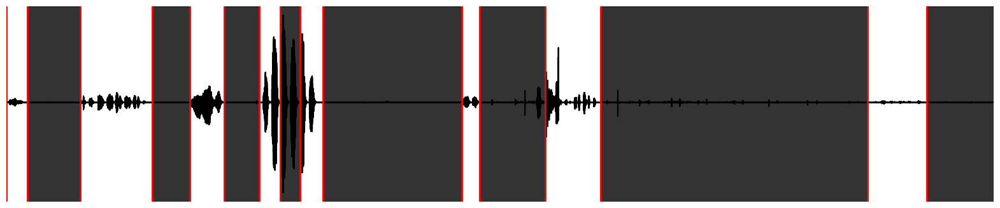

In [241]:
plot_and_play_wav('121103045057225251.WAV', 44100)

In [127]:
sr, data, start_times, end_times = get_wav_info('121103045057225251.WAV')

In [128]:
# test
filename_test = '121103045057225251.WAV'
#filename_test = '121012015156784309.WAV'
#filename_test  = '140218050022138776.WAV'
filename_test = '121004172921179484.WAV'
sr, data, start_times, end_times = get_wav_info(filename_test)

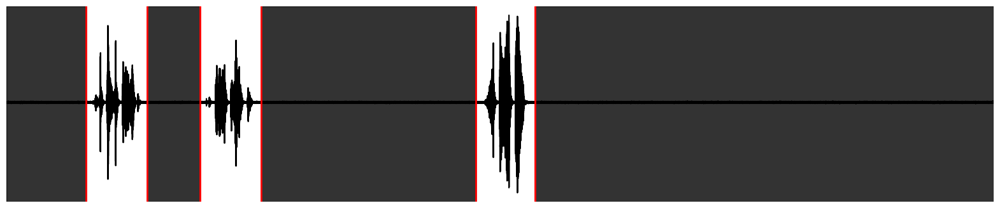

In [129]:
plot_and_play_wav(filename_test, 44100)

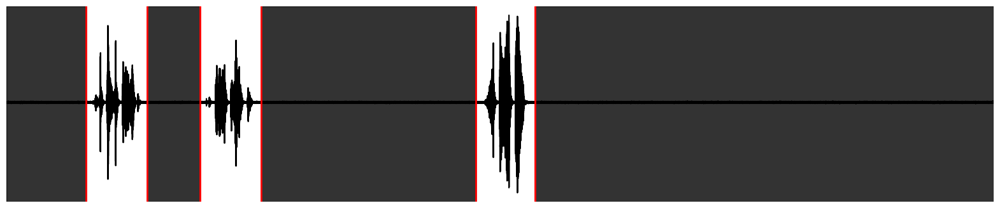

In [130]:
fig, ax = plt.subplots(nrows=1,ncols=1, figsize=(20,4))
plt.plot(data, color='black')
ax.set_xlim((0, len(data)))
ax.axis('off')

# not selected silence
for st, et in zip(end_times[:-1], start_times[1:]):
    ax.axvspan(st, et, alpha=0.8, color='black')
    
ax.axvspan(0, start_times[0], alpha=0.8, color='black')
ax.axvspan(end_times[-1], len(data), alpha=0.8, color='black')

# selected
for st, et in zip(start_times, end_times):
    ax.axvline(x=st, color = 'red', lw=2)
    ax.axvline(x=et, color='red', lw=2)
plt.show()

Audio(data = data, rate = 192000)

In [ ]:
from IPython.display import Audio, HTML
# Plot a segment

i = 1
segment = data[ int(start_times[ i]) : int(end_times[i]) ]



fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,4))
plt.plot(segment, color='black')
#ax.axis('off')
plt.show()

Audio(data = segment, rate = 192000)

In [317]:
pre_emphasis  = 0.97
emphasized_signal = np.append(segment[0], segment[1:] - pre_emphasis * segment[:-1])

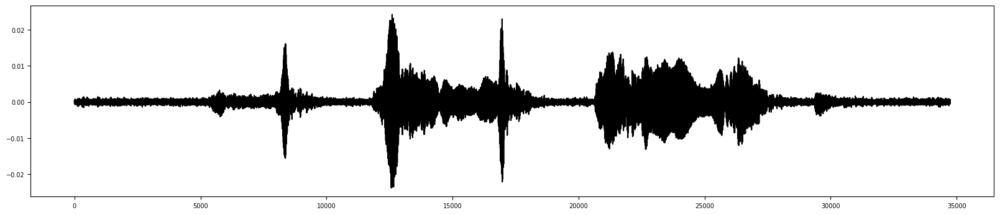

In [318]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,4))
plt.plot(emphasized_signal, color='black')
#ax.axis('off')
plt.show()

Audio(data = emphasized_signal, rate = 192000)

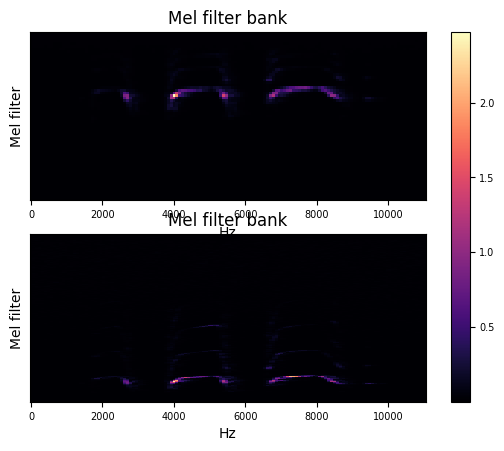

In [319]:
import matplotlib.pyplot as plt

melfb = librosa.filters.mel(sr=250000, n_fft=2048, fmin=256, n_mels=65)

stft_spec  =  np.abs(librosa.stft(emphasized_signal, n_fft=2048, hop_length = 256, win_length=1024))

fig, ax = plt.subplots(nrows=2)

img = librosa.display.specshow(melfb.dot( stft_spec), x_axis='linear', ax=ax[0])

ax[0].set(ylabel='Mel filter', title='Mel filter bank')

img = librosa.display.specshow( stft_spec, x_axis='linear', ax=ax[1])
ax[1].set(ylabel='Mel filter', title='Mel filter bank')

fig.colorbar(img, ax=ax)

In [22]:
melfb.shape

(64, 1025)

In [251]:
def stft(segment, n_fft, hop_length):
    # Compute the spectrogram using Short-Time Fourier Transform (STFT)

    stft = librosa.stft(y=segment, n_fft=n_fft, hop_length=hop_length)

    #using avgn
    #stft = _stft(segment, rate, bat_hparams)

    spec = np.abs(stft)
    return spec

In [252]:
def spectral_constrast(spectrogram, **kwargs):
    return librosa.feature.spectral_centroid(y=spectrogram, sr=250000, S=None, n_fft=2048, hop_length=512, freq=None, win_length=None, window='hann', center=True, pad_mode='constant')



In [253]:
# filter signal

from scipy.signal import butter, sosfilt

def bandpass_filter(audio_data, low_freq=440, high_freq=120000, rate=250000):
    sos = butter(4, Wn = [low_freq, high_freq], btype='bandpass', fs=rate, output='sos')
    filtered_audio = sosfilt(sos, audio_data)
    return filtered_audio
    

In [254]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt

# load the audio file
audio, sr = segment, 250000

filtered_audio = bandpass_filter(audio)

y = audio

# noise reduction
import noisereduce as nr

y = filtered_audio

y = nr.reduce_noise(y=y, sr=sr, 
                    time_constant_s= 0.2,
                    time_mask_smooth_ms = 5,
                    stationary = True,
                    freq_mask_smooth_hz = 256,
                    n_fft = n_fft,
                    hop_length = hop_length,
                    win_length = win_length,
                    n_jobs = -1
                    )





#  emphasized_signal
y = np.append(y[0], y[1:] - pre_emphasis * y[:-1])


# set the parameters for spectrogram and rolloff
#n_fft = 2048
#hop_length = 64
#win_length = 1024
#fmin = 220


In [29]:
import io
from scipy.io.wavfile import write as write_wav

bytes_wav = bytes()
wav_object = io.BytesIO(bytes_wav)
write_wav('test_wav_segment.wav', 250000, segment) # y is your numpy array


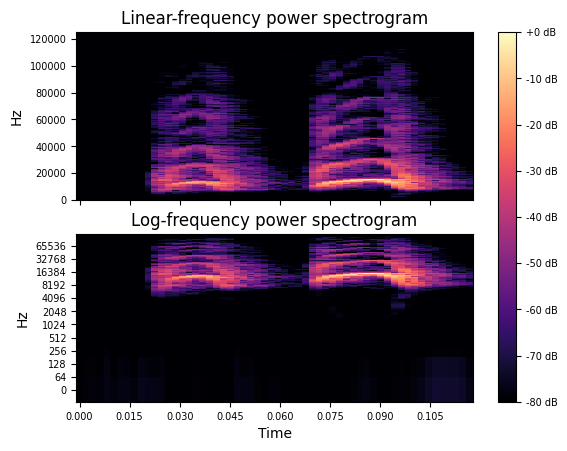

In [255]:
fig, ax = plt.subplots(nrows=2, ncols=1, sharex=True)




# Plot linear frequency

spec = np.abs(librosa.stft(y = segment, 
                           n_fft=n_fft, 
                           hop_length=hop_length, 
                           win_length=win_length))

spec_m = librosa.feature.melspectrogram(y = y, 
                           n_fft=n_fft, 
                           hop_length=hop_length, 
                           win_length=win_length)

D = librosa.amplitude_to_db(spec, ref=np.max)

img = librosa.display.specshow(D, 
                               sr=sr, 
                               y_axis='linear', 
                               x_axis='time',
                               ax=ax[0])

ax[0].set(title='Linear-frequency power spectrogram')

ax[0].label_outer()

# Plot log-frequency power
D = librosa.amplitude_to_db(spec, ref=np.max)

librosa.display.specshow(D, 
                         sr=sr, 
                         y_axis='log', 
                         x_axis='time', 
                         ax=ax[1])

# Plot roll-off

#max_rolloff = librosa.feature.spectral_rolloff(sr=sr, S=np.abs(D), n_fft=n_fft, hop_length=hop_length, win_length=win_length, window='hann', center=True, pad_mode='constant', freq=None, roll_percent=0.85)

#times = librosa.times_like(max_rolloff, sr=sr)

#ax[1].plot(times, max_rolloff[0])
ax[1].set(title='Log-frequency power spectrogram')

ax[1].label_outer()

fig.colorbar(img, ax=ax, format="%+2.f dB")

In [390]:
D.shape, max_rolloff[0].shape

((1025, 91), (91,))

In [31]:
Audio(data=filtered_audio, rate=88200)

[Text(0.5, 1.0, 'Spectrogram Centroids and Roll-off \n Denoised and Bandpass filtered and Preemphasised audio  \n')]

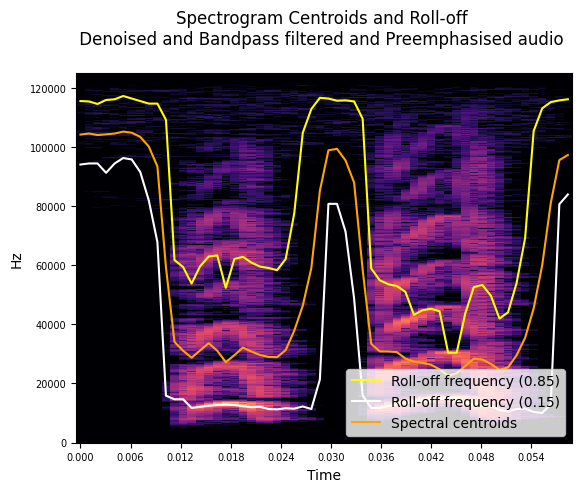

In [256]:
# shared parameters
spec_params = dict(n_fft=n_fft, hop_length=hop_length, win_length=win_length)



#S, phase = librosa.magphase(librosa.stft(filtered_audio))
#S **=2

test_segment = segment
test_segment = denoise(segment, sr)
test_segment = preemphasise(denoise(segment, sr))
test_segment = preemphasise(bandpass_filter(denoise(segment, sr)))

sftf_spec = librosa.stft(test_segment, **spec_params)

S = np.abs(sftf_spec)**1

rolloff = librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.85)

amplitude_spec = librosa.amplitude_to_db(S, ref=np.max)

rolloff_min = librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.15)

fig, ax = plt.subplots()

librosa.display.specshow(amplitude_spec,
                         sr=sr,
                         hop_length = hop_length,
                         y_axis='linear', x_axis='time', ax=ax)

times = librosa.times_like(rolloff, sr=sr, hop_length= hop_length)
ax.plot(times, rolloff[0], color='yellow', label='Roll-off frequency (0.85)')

ax.plot(times, rolloff_min[0], color='white',label='Roll-off frequency (0.15)')

ax.plot(times, librosa.feature.spectral_centroid(S=S, sr= sr, **spec_params)[0,:], color='orange', label='Spectral centroids')

ax.legend(loc='lower right')

ax.set(title=f'Spectrogram Centroids and Roll-off \n Denoised and Bandpass filtered and Preemphasised audio  \n')

In [168]:
mfcc.T.shape

(199, 20)

In [190]:
2048 / 250

8.192

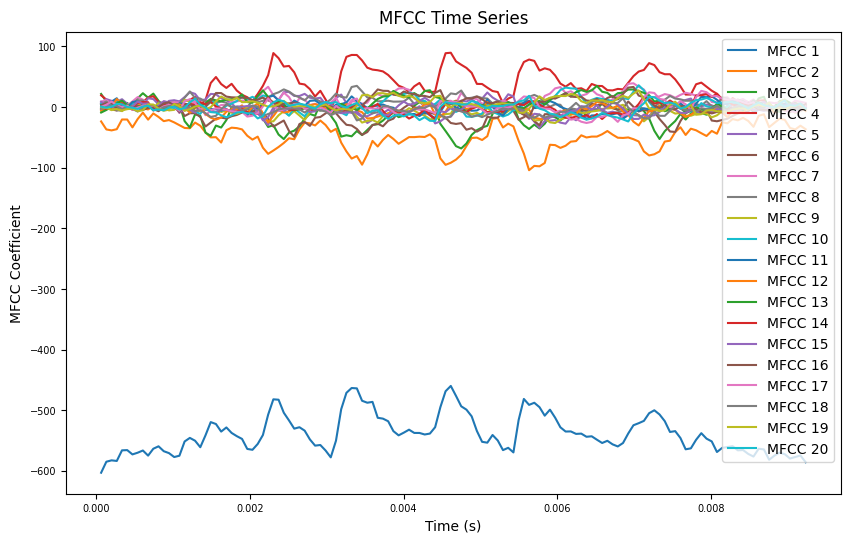

In [328]:
# plot the MFCC

mfcc = librosa.feature.mfcc(y = segment, sr=sr, n_fft = n_fft, win_length=win_length, hop_length=hop_length, n_mels=n_mels, fmax=fmax)

# Compute the time values for each frame
time = (len(segment)/sr) /(n_fft) * (1 + np.arange(len(mfcc.T)))

# Plot each MFCC coefficient as a time series
plt.figure(figsize=(10, 6))
for i in range(mfcc.T.shape[1]):  # Loop over each MFCC coefficient
    plt.plot(time, mfcc.T[:, i], label=f'MFCC {i+1}')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficient')
plt.title('MFCC Time Series')
plt.legend()
#plt.tight_layout()
plt.show()

((<Figure size 640x480 with 2 Axes>,
  array([<Axes: >, <Axes: >], dtype=object)),)

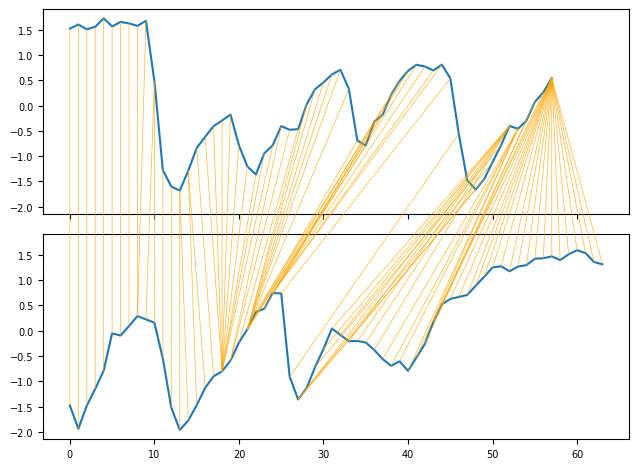

In [274]:
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np

mfcc_2 = librosa.feature.mfcc(y = segment, sr=sr, n_fft = n_fft, win_length=win_length, hop_length=hop_length, n_mels=n_mels, fmax=fmax)


s1 = mean_norm(mfcc)[2]
s2 = mean_norm(mfcc_2)[2]
path = dtw.warping_path(s1, s2)
dtwvis.plot_warping(s1, s2, path), 


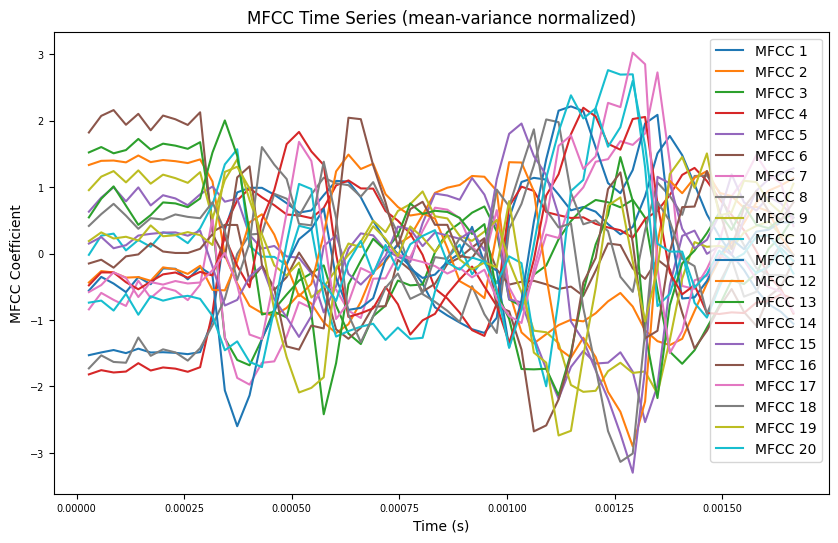

In [270]:
# Plot each MFCC coefficient as a time series
plt.figure(figsize=(10, 6))
for i in range(mean_norm(mfcc).T.shape[1]):  # Loop over each MFCC coefficient
    plt.plot(time, mean_norm(mfcc).T[:, i], label=f'MFCC {i+1}')
plt.xlabel('Time (s)')
plt.ylabel('MFCC Coefficient')
plt.title('MFCC Time Series (mean-variance normalized)')
plt.legend()
plt.show()


In [210]:
Audio(data=segment, rate=192000)

In [219]:
50000/2048

24.4140625

In [211]:
(segment.shape[0]/250000)/200

0.00101774

In [72]:
pandas.DataFrame({
        'upper': librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.85)[0, :],
        'lower': librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.15)[0, :],
        'spec_centroids' : librosa.feature.spectral_centroid(S=S, sr=sr, **spec_params)[0,:]
    }).describe()

,upper,lower,spec_centroids
count,91.000000,91.000000,91.000000
mean,19072.480254,9453.071343,14308.109487
std,11487.189582,1733.914990,5050.469703
min,12573.242188,6713.867188,10011.894065
25%,16967.773438,7995.605469,11885.544058
50%,17944.335938,9521.484375,14246.366697
75%,18676.757812,10437.011719,15503.034427
max,103393.554688,14648.437500,53996.614434


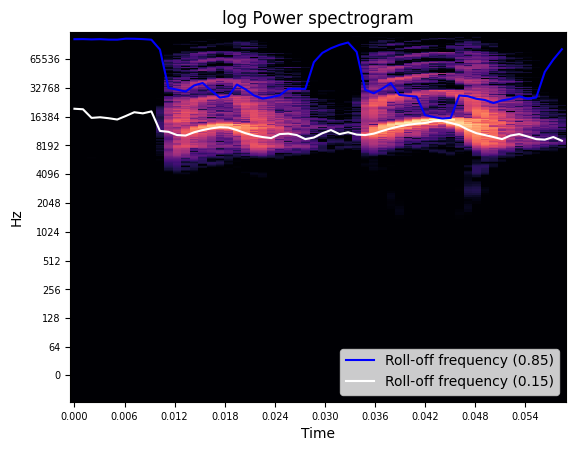

In [258]:
import librosa
import numpy as np
import pandas

from matplotlib import pyplot as plt
import librosa.display



def plot_spectral(audio, sr, hop_length=256, win_length=1024, n_fft=2048):

    # shared parameters
    spec_params = dict(n_fft=n_fft, hop_length=hop_length, win_length=win_length)

    # compute
    sftf_spec = librosa.stft(audio, **spec_params)
    S = np.abs(sftf_spec)
    amplitude_spec = librosa.amplitude_to_db(S, ref=np.max)

    up = librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.85)
    
    rolloff = pandas.DataFrame({
        'upper': librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.85)[0, :],
        'lower': librosa.feature.spectral_rolloff(S=S, sr=sr, **spec_params, roll_percent=0.15)[0, :],
    })
    rolloff['time'] = librosa.times_like(rolloff['lower'], sr=sr, hop_length=hop_length)

    fig, ax = plt.subplots()

    librosa.display.specshow(amplitude_spec, sr=sr, **spec_params,
                             y_axis='log', x_axis='time', ax=ax, )

    ax.plot(rolloff['time'], rolloff['upper'], color='blue', label='Roll-off frequency (0.85)')

    ax.plot(rolloff['time'], rolloff['lower'], color='white', label='Roll-off frequency (0.15)')

    ax.legend(loc='lower right')

    ax.set(title='log Power spectrogram')

    fig.savefig('spectral-rolloffs.png')


def load_data():
    p = 'test_wav_segment.wav'
    audio, sr = librosa.load(p, sr=None)
    return audio, sr

audio, sr = load_data()


plot_spectral(filtered_audio, sr=sr)

In [351]:
times.shape

(91,)

In [327]:
D

array([[-80.        , -79.59763072, -76.05107243, ..., -80.        ,
        -79.6039218 , -75.20384598],
       [-79.5161016 , -76.22698195, -74.13197216, ..., -75.34492621,
        -73.36635581, -72.33597412],
       [-74.59007295, -72.82007274, -71.49759249, ..., -69.44166033,
        -69.05351578, -69.38771918],
       ...,
       [-80.        , -80.        , -80.        , ..., -80.        ,
        -80.        , -80.        ],
       [-80.        , -80.        , -80.        , ..., -80.        ,
        -80.        , -80.        ],
       [-80.        , -80.        , -80.        , ..., -80.        ,
        -80.        , -80.        ]])

In [307]:
x = librosa.feature.melspectrogram(y=x, sr=250000, n_mels=64, fmax=120000)
y = librosa.feature.melspectrogram(y=y, sr=250000, n_mels=64, fmax=120000)
z = librosa.feature.melspectrogram(y=z, sr=250000, n_mels=64, fmax=120000)#

NameError: name 'x' is not defined

In [ ]:
512/250000*1000

In [ ]:
D, wp = librosa.sequence.dtw(x, x)

NameError: name 'D' is not defined

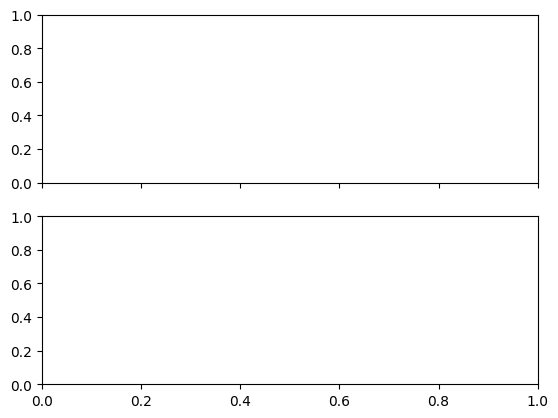

In [13]:
fig, ax = plt.subplots(nrows=2, sharex=True)

img = librosa.display.specshow(D, x_axis='frames', y_axis='frames',

                               ax=ax[0])

ax[0].set(title='DTW cost', xlabel='Noisy sequence', ylabel='Target')

ax[0].plot(wp[:, 1], wp[:, 0], label='Optimal path', color='y')

ax[0].legend()

fig.colorbar(img, ax=ax[0])

ax[1].plot(D[-1, :] / wp.shape[0])

ax[1].set(xlim=[0, x.shape[1]], 

          title='Matching cost function')

#### Single call similiarity between syllables (MFCC)

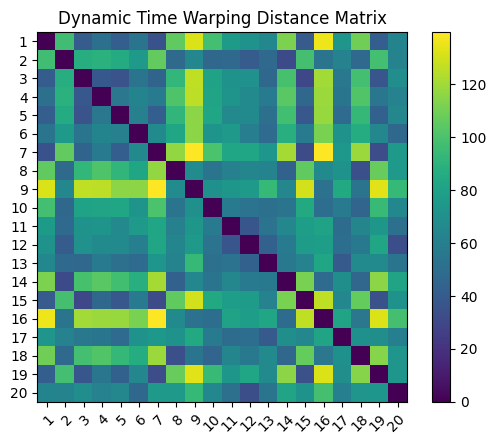

In [26]:
import librosa
from sklearn.metrics.pairwise import pairwise_distances
from scipy.special import softmax


# Load audio file
#audio_file = "example_audio.wav"
#y, sr = librosa.load(audio_file)
y = data
sr = 250000

# Define segment length and hop size
seg_len = 3  # segment length in seconds
hop_size = 1  # hop size in seconds

# Extract MFCCs for each segment
mfccs = []

l = list(zip(zip(start_times, end_times), zip(end_times,start_times[1:])))
segments = [item for sublist in l for item in sublist]

#for start, end in zip(start_times, end_times):
for segment in segments:
    #start, end = int(start), int(end)
    start, end = int(segment[0]), int(segment[1])
    mfcc = librosa.feature.mfcc(y = y[start:end], sr=sr, n_fft = 4096, win_length=1024, hop_length=256, n_mels=64, fmax=120000)
    mfccs.append(mfcc)


# Calculate dynamic time warping distances
#distances = pairwise_distances(mfccs, metric='euclidean')
distances = []
for x in mfccs:
    for y in mfccs:
        D, wp = librosa.sequence.dtw(x, y)
        distances.append(D[wp[-1, 0], wp[-1, 1]])

# normalize
distances = np.array(distances)
distances_norm = (distances-np.min(distances))/(np.max(distances)-np.min(distances))
        
# corr_matrix
n = int(np.sqrt(len(distances)))
distances = distances.reshape(n,n)

#distances = softmax(distances)

# Plot correlation matrix
import matplotlib.pyplot as plt
import numpy as np

fig, ax = plt.subplots()
im = ax.imshow(distances)

# Set axis labels and ticks
ax.set_xticks(np.arange(len(mfccs)))
ax.set_yticks(np.arange(len(mfccs)))
ax.set_xticklabels(np.arange(1, len(mfccs)+1))
ax.set_yticklabels(np.arange(1, len(mfccs)+1))

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Set colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Show plot
plt.title('Dynamic Time Warping Distance Matrix')
plt.show()

In [27]:
from sklearn.preprocessing import normalize

#normalize matrix by columns
#distances_normed = normalize(distances, axis=1, norm='l1')
distances_normed = np.linalg.norm(distances, axis = 0, keepdims=True)
distances_normed[0];

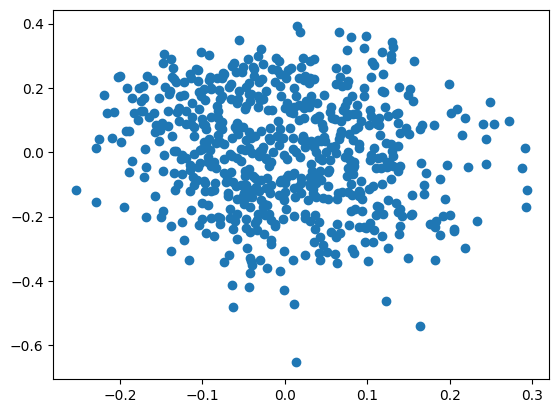

In [15]:
import numpy as np
from sklearn.manifold import MDS
import matplotlib.pyplot as plt

# Use MDS to find a 2D representation of the distances
mds = MDS(n_components=2, dissimilarity='precomputed',  normalized_stress='auto')
pos = mds.fit_transform(distances)

# Plot the points in 2D
plt.scatter(pos[:, 0], pos[:, 1])
plt.show()

In [29]:
# Determine the length of the longest MFCC
max_len = max(len(mfcc[0]) for mfcc in mfccs)

# Initialize array for padded/truncated MFCCs
mfccs_fixed = np.zeros((len(mfccs), 20, max_len))

# Pad or truncate MFCCs to fixed length
for i, mfcc in enumerate(mfccs):
    if mfcc.shape[1] < max_len:
        # Pad MFCC with zeros
        mfccs_fixed[i, :, :mfcc.shape[1]] = mfcc
    #else:
    #    # Truncate MFCC
    #    mfccs_fixed[i, :, :] = mfcc[:, :max_len]

In [30]:
import umap
import umap.plot
from sklearn.cluster import KMeans

# Convert mfccs to a 2D array
mfccs_flat = [mfcc.flatten() for mfcc in mfccs_fixed]

# Dimensionality reduction with UMAP
reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, random_state=42, metric='euclidean')

# embedding
embedding = reducer.fit_transform(mfccs_flat)

2023-03-28 10:09:03.111893: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-28 10:09:03.985172: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-03-28 10:09:03.985263: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2023-03-28 10:09:03.985273: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nv

In [31]:
#mapper = reducer.fit(mfccs_flat);
#umap.plot.points(mapper);

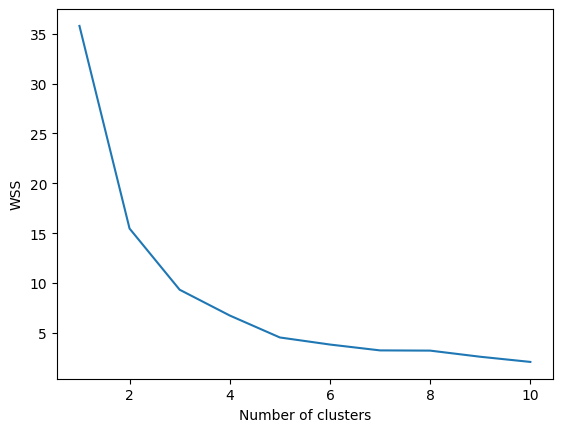

In [32]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min

# Compute WSS for different values of k
wss = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto').fit(embedding)
    wss.append(kmeans.inertia_)

# Plot WSS vs. number of clusters
plt.plot(range(1, 11), wss)
plt.xlabel('Number of clusters')
plt.ylabel('WSS')
plt.show()

In [33]:
# Clusterization with K-means
kmeans = KMeans(n_clusters=3, random_state=0, n_init ='auto').fit(embedding)

# Count number of clusters
num_clusters = len(set(kmeans.labels_))

print("Number of clusters:", num_clusters)

Number of clusters: 3


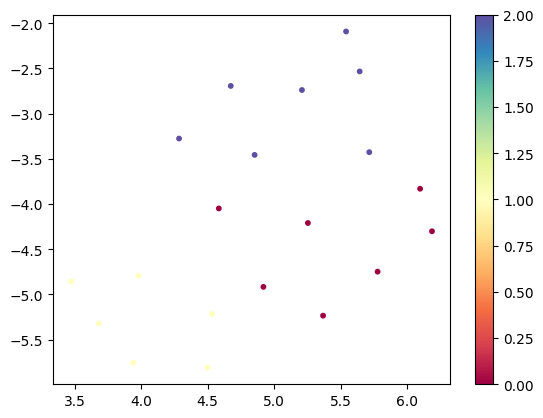

In [34]:
import matplotlib.pyplot as plt

# Plot UMAP embeddings
plt.scatter(embedding[:, 0], embedding[:, 1], c=kmeans.labels_, cmap='Spectral', s=10)
plt.colorbar()
plt.show()

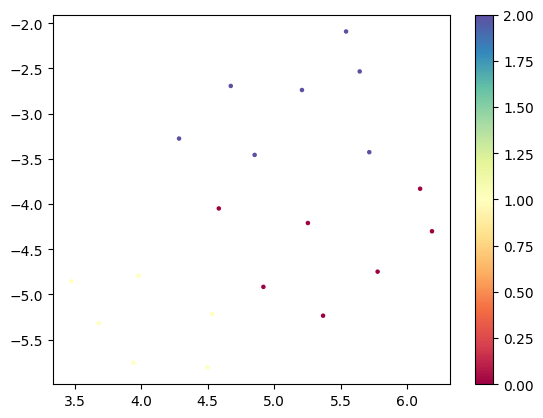

In [35]:
# Plot UMAP embeddings
plt.scatter(embedding[:, 0], embedding[:, 1], c=kmeans.labels_, cmap='Spectral', s=5)
plt.colorbar()
plt.show()

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage


In [38]:
dbscan = DBSCAN(eps=.5, min_samples=2).fit(embedding)

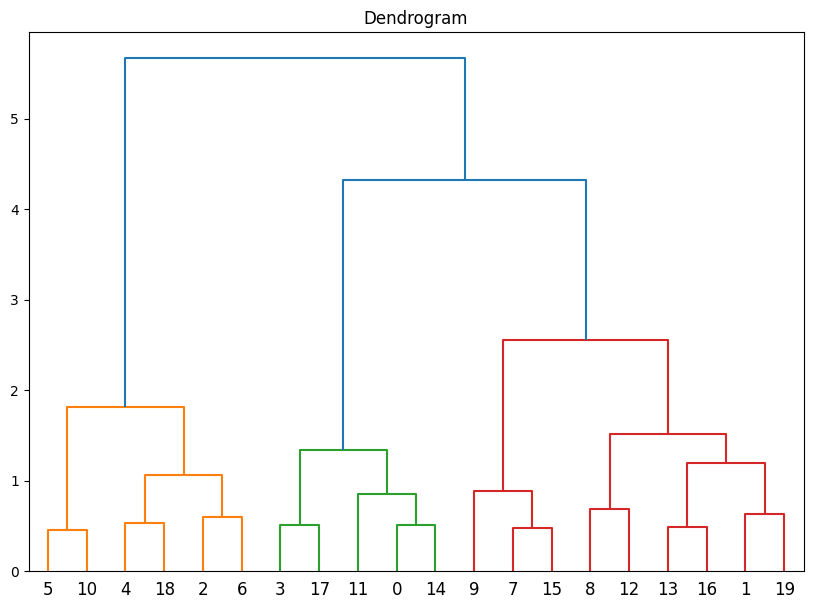

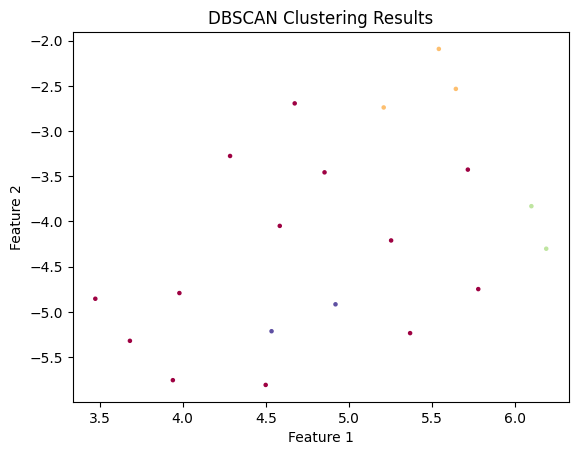

In [121]:
# Create dendrogram using hierarchical clustering
Z = linkage(embedding, method='ward')
plt.figure(figsize=(10, 7))
plt.title("Dendrogram")
dendrogram(Z)
plt.show()

# Plot DBSCAN results
plt.scatter(embedding[:, 0], embedding[:, 1], c=dbscan.labels_, cmap='Spectral', s=5)
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.title("DBSCAN Clustering Results")
plt.show()

In [40]:
i, k = 8, 15
Audio(data = data[int(segments[i][0]):int(segments[i][1])], rate = 88200)

In [41]:
Audio(data = data[int(segments[k][0]):int(segments[k][1])], rate = 88200)

## Feature Extraction in all calls (MFCC)

In [94]:
#sample_files = get_sample_files(q.set_index('Emitter').loc[215])
#sample_files

get_sample_files(q).head()

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
0,64293,10,121006184615763209.WAV,files202,1,2012-10-06 18:56:12,47285.0,88079.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,65200,10,121007110303184871.WAV,files202,1,2012-10-07 11:13:04,35209.0,84955.0,163709.0,221455.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,65201,10,121007110315535872.WAV,files202,1,2012-10-07 11:13:17,42737.0,88483.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,65355,10,121007191924280097.WAV,files202,1,2012-10-07 19:29:23,42793.0,65634.0,110351.0,155465.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,69301,10,121011105149610802.WAV,files202,1,2012-10-11 11:05:22,28193.0,83517.0,264771.0,318017.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [22]:
def get_label_classes(sample_files, Category):
    """
    Associate a label Class to each segment
    """
    classes = []

    if file_info.index.name != 'FileID':
        file_info.set_index('FileID', inplace=True) 

    sample_filesIDs = sample_files['FileID'].to_list()
    filenames = file_info.loc[sample_filesIDs]['File name'].values

    for name in filenames:
        #print(name)
        rate, data, start_times, end_times = get_wav_info(name)    

        classes.extend( get_segment_classes(name, start_times, end_times, [Category] ))
    
    return classes
    
#labels_Addressee = get_label_classes(sample_files, 'Addressee')

In [ ]:
q[q.Emitter == 111]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
14356,61210,111,228,11,3,2,3,3,1.0,426832.0
14650,61699,111,226,12,2,2,3,3,1.0,525136.0
14739,61814,111,213,11,3,2,3,3,1.0,557904.0
14743,61835,111,213,12,3,2,2,3,1.0,328528.0
14845,62005,111,228,11,2,2,3,2,1.0,574288.0
...,...,...,...,...,...,...,...,...,...,...
37701,146024,111,228,3,2,2,3,3,1.0,369488.0
37716,146115,111,213,3,2,2,3,3,1.0,1139536.0
37724,146138,111,226,11,2,2,4,3,1.0,754512.0
37739,146165,111,213,3,2,2,2,3,1.0,336720.0


In [259]:
%%time

emitter = 213

def compute_segment_props_by_emitter(emitter, query, preprocess=True, test = False):
    
    
    # Helper function to get file info
    
    def get_file_info(row):

        fileID = row.loc['FileID']
        origin = file_info.set_index('FileID').loc[fileID].copy()
        filename = origin.loc['File name']
        folder = origin.loc['File folder']
        
        return fileID, folder, filename
    
    # Helper function to filter utterances actually said by the Emitter 
    def is_said_by_emitter(start_seg, end_seg):
        
        # return the observed context for each utterance
        
        isSaid, observed_context, observed_addressee  = False, None, None
        
        selected_row = sample_files.query(f"(`Emitter` == {emitter}) & (`FileID` == {fileID}) & (`Start sample` <= {start_seg}) & (`End sample` >= {end_seg}) ")        
        
        if selected_row.shape[0] < 1:
            return isSaid, observed_context, observed_addressee
        
        else:
            isSaid = True
            observed_context = selected_row.T.loc['Context'].astype(int).iloc[0]
            observed_addressee = selected_row.T.loc['Addressee'].astype(int).iloc[0]
            
            return isSaid, observed_context, observed_addressee
    
    
    # if test, process only 2 files, else All
    num = 2 if test else -1

    # get all annotations for the Emitter
    # ann_emitter = annotations[annotations['Emitter'] == emitter]


    # labels  
    label_addressee = []
    label_context = []
    
    # segments_audio
    voc_segments = []

    # segments_indexes
    voc_segments_ix = []

    #duration segments
    voc_segments_duration = []

    # total_mfccs
    mfccs = []

    # total mel_filtered
    mel_filtered = []

    # spectrograms
    specs = []
    
    # bandwidth
    bandwidths = []
    
    # rolloff max
    rolloff_max = []
    
    # rolloff min
    rolloff_min = []
    
    # spectral centroids
    spec_centroids = []
    
    # spectral centroids stats
    spec_centroids_stats = []
    
    # fundamental notes
    f0 = []
    
    # spectral contrast
    spec_contrasts = []
    
    # spectral flatness = []
    flatness = []
    
    # temporal stats 
    temporal_stats = []

    
    sample_files = query[query['Emitter'] == emitter].copy()
    sample_files.reset_index(inplace=True)
    
    for i, row in sample_files.iterrows():
        
        # for debug
        if i == num:
            break
        
        # get file info
        fileID, folder, filename = get_file_info(row)
    
        # preprocess file
        if preprocess:      
            sr, y, start_times, end_times = preprocess_wavefile(filename)
        else:
            sr, y, start_times, end_times = get_wav_info(filename)
    
        # get segments 
        segments, durations = get_segment_list(start_times, end_times)
        
        # get props for each segment
        for k, segment in enumerate(segments):
            
            start_seg = int(segment[0])
            end_seg = int(segment[1])
            
            # filter segments actually said by Emitter, discard otherwise
            isSaid, observed_context, observed_addressee = is_said_by_emitter(start_seg, end_seg)
            
            if isSaid == False:
                continue
            
            # segment, segment ix, duration, and labels
            segment  = y[start_seg : end_seg]
            segment_ix = (fileID, folder, filename, k, start_seg, end_seg)
            segment_duration = end_seg - start_seg
            
            # label 
            label_context.append( observed_context )
            label_addressee.append(  observed_addressee )
            
            # vocs
            voc_segments.append ( segment)
            voc_segments_ix.append( segment_ix )
            voc_segments_duration.append ( segment_duration )

            # spectrogram
            s = librosa.stft(segment, n_fft = n_fft, win_length=win_length, hop_length=hop_length)
            s = np.abs(s)
            specs.append( s )

            # mfcc
            mfcc = librosa.feature.mfcc(y = segment, sr=sr, n_fft = n_fft, win_length=win_length, hop_length=hop_length, n_mels=n_mels, fmax=fmax)
            mfccs.append(mfcc)
            
            # spectral properties
            spec_contrasts.append(spectral_constrast(s))
            spec_centroids.append(spectral_centroids(s))
            spec_centroids_stats.append(spectral_centroid_descriptive(s))
            
            rolloff_max.append(spectral_rolloff(s, roll_percent=0.85))
            rolloff_min.append(spectral_rolloff(s, roll_percent=0.15))
            bandwidths.append(spectral_bandwidth(s))
            
            flatness.append( spectral_flatness(s))
            
            # temporal properties
            temporal_stats.append(temporal_centroid_descriptive(s))
            
            # mel filter banks
            melfb = librosa.filters.mel(sr=sr, n_fft=n_fft, fmin=fmin, n_mels=n_mels)
            mel = melfb.dot(s)
            mel_filtered.append( mel) 
            
            # fundamental note
            f0.append(fundamental_note(segment))
            
    
    del sample_files
    
    props  = {
        
        # segments_audio
        'voc_segments' : voc_segments,

        # segments_indexes
        'voc_segments_ix' : voc_segments_ix,

        #duration segments
        'voc_segments_duration' : voc_segments_duration,
        
        #emitter
        'emitter' : emitter,

        # total_mfccs
        'mfccs' : mfccs,

        # total mel_filtered
        'mel_filtered' : mel_filtered,

        # spectrograms
        'specs' : specs,
        
        # bandwidths
        'bandwidths' : bandwidths,
        
        # rolloffs
        'rolloff_max' : rolloff_max,
        'rolloff_min' : rolloff_min,
        
        # centroids
        'spec_centroids' : spec_centroids,
        'spec_centroids_stats' : spec_centroids_stats,
        
        # contrast
        'spec_contrasts' : spec_contrasts,
        
        # f0
        'f0' : f0,
        
        # flatness 
        'flatness' : flatness,
        
        # temporal stats
        'temporal_stats' : temporal_stats,

        # labels vocs
        'label_context' : label_context,
        'label_addressee' : label_addressee

    }
    
    return props
    

# test
#tmp = compute_segment_props_by_emitter(216, q, preprocess = True, test=True)
#tmp = compute_segment_props_by_emitter(207, q[q.FileID == 63549], preprocess=True, test = True)
tmp = compute_segment_props_by_emitter(226, q, preprocess=True, test = True)
tmp = pd.DataFrame.from_dict(tmp)
tmp.head()
                                 

CPU times: user 20.1 s, sys: 50.7 s, total: 1min 10s
Wall time: 29.2 s


,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,rolloff_min,spec_centroids,spec_centroids_stats,spec_contrasts,f0,flatness,temporal_stats,label_context,label_addressee
0,"[-1.147857e-05, 1.9681662e-05, -2.341274e-05, ...","(53520.0, files201, 121001002340125828.WAV, 0,...",24707,226,"[[-795.79956, -791.7445, -790.3716, -790.59576...","[[2.0290967e-08, 1.0173882e-08, 3.6544895e-10,...","[[3.1095765e-06, 1.5552107e-06, 3.435952e-08, ...","[[18354.627494763612, 15307.952243992131, 1484...","[[111694.3359375, 111083.984375, 110961.914062...","[[84106.4453125, 84838.8671875, 84716.796875, ...","[[96979.3919344335, 97786.06894837561, 96793.6...","(0.01390959, 0.00012256883, 0.055966955)","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.02026382, 0.003390743, 0.0013236615, 0.001...",0.000177,11,0
1,"[2.432406e-05, -1.7505012e-05, 7.856591e-06, 5...","(53560.0, files201, 121001002836480847.WAV, 0,...",50344,226,"[[-676.1372, -676.17755, -676.1813, -671.45966...","[[9.452918e-08, 4.617444e-08, 1.9764574e-09, 1...","[[1.4355601e-05, 7.1494414e-06, 5.68849e-07, 9...","[[23498.166866478914, 21372.40679115341, 31350...","[[117431.640625, 118408.203125, 124755.859375,...","[[88500.9765625, 89233.3984375, 88500.9765625,...","[[98512.91178680821, 102665.60273862524, 10341...","(0.057760153, 3.179249e-05, 0.30525136)","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.015875284, 0.0064385035, 0.0039049345, 0.0...",0.000258,10,233
2,"[9.887855e-06, -1.019189e-05, 4.9250516e-06, 3...","(53560.0, files201, 121001002836480847.WAV, 1,...",40246,226,"[[-742.4485, -741.918, -729.7463, -720.3258, -...","[[2.0035136e-08, 3.2487844e-08, 2.6654144e-08,...","[[3.2017754e-06, 2.2500828e-06, 3.9044285e-06,...","[[19603.412608870236, 23367.930323534834, 4445...","[[121215.8203125, 121215.8203125, 115844.72656...","[[98754.8828125, 99853.515625, 2197.265625, 19...","[[105245.17205086471, 104204.13180152235, 8148...","(0.026272139, 4.417972e-05, 0.11297094)","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.011311816, 0.0041032825, 0.0014525118, 0.0...",0.000389,10,233
3,"[-5.4393477e-06, 3.6264935e-06, -5.3493545e-06...","(53560.0, files201, 121001002836480847.WAV, 2,...",12912,226,"[[-797.18384, -794.59467, -794.2088, -795.5633...","[[1.00973935e-07, 4.497863e-08, 3.4685965e-10,...","[[1.4908356e-05, 6.8020827e-06, 6.2457694e-08,...","[[45589.775466710635, 48016.42277277498, 49694...","[[121582.03125, 121459.9609375, 121459.9609375...","[[4516.6015625, 2807.6171875, 2807.6171875, 28...","[[90020.48445259892, 91135.8807003486, 92165.2...","(5.8054875e-06, 2.5323095e-09, 5.8580918e-05)","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.03555892, 0.009815468, 0.0071846973, 0.011...",0.000073,10,233
4,"[-1.3075801e-06, 3.1650313e-06, -1.5963296e-06...","(53560.0, files201, 121001002836480847.WAV, 3,...",26520,226,"[[-743.3092, -743.21387, -740.3753, -738.5308,...","[[1.258805e-08, 8.048705e-09, 9.701114e-10, 3....","[[1.934091e-06, 6.9299944e-07, 1.871112e-07, 4...","[[27030.25722118412, 39008.13450790677, 46253....","[[115234.375, 114746.09375, 111694.3359375, 77...","[[75805.6640625, 3051.7578125, 2685.546875, 28...","[[85449.86194573979, 72977.3194056269, 44226.0...","(0.06483389, 0.00024052672, 0.2166612)","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.12190654, 0.05457073, 0.03103894, 0.019696...",0.000211,10,233


In [249]:
file_info[file_info.FileID == 63549]

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
63549,63549,11,121005221219635013.WAV,files202,11,2012-10-05 22:21:17,44263.0,71019.0,99273.0,136019.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [251]:
annotations[annotations.FileID == 63549]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
15666,63549,207,209,6,0,0,0,0,1.0,99272.0
15667,63549,207,209,6,0,0,0,0,168273.0,467792.0


In [161]:
tmp['voc_segments_ix'];

In [172]:
q.query(f"(`Emitter` == {216}) & (`FileID` == {74142.0})")        


,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
19779,74142,216,228,6,2,2,3,3,300787.0,746320.0


In [173]:
annotations[annotations.FileID == 74142]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
19778,74142,120,0,11,2,2,2,3,1.0,300786.0
19779,74142,216,228,6,2,2,3,3,300787.0,746320.0


In [131]:
filter_segments_by_emitter(214, '121024171740931954.WAV', annotations[annotations['Emitter'] == 214], preprocess = True)

([array([-4.4842263e-06, -3.3877892e-05,  4.7887719e-05, ...,
         -2.4802493e-06, -9.2688526e-07,  5.7385682e-06], dtype=float32)],
 [(79048, 'files203', '121024171740931954.WAV', 0, 28349, 76595)],
 [48246],
 [6],
 [213])

In [128]:
annotations[annotations.FileID == 79048]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
21001,79048,214,213,6,2,2,3,3,1.0,128532.0
21002,79048,213,233,11,2,2,3,3,128533.0,516944.0


In [129]:
file_info[file_info.FileID == 79048]

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
79048,79048,9,121024171740931954.WAV,files203,3,2012-10-24 17:48:50,28349.0,76595.0,128533.0,166095.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [125]:
t = q[q.Emitter == 214]
t[t.FileID == 79048]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
21001,79048,214,213,6,2,2,3,3,1.0,128532.0


In [288]:
q[q.Emitter == 214].head(1)

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
16562,65862,214,213,6,2,2,2,3,1.0,459600.0


In [107]:
q[q['Emitter'] == 207]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
13842,58196,207,209,6,0,0,0,0,1.0,467792.0
14169,59887,207,209,6,0,0,0,0,1.0,336720.0
14795,61901,207,209,6,0,0,0,0,1.0,475984.0
15666,63549,207,209,6,0,0,0,0,1.0,99272.0
15667,63549,207,209,6,0,0,0,0,168273.0,467792.0
...,...,...,...,...,...,...,...,...,...,...
32981,128815,207,209,6,0,0,0,0,1.0,320336.0
34694,134260,207,209,6,0,0,0,0,1.0,566096.0
35603,136001,207,209,6,0,0,0,0,1.0,320336.0
35921,137447,207,209,6,0,0,0,0,1.0,336720.0


In [111]:

%%time

"""
Old way

import pickle

def process_segments_from_query(q):

    # compute the segments specs and props
    n_jobs = 32

    for Emitter in q.set_index('Emitter').index.unique():

        sample_files = get_sample_files(q.set_index('Emitter').loc[Emitter])

        with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
            props = parallel(
                delayed(compute_segments_props)(
                    sample_files.loc[ix].to_frame().T
                    #chunk
                )
                for ix in tqdm(range(len(sample_files)))
                #for chunk in tqdm(np.array_split(sample_files, 2))
            )

        with open(f'pup_to_mother_emitter_{Emitter}.pkl','wb') as f:
            pickle.dump(props, f, protocol=pickle.HIGHEST_PROTOCOL)
            
process_segments_from_query(q)

"""
print()


CPU times: user 63 µs, sys: 43 µs, total: 106 µs
Wall time: 108 µs


In [41]:
q.head()

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
12717,55830,201,218,11,2,3,3,4,1.0,1434448.0
12723,55850,201,218,11,2,2,3,3,1.0,385872.0
12724,55852,201,218,11,2,2,3,3,1.0,336720.0
12834,56095,223,218,11,2,2,3,3,1.0,394064.0
12920,56222,223,218,11,2,2,3,3,1.0,402256.0


In [260]:
q.set_index('Emitter').index.unique()

Int64Index([226], dtype='int64', name='Emitter')

In [261]:
%%time

import pickle

# compute the segments specs and props and parallelize work


def process_segments_from_query(query):

    # compute the segments specs and props
    n_jobs = 32
    
    for emitter in query.set_index('Emitter').index.unique():
    #for emitter in [214]:
        
        sample_files = query[query.Emitter == emitter].copy()
        
        # avoid NaN results if num sample_files < array_split's chunks
        num_chunks = min(len(sample_files), 10)

        with Parallel(n_jobs=n_jobs, verbose=verbosity) as parallel:
            props = parallel(
                delayed(compute_segment_props_by_emitter)(
                    emitter, files_chunk, preprocess=True, test=False
                )
                for files_chunk in tqdm(np.array_split(sample_files, num_chunks))
            )
            
        del sample_files

        with open(f'bat_{emitter}.pkl','wb') as f:
            pickle.dump(props, f, protocol=pickle.HIGHEST_PROTOCOL)
            
process_segments_from_query(q)

  0%|          | 0/10 [00:00<?, ?it/s]

[Parallel(n_jobs=32)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=32)]: Done   2 out of  10 | elapsed: 115.2min remaining: 460.9min


PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis


[Parallel(n_jobs=32)]: Done  10 out of  10 | elapsed: 144.0min finished


CPU times: user 11.9 s, sys: 37.9 s, total: 49.8 s
Wall time: 2h 24min 14s
PROJECT_DIR set on:  /data0/home/h21/luas6629/Thesis


## Unsupervised clustering and labelling of syllables

In [200]:
from pandas import json_normalize
import pickle

def import_segments_df(Emitter, filename_type = 'pup_to_mother'):
    with open(f'{filename_type}_{Emitter}.pkl','rb') as f:
        df = pickle.load(f)

    df = pd.DataFrame.from_dict(json_normalize(df)).apply(pd.Series.explode).reset_index()
    df.rename(columns={"index": "commonSourceID"}, inplace=True)
    
    
    # drop duplicates because some files have multiple annotations, and get all props for each annotation - Example:
    # annotations[annotations['FileID'] == 63549]
    #df.drop_duplicates(subset=["voc_segments_ix"], keep="first", inplace=True)
    
    df.reset_index(drop=True, inplace=True)
    df.dropna(inplace=True)
    
    # expand tuples
    tmp = df['voc_segments_ix'].apply(pd.Series)
    tmp.columns = ['FileID', 'Folder', 'File name', 'Pos_segment', 'Start_seg', 'End_seg']
    tmp.reset_index(drop=True, inplace=True)
    
    df = pd.concat([df, tmp], axis=1)
    
    df.index.set_names('segmentID', inplace=True)
    df['Emitter'] = Emitter
    
    return df

def import_segments_df_All(Emitters, filename_type = 'pup_to_mother', dropDuplicates = True, new=False):
 
    def make_db():
        df = pd.concat([import_segments_df(Emitter, filname_type) for Emitter in Emitters])
        #df.drop_duplicates(subset=["voc_segments_ix"], keep="first", inplace=True)
        df.reset_index(drop=True, inplace=True)
        
        if dropDuplicates:
            df.drop_duplicates(subset=["voc_segments_ix"], keep="first", inplace=True)
            df.index = range(len(df.index))
            
        df.index.set_names('segmentID', inplace=True)
        return df

    def load_db():
        with open(f'{filname_type}_All.pkl','rb') as f:
            df = pickle.load(f)
            df.reset_index(drop=True, inplace=True)
            df.index.set_names('segmentID', inplace=True)
            return df 
    
    def save_db(df):
        with open(f'{filname_type}_All.pkl','wb') as f:
            pickle.dump(df, f, protocol=pickle.HIGHEST_PROTOCOL)
            print(f'{filname}.pkl is saved on disk')
    
    if (new):
        df = make_db()
        save_db(df)
        return df
    else:
        try:
            return load_db()
        except FileNotFoundError:
            print('Db not existing. Creating db')
            df = make_db()
            save_db(df)
            return df

In [132]:
from pandas import json_normalize

with open(f'bat_{218}_All.pkl','rb') as f:
    selected_bat = pickle.load(f)
    selected_bat = pd.concat([pd.DataFrame.from_dict( json_normalize(df)).apply(pd.Series.explode).reset_index() for df in selected_bat])
    selected_bat.rename(columns={"index": "commonSourceID"}, inplace=True)
    selected_bat.reset_index(drop=True, inplace=True)
    selected_bat.dropna(inplace=True)
    
    tmp = selected_bat['voc_segments_ix'].apply(pd.Series)
    tmp.columns = ['FileID', 'Folder', 'File name', 'Pos_segment', 'Start_seg', 'End_seg']
    tmp.reset_index(drop=True, inplace=True)
    
    selected_bat = pd.concat([selected_bat, tmp], axis=1)
    selected_bat.reset_index(drop=True, inplace=True)
    selected_bat.drop_duplicates(subset=["voc_segments_ix"], keep="first", inplace=True)
    selected_bat.index = range(len(selected_bat.index))
    selected_bat.index.set_names('segmentID', inplace=True)

FileNotFoundError: [Errno 2] No such file or directory: 'bat_218_All.pkl'

In [202]:
selected_bat.head(1)

,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,...,flatness,temporal_stats,label_context,label_addressee,FileID,Folder,File name,Pos_segment,Start_seg,End_seg
segmentID,,,,,,,,,,,,,,,,,,,,,
0,0,"[-4.5978113e-06, -1.1713078e-05, 2.1722357e-05...","(58026.0, files201, 121002204906205401.WAV, 1,...",40070,216,"[[-796.04626, -795.5614, -797.3598, -796.70374...","[[4.5332804e-08, 2.8246706e-08, 1.1114234e-08,...","[[5.78626e-06, 1.4697524e-06, 6.352835e-07, 1....","[[23741.60669714805, 22925.906494755698, 25272...","[[112670.8984375, 112548.828125, 112426.757812...",...,"[[0.03741436, 0.017990038, 0.014357498, 0.0172...",0.00029,6,0,58026.0,files201,121002204906205401.WAV,1,280345,320415


In [111]:
selected_bat.shape

(9885, 25)

In [ ]:
# test
for emitter in q.Emitter.unique():
    print(emitter, import_segments_df(emitter, 'wild_to_wild').shape, test_segment_numbers(q[q.Emitter == emitter]))

In [18]:
%%time

q = annotations.query(f'Emitter in {pups} and Addressee in {mothers} and Context not in [0] ')
pup2mother_All = import_segments_df_All(q.Emitter.unique(), 'pup_to_mother', dropDuplicates=True, new=False)

q = annotations.query(f'Emitter in {mothers} and Addressee in {pups} and Context not in [0] ')
mother2pup_All = import_segments_df_All(q.Emitter.unique(), 'mother_to_pup', dropDuplicates=True, new=False)

CPU times: user 421 ms, sys: 927 ms, total: 1.35 s
Wall time: 1.34 s


In [35]:
pup2mother_All.shape, pup2mother_All.drop_duplicates(subset=["voc_segments_ix"], keep="first").shape

((3129, 26), (3129, 26))

In [36]:
mother2pup_All.shape, mother2pup_All.drop_duplicates(subset=["voc_segments_ix"], keep="first").shape

((406, 26), (406, 26))

In [120]:
q = annotations.query(f'Emitter in {wild_bats} and Addressee in {wild_bats} and Context not in [0] ')
wildbats_all = import_segments_df_All(q.Emitter.unique(), 'wild_to_wild', dropDuplicates=True, new=False)
wildbats_all.shape, wildbats_all.drop_duplicates(subset=["voc_segments_ix"], keep="first").shape

Db not existing. Creating db
wild_to_wild_All.pkl is saved on disk


((2932, 26), (2932, 26))

### Test duplicates and correct labeling 

In [248]:
import collections

collections.Counter(pup2mother_All["voc_segments_ix"].values).most_common()[:10]


[((87179.0, 'files204', '121103045057225251.WAV', 0, 1, 14957), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 1, 52070, 102957), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 2, 129351, 154044), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 3, 178631, 193332), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 4, 207141, 223457), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 5, 321546, 334190), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 6, 380586, 419457), 4),
 ((87179.0, 'files204', '121103045057225251.WAV', 7, 608211, 649957), 4),
 ((93523.0, 'files205', '121109050652567940.WAV', 0, 42825, 88071), 3),
 ((93523.0, 'files205', '121109050652567940.WAV', 1, 160325, 201753), 3)]

In [35]:
q[q.FileID == 87179]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
22988,87179,216,228,11,3,2,2,3,1.0,52069.0
22989,87179,216,228,6,3,2,2,3,52070.0,129350.0
22990,87179,216,228,11,3,2,2,3,129351.0,178630.0
22991,87179,216,228,6,3,2,2,3,178631.0,697168.0


In [36]:
file_info[file_info['File name'] == '121103045057225251.WAV']

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
87179,87179,9,121103045057225251.WAV,files204,3,2012-11-03 05:10:08,1.0,14957.0,52070.0,102957.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [42]:
pup2mother_All[pup2mother_All["voc_segments_ix"] == (87179, 'files204', '121103045057225251.WAV', 1, 52070, 102957)]

,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,rolloff_min,spec_centroids,spec_centroids_stats,spec_contrasts,f0,flatness,temporal_stats,label_context,label_addressee,Emitter
segmentID,,,,,,,,,,,,,,,,,,,,
2203,1,"[-5.559923e-07, -2.4719575e-05, -7.22085e-05, ...","(87179.0, files204, 121103045057225251.WAV, 1,...",50887,216,"[[-724.682, -716.88544, -717.5336, -722.44336,...","[[5.450115e-07, 2.730825e-07, 5.845924e-11, 3....","[[8.318648e-05, 4.1688752e-05, 6.2046346e-09, ...","[[20573.291071307725, 18224.582111782114, 2150...","[[40039.0625, 40161.1328125, 40893.5546875, 51...","[[23071.2890625, 23437.5, 24536.1328125, 24780...","[[31727.729504287818, 32358.69684890094, 38290...","(0.0072462955, 6.1046067e-06, 0.069821134)","[[0.0, 0.0, 3.6677070312683355, 0.0, 16.336898...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.00046151842, 8.187716e-05, 2.7711822e-05, ...",0.000362,6,228,216
2211,1,"[-5.559923e-07, -2.4719575e-05, -7.22085e-05, ...","(87179.0, files204, 121103045057225251.WAV, 1,...",50887,216,"[[-724.682, -716.88544, -717.5336, -722.44336,...","[[5.450115e-07, 2.730825e-07, 5.845924e-11, 3....","[[8.318648e-05, 4.1688752e-05, 6.2046346e-09, ...","[[20573.291071307725, 18224.582111782114, 2150...","[[40039.0625, 40161.1328125, 40893.5546875, 51...","[[23071.2890625, 23437.5, 24536.1328125, 24780...","[[31727.729504287818, 32358.69684890094, 38290...","(0.0072462955, 6.1046067e-06, 0.069821134)","[[0.0, 0.0, 3.6677070312683355, 0.0, 16.336898...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.00046151842, 8.187716e-05, 2.7711822e-05, ...",0.000362,6,228,216
2219,1,"[-5.559923e-07, -2.4719575e-05, -7.22085e-05, ...","(87179.0, files204, 121103045057225251.WAV, 1,...",50887,216,"[[-724.682, -716.88544, -717.5336, -722.44336,...","[[5.450115e-07, 2.730825e-07, 5.845924e-11, 3....","[[8.318648e-05, 4.1688752e-05, 6.2046346e-09, ...","[[20573.291071307725, 18224.582111782114, 2150...","[[40039.0625, 40161.1328125, 40893.5546875, 51...","[[23071.2890625, 23437.5, 24536.1328125, 24780...","[[31727.729504287818, 32358.69684890094, 38290...","(0.0072462955, 6.1046067e-06, 0.069821134)","[[0.0, 0.0, 3.6677070312683355, 0.0, 16.336898...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.00046151842, 8.187716e-05, 2.7711822e-05, ...",0.000362,6,228,216
2227,1,"[-5.559923e-07, -2.4719575e-05, -7.22085e-05, ...","(87179.0, files204, 121103045057225251.WAV, 1,...",50887,216,"[[-724.682, -716.88544, -717.5336, -722.44336,...","[[5.450115e-07, 2.730825e-07, 5.845924e-11, 3....","[[8.318648e-05, 4.1688752e-05, 6.2046346e-09, ...","[[20573.291071307725, 18224.582111782114, 2150...","[[40039.0625, 40161.1328125, 40893.5546875, 51...","[[23071.2890625, 23437.5, 24536.1328125, 24780...","[[31727.729504287818, 32358.69684890094, 38290...","(0.0072462955, 6.1046067e-06, 0.069821134)","[[0.0, 0.0, 3.6677070312683355, 0.0, 16.336898...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[[0.00046151842, 8.187716e-05, 2.7711822e-05, ...",0.000362,6,228,216


In [306]:
get_wav_info('121015175016075290.WAV')

(250000,
 array([-1.5258789e-04,  3.9672852e-04,  1.5258789e-04, ...,
        -3.0517578e-05, -9.1552734e-05,  3.0517578e-05], dtype=float32),
 array([48629.0, 314854.0, 360637.0, 409245.0, 485981.0, 744452.0,
        789799.0, 828691.0, 906146.0, 991168.0, 1046896.0, 1093858.0,
        1140721.0, 1184339.0, 1275183.0, 1349793.0, 1386034.0, 1618639.0,
        1876301.0], dtype=object),
 array([61112.0, 343545.0, 383894.0, 421571.0, 506677.0, 776305.0,
        808219.0, 843409.0, 930248.0, 1030163.0, 1074248.0, 1123446.0,
        1165545.0, 1196104.0, 1303220.0, 1369973.0, 1414264.0, 1647915.0,
        1888695.0], dtype=object))

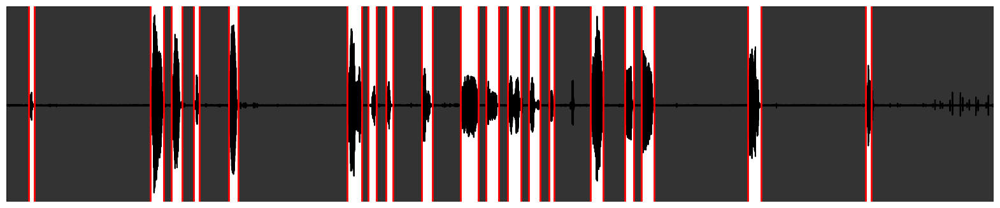

In [307]:
plot_and_play_wav('121015175016075290.WAV')

In [305]:
# this file is annotated twice, but have different emitters :(
file_info[file_info['File name'] == '121015175016075290.WAV']

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
72807,72807,9,121015175016075290.WAV,files202,4,2012-10-15 18:11:06,48629.0,61112.0,314854.0,343545.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [308]:
annotations[annotations['FileID'] == 72807]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
19100,72807,-213,-233,11,2,0,4,3,1.0,1618638.0
19101,72807,111,228,11,2,2,2,3,1618639.0,2155344.0


### Prune duplicates And continue

In [48]:
pup2mother_All.drop_duplicates(subset=["voc_segments_ix"], keep="first", inplace=True)
pup2mother_All.tail(1)

,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,...,temporal_stats,label_context,label_addressee,FileID,Folder,File name,Pos_segment,Start_seg,End_seg,Emitter
3128,2,"[2.1382024e-05, -7.755294e-06, 1.4935663e-05, ...","(137878.0, files209, 121211022010135151.WAV, 0...",43748,210,"[[-729.9545, -727.51794, -727.4751, -726.1881,...","[[5.5869023e-08, 4.4681197e-08, 2.418037e-08, ...","[[7.381407e-06, 3.958773e-07, 3.383834e-06, 8....","[[25169.365345261067, 23776.895162386667, 2346...","[[114746.09375, 114501.953125, 114501.953125, ...",...,0.000365,6,212,137878.0,files209,121211022010135151.WAV,0,33641,77389,210


In [53]:
#pup2mother_All.index = range(len(pup2mother_All.index))
#pup2mother_All.index.set_names('segmentID', inplace=True)
pup2mother_All.head()

,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,...,temporal_stats,label_context,label_addressee,FileID,Folder,File name,Pos_segment,Start_seg,End_seg,Emitter
segmentID,,,,,,,,,,,,,,,,,,,,,
0,0,"[6.446875e-05, 4.4896227e-05, -0.00011276439, ...","(58196.0, files201, 121002212651151905.WAV, 0,...",28341,207,"[[-743.2279, -739.8562, -740.2863, -741.1569, ...","[[3.7476647e-07, 1.7660336e-07, 6.891086e-08, ...","[[5.935098e-05, 3.489354e-05, 2.1091807e-06, 3...","[[23829.480102354188, 21267.565691234606, 1886...","[[115478.515625, 113525.390625, 113281.25, 113...",...,0.000199,6,209,58196.0,files201,121002212651151905.WAV,0,37678,66019,207
1,0,"[-2.3025896e-06, -7.829122e-06, 8.1741e-06, -2...","(58196.0, files201, 121002212651151905.WAV, 1,...",19373,207,"[[-686.56494, -685.8375, -684.1402, -684.2893,...","[[2.8122134e-08, 1.4336662e-08, 1.4405761e-09,...","[[4.240579e-06, 2.0064194e-06, 4.5385566e-08, ...","[[23096.581529507777, 20048.18266411588, 17334...","[[107910.15625, 96313.4765625, 95336.9140625, ...",...,0.000172,6,209,58196.0,files201,121002212651151905.WAV,1,105273,124646,207
2,0,"[-2.8932895e-06, -5.47872e-06, 1.1616736e-05, ...","(58196.0, files201, 121002212651151905.WAV, 2,...",28746,207,"[[-713.2074, -711.7983, -710.27155, -710.12744...","[[2.4103286e-08, 1.20357875e-08, 5.3719555e-12...","[[3.678836e-06, 1.8374261e-06, 1.5608785e-10, ...","[[19135.803881035867, 12889.073555296156, 5779...","[[107055.6640625, 104614.2578125, 104370.11718...",...,0.000229,6,209,58196.0,files201,121002212651151905.WAV,2,179273,208019,207
3,0,"[-3.794899e-06, -1.6078811e-05, 2.2058917e-05,...","(59887.0, files201, 121003075445185924.WAV, 0,...",26746,207,"[[-734.86346, -733.47705, -732.0725, -731.5141...","[[2.7733591e-08, 1.6560387e-08, 6.8594295e-09,...","[[4.7777985e-06, 2.5562886e-06, 1.0317213e-07,...","[[20956.132000759004, 18691.589027811584, 1445...","[[109252.9296875, 108032.2265625, 106079.10156...",...,0.000215,6,209,59887.0,files201,121003075445185924.WAV,0,46237,72983,207
4,0,"[-1.5913945e-05, -3.0341653e-08, 2.945746e-05,...","(61901.0, files201, 121004173718193940.WAV, 0,...",26773,207,"[[-742.20496, -741.5104, -742.82367, -743.4440...","[[5.159887e-08, 2.775126e-08, 9.699094e-10, 1....","[[7.917468e-06, 4.2572174e-06, 1.5604381e-07, ...","[[15651.216874976055, 15286.384049870974, 1678...","[[99121.09375, 101318.359375, 106201.171875, 1...",...,0.000164,6,209,61901.0,files201,121004173718193940.WAV,0,48342,75115,207


## Clustering

### Dynamic Time Warping

In [131]:
# Compute distances 

# This is: fast
# https://github.com/wannesm/dtaidistance

from keras.utils.data_utils import pad_sequences 
# https://www.tensorflow.org/api_docs/python/tf/keras/utils/pad_sequences

import dtaidistance
import dtaidistance.dtw_ndim #multi-dimensional

def compute_dtw(series, **kwargs):
    
    # get max time from librosa mfcc array of shape (n_feature, n_times)
    times = np.max([s.shape[1] for s in series])
    print(f'Max time is {times}')

 
    # zero right-pad sequences
    #series_new = [pad_sequences(x, padding='post', maxlen=times, dtype='double') for x in series]
    
    
    def mean_norm(mfcc):
        # Mean normalization
        mfcc_norm = (mfcc - np.mean(mfcc, axis=1, keepdims=True))

        # Mean-variance normalization
        mfcc_std = np.std(mfcc, axis=1, keepdims=True)
        mfcc_mean = np.mean(mfcc, axis=1, keepdims=True)
        mfcc_norm = (mfcc - mfcc_mean) / mfcc_std if all(mfcc_std) != 0. else (mfcc - mfcc_mean)

        return mfcc_norm
    
    # apply mean and variance normalisation
    series_new = [mean_norm(x) for x in series]
    
    # now pad the calls - should I remove the longest ones ?
    # remember the formatting is double np.float64 or dtw may fail
    #series_new = [librosa.util.pad_center(x, mode='edge', size = times, axis=-1).astype('float64')  for x in series_new]
    

    # NB. Time MUST BE the first dimension! => Transpose the vectors

    return dtaidistance.dtw_ndim.distance_matrix_fast([s.T.astype('float64') for s in series_new], **kwargs)
    
    #return dtaidistance.dtw.distance_matrix_fast(series, **kwargs)

def plot_dtw_matrix(ds, pretitle = '', subtitle = ''):
    
    #ds = (ds-np.min(ds))/(np.max(ds)-np.min(ds))
    
    
    fig, ax = plt.subplots()
    im = ax.imshow(ds)

    n_labels = ds.shape[0]
    
    # Set axis labels and ticks
    #ax.set_xticks(np.arange(n_labels))
    #ax.set_yticks(np.arange(n_labels))
    #ax.set_xticklabels(np.arange(1, n_labels+1))
    #ax.set_yticklabels(np.arange(1, n_labels+1))

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=0, ha="right", rotation_mode="anchor")

    # Set colorbar
    cbar = ax.figure.colorbar(im, ax=ax)

    # Show plot
    plt.title(f'{pretitle} Dynamic Time Warping Distance Matrix {subtitle}')
    plt.show()


In [284]:
SELECTED_DATAFRAME_SEGMENTS = selected_bat

In [122]:
SELECTED_DATAFRAME_SEGMENTS = wildbats_all

In [20]:
SELECTED_DATAFRAME_SEGMENTS = pd.concat([mother2pup_All, pup2mother_All])
SELECTED_DATAFRAME_SEGMENTS.index = range(len(SELECTED_DATAFRAME_SEGMENTS.index))
SELECTED_DATAFRAME_SEGMENTS.index.set_names('segmentID', inplace=True)
SELECTED_DATAFRAME_SEGMENTS.tail()

,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,...,temporal_stats,label_context,label_addressee,FileID,Folder,File name,Pos_segment,Start_seg,End_seg,Emitter
segmentID,,,,,,,,,,,,,,,,,,,,,
3530,9,"[-2.6095164e-05, -8.122064e-06, 2.9972187e-05,...","(146701.0, files210, 121217231303167058.WAV, 0...",46909,230,"[[-729.69135, -714.06, -703.26935, -697.6753, ...","[[8.31893e-07, 4.2046926e-07, 9.886213e-10, 5....","[[0.0001278209, 6.4196036e-05, 1.3539771e-07, ...","[[29638.73076462501, 17833.18159986759, 11716....","[[54321.2890625, 24414.0625, 23925.78125, 2453...",...,0.000391,6,232,146701.0,files210,121217231303167058.WAV,0,41670,88579,230
3531,9,"[-2.6739226e-06, 5.417502e-06, -1.45972235e-05...","(146708.0, files210, 121217234551133060.WAV, 0...",51753,230,"[[-755.6559, -752.45905, -752.8348, -753.59204...","[[1.4962616e-08, 7.532367e-09, 4.0053896e-10, ...","[[2.283319e-06, 1.1021872e-06, 1.0291058e-07, ...","[[19098.446997374438, 20202.294673454522, 2083...","[[109130.859375, 107910.15625, 111206.0546875,...",...,0.000383,6,232,146708.0,files210,121217234551133060.WAV,0,33141,84894,230
3532,0,"[1.4897312e-05, -4.8678376e-06, 5.073974e-06, ...","(135954.0, files209, 121209230635150780.WAV, 0...",61046,210,"[[-746.29535, -742.7922, -741.3099, -741.23987...","[[9.478847e-08, 4.7659405e-08, 9.0010846e-11, ...","[[1.4494229e-05, 7.2849575e-06, 2.9382443e-09,...","[[23916.647455406288, 21870.608412706857, 1898...","[[121826.171875, 121826.171875, 119262.6953125...",...,0.000409,6,212,135954.0,files209,121209230635150780.WAV,0,37437,98483,210
3533,1,"[2.3074608e-07, -1.3741694e-05, -1.1886405e-06...","(137328.0, files209, 121210210333207977.WAV, 0...",48196,210,"[[-727.3632, -721.60364, -725.88055, -733.6756...","[[3.221902e-07, 1.5993417e-07, 3.3404757e-10, ...","[[4.857729e-05, 2.4248893e-05, 4.2303668e-08, ...","[[36702.9817771916, 34163.943641365855, 33133....","[[88623.046875, 86669.921875, 82153.3203125, 8...",...,0.000308,6,212,137328.0,files209,121210210333207977.WAV,0,51744,99940,210
3534,2,"[2.1382024e-05, -7.755294e-06, 1.4935663e-05, ...","(137878.0, files209, 121211022010135151.WAV, 0...",43748,210,"[[-729.9545, -727.51794, -727.4751, -726.1881,...","[[5.5869023e-08, 4.4681197e-08, 2.418037e-08, ...","[[7.381407e-06, 3.958773e-07, 3.383834e-06, 8....","[[25169.365345261067, 23776.895162386667, 2346...","[[114746.09375, 114501.953125, 114501.953125, ...",...,0.000365,6,212,137878.0,files209,121211022010135151.WAV,0,33641,77389,210


In [412]:
series = [s for s in SELECTED_DATAFRAME_SEGMENTS['mfccs'].head()]
times = np.max([s.shape[1] for s in series])

In [392]:
series_new = [pad_sequences(x, padding='post', maxlen=times, dtype='double') for x in series]

In [394]:
series_new = [librosa.util.pad_center(x, mode='edge', size = times, axis=-1).astype('float64')  for x in series]

In [395]:
series_new = series

In [285]:
def norm(x):
    return (x-np.min(x))/(np.max(x)-np.min(x))

def mean_norm(mfcc):
    # Mean normalization
    mfcc_norm = (mfcc - np.mean(mfcc, axis=1, keepdims=True))

    # Mean-variance normalizationmean_norm
    mfcc_std = np.std(mfcc, axis=1, keepdims=True)
    mfcc_mean = np.mean(mfcc, axis=1, keepdims=True)
    mfcc_norm = (mfcc - mfcc_mean) / mfcc_std if all(mfcc_std) != 0. else (mfcc - mfcc_mean)

    return mfcc_norm


series_new = [mean_norm(x) for x in series]
series_new = [librosa.util.pad_center(x, mode='edge', size = times, axis=-1).astype('float64')  for x in series_new]



NameError: name 'series' is not defined

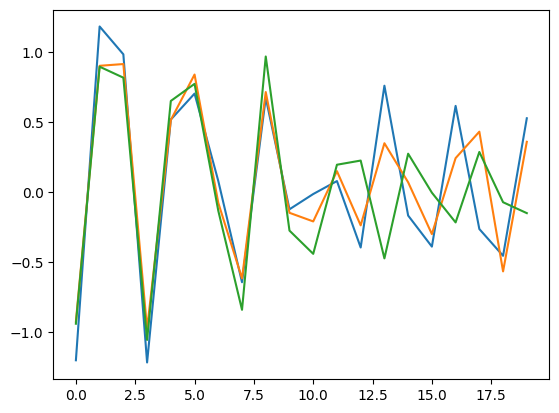

In [397]:

plt.plot(series_new[0].T[0]);plt.plot(series_new[1].T[0]);plt.plot(series_new[2].T[0]);

In [408]:
dtaidistance.dtw_ndim.distance_matrix_fast([series_new[0].T.astype('float64'), series_new[1].T.astype('float64')]) 

array([[ 0.        , 53.10174862],
       [53.10174862,  0.        ]])

In [261]:
import dtaidistance
from dtaidistance import dtw_visualisation
#dtaidistance.dtw_visualisation.plot_average([series_new[0].T, series_new[1].T])

In [333]:
series_new[0].T.shape

(141, 20)

In [424]:
ds_test = dtaidistance.dtw_ndim.distance_matrix_fast([s.T.astype('float64') for s in series_new])
ds_test, ds_test.std(), ds_test.mean()

(array([[ 0.        , 53.10174862, 67.56577124, 53.32131533, 59.9172184 ],
        [53.10174862,  0.        , 56.87890659, 43.68250618, 50.9622571 ],
        [67.56577124, 56.87890659,  0.        , 53.16730935, 63.73616558],
        [53.32131533, 43.68250618, 53.16730935,  0.        , 53.72755793],
        [59.9172184 , 50.9622571 , 63.73616558, 53.72755793,  0.        ]]),
 22.974968602289785,
 44.484860504167294)

In [425]:
compute_dtw(series), compute_dtw(series).std(), compute_dtw(series).mean()

Max time is 234
Max time is 234
Max time is 234


(array([[ 0.        , 52.70628268, 65.05117466, 52.99683375, 59.743401  ],
        [52.70628268,  0.        , 56.0162004 , 43.44385127, 50.7231639 ],
        [65.05117466, 56.0162004 ,  0.        , 50.71567633, 63.00645437],
        [52.99683375, 43.44385127, 50.71567633,  0.        , 53.44344397],
        [59.743401  , 50.7231639 , 63.00645437, 53.44344397,  0.        ]]),
 22.57928528698823,
 43.82771858628072)

Max time is 234
Max time is 234


(array([[ 0.        , 54.82341619],
        [54.82341619,  0.        ]]),
 array([[ 0.        , 52.70628268],
        [52.70628268,  0.        ]]))

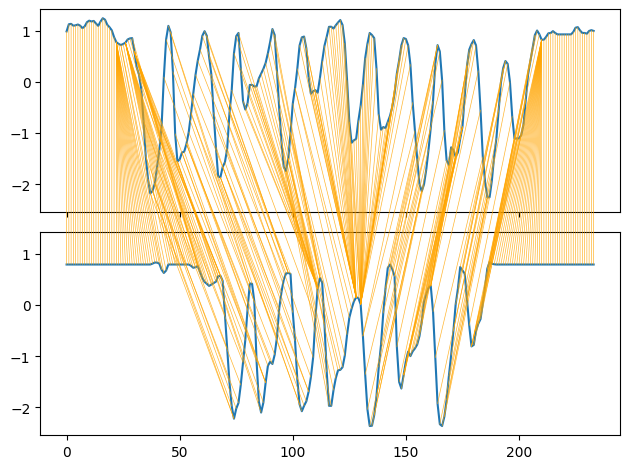

In [429]:
from dtaidistance import dtw
from dtaidistance import dtw_visualisation as dtwvis
import numpy as np
s1 = mean_norm(series_new[0])[2]
s2 = mean_norm(series_new[1])[2]
path = dtw.warping_path(s1, s2)
dtwvis.plot_warping(s1, s2, path), 

#padded, not padded
compute_dtw([series_new[0], series_new[1]]), compute_dtw([series[0], series[1]])
             

Max time is 234


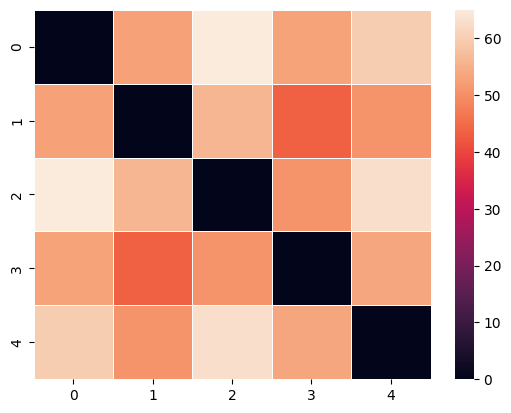

In [400]:
import seaborn as sns
ax = sns.heatmap(compute_dtw(series), linewidth=0.5)
plt.show()

[Text(0.5, 1.0, 'Matching cost function')]

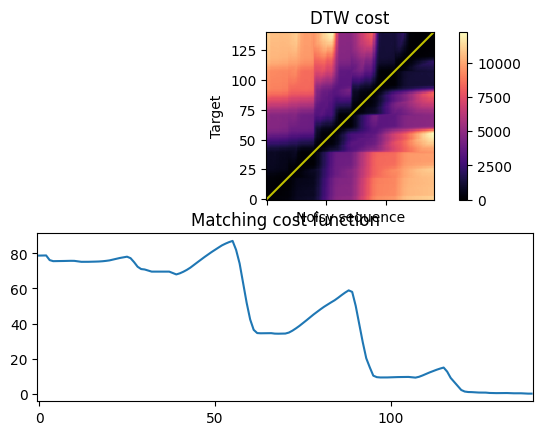

In [258]:
D, wp = librosa.sequence.dtw(series_new[0].astype('float64'), series_new[0].astype('float64'))

fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(D, x_axis='frames', y_axis='frames',
                               ax=ax[0])
ax[0].set(title='DTW cost', xlabel='Noisy sequence', ylabel='Target')
ax[0].plot(wp[:, 1], wp[:, 0], label='Optimal path', color='y')
fig.colorbar(img, ax=ax[0])
ax[1].plot(D[-1, :] / wp.shape[0])
ax[1].set(title='Matching cost function')

In [263]:
import tslearn.metrics

tslearn.metrics.ctw(series_new[0].T, series_new[1].T)

885.4397251642046

In [265]:
series_new[0].T.shape

(141, 20)

In [110]:
np.argwhere(np.isnan(ds[0,:]))

array([[12279],
       [17578],
       [18861],
       [19389],
       [19437]])

In [406]:
ds[:,12279]

array([144.54286521, 144.54286521, 144.54286521, ..., 144.54286521,
       144.54286521, 144.54286521])

AttributeError: 'numpy.ndarray' object has no attribute 'dropna'

In [403]:
Audio(data= SELECTED_DATAFRAME_SEGMENTS.iloc[12279]['voc_segments'], rate=44100)

In [146]:
#librosa.display.specshow(SELECTED_DATAFRAME_SEGMENTS.iloc[12279]['specs']);

In [147]:
mean_norm(SELECTED_DATAFRAME_SEGMENTS['mfccs'].iloc[12279])

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [154]:
compute_dtw(SELECTED_DATAFRAME_SEGMENTS['mfccs'].iloc[12278:12280].tolist()[:1000])

Max time is 111


array([[ 0.        , 47.11687539],
       [47.11687539,  0.        ]])

In [159]:
np.argwhere(np.isnan(ds).any(axis=1))

array([[    0],
       [    1],
       [    2],
       ...,
       [19546],
       [19547],
       [19548]])

In [173]:
# Some mfccs have constant values. They may be anomalies.
# A mean-variance normalisation would return NaN (std is 0, division by 0)
np.argwhere(np.isnan(ds[0,:]))

array([], shape=(0, 1), dtype=int64)

In [437]:
# Some mfccs have constant values. They may be anomalies.
# A mean-variance normalisation would return NaN (std is 0, division by 0)
# Replace all NaN with max distance in the matrix

ds_test = np.nan_to_num(ds_test, copy=True, nan=ds_test[~np.isnan(ds_test)].max())

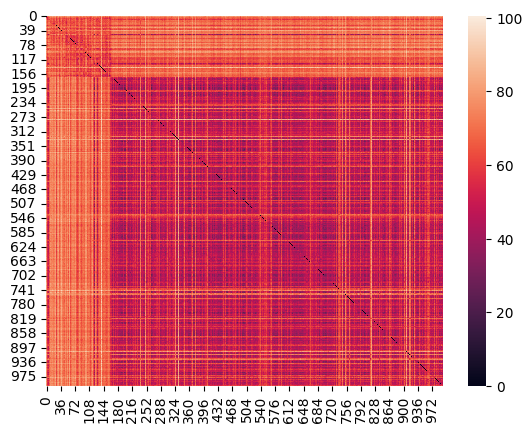

In [438]:
import seaborn as sns
ax = sns.heatmap(ds_test[:1000, :1000], linewidth=0.5, linecolor=None)
plt.rcParams["axes.grid"] = False

plt.show()

In [439]:
np.any(np.isnan(ds_test[:1000]))

False

In [436]:
ds_test

array([[ 0.        , 52.70628268, 65.05117466, ..., 80.97388793,
        76.28824893, 81.91784327],
       [52.70628268,  0.        , 56.0162004 , ..., 74.24436208,
        68.3051471 , 76.13197122],
       [65.05117466, 56.0162004 ,  0.        , ..., 52.57329497,
        53.6632539 , 61.11709445],
       ...,
       [80.97388793, 74.24436208, 52.57329497, ...,  0.        ,
        48.20523029, 59.52160656],
       [76.28824893, 68.3051471 , 53.6632539 , ..., 48.20523029,
         0.        , 57.168754  ],
       [81.91784327, 76.13197122, 61.11709445, ..., 59.52160656,
        57.168754  ,  0.        ]])

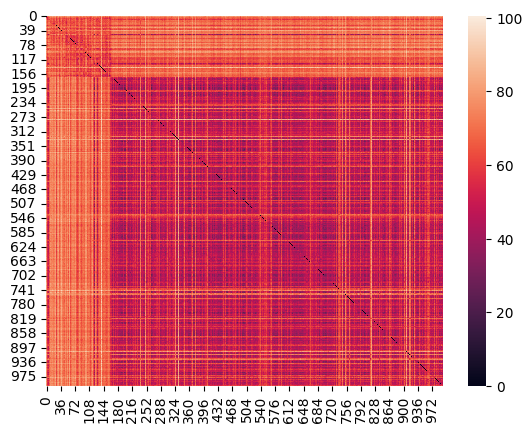

In [444]:
import seaborn as sns
ax = sns.heatmap(ds_test, linewidth=0.5,  linecolor=None)
plt.rcParams["axes.grid"] = False

plt.show()

In [40]:
#SELECTED_DATAFRAME_SEGMENTS = mother2pup_All
#SELECTED_DATAFRAME_SEGMENTS.head(1)

In [113]:
[s.T.shape for s in SELECTED_DATAFRAME_SEGMENTS['mfccs'].to_list()[:2]]

[(141, 20), (123, 20)]

In [266]:
SELECTED_DATAFRAME_SEGMENTS.head(1)

,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,rolloff_max,...,flatness,temporal_stats,label_context,label_addressee,FileID,Folder,File name,Pos_segment,Start_seg,End_seg
segmentID,,,,,,,,,,,,,,,,,,,,,
0,0,"[-1.147857e-05, 1.9681662e-05, -2.341274e-05, ...","(53520.0, files201, 121001002340125828.WAV, 0,...",24707,226,"[[-795.79956, -791.7445, -790.3716, -790.59576...","[[2.0290967e-08, 1.0173882e-08, 3.6544895e-10,...","[[3.1095765e-06, 1.5552107e-06, 3.435952e-08, ...","[[18354.627494763612, 15307.952243992131, 1484...","[[111694.3359375, 111083.984375, 110961.914062...",...,"[[0.02026382, 0.003390743, 0.0013236615, 0.001...",0.000177,11,0,53520.0,files201,121001002340125828.WAV,0,49290,73997


In [267]:
%%time


# BE AWARE DTW ask for time indexes first, then features, while librosa is the opposite => transpose

ds = compute_dtw(SELECTED_DATAFRAME_SEGMENTS['mfccs'].tolist())

Max time is 675
CPU times: user 6h 25min 30s, sys: 8.99 s, total: 6h 25min 39s
Wall time: 18min 36s


In [195]:
#DS_FILENAME = 'offspring_relationships'

DS_FILENAME = 'bat_215'

#with open(f'{DS_FILENAME}_ds.pkl','wb') as f:
#    pickle.dump(ds, f, protocol=pickle.HIGHEST_PROTOCOL)


In [196]:
with open(f'{DS_FILENAME}_ds.pkl','rb') as f:
    ds = pickle.load(f)


In [290]:
np.sqrt(ds.size) == SELECTED_DATAFRAME_SEGMENTS.shape[0], SELECTED_DATAFRAME_SEGMENTS.shape[0]

(True, 12941)

In [12]:
#ds_spectrograms = compute_dtw([s.T for s in pup2mother_All['specs'].to_list()])

In [23]:
# communication and ecolocation:
# Hearing in a megachiropteran fruit bat (Rousettus aegyptiacus)
# 10.1037/0735-7036.112.4.371

f0_series_filtered = SELECTED_DATAFRAME_SEGMENTS['f0'].apply(lambda x : np.unique(x)).explode()

pd.cut(f0_series_filtered, bins = [0, 2250, 5000, 13000, 25000, 32000,45000, 64000, 120000]).value_counts()




(0, 2250]          12094
(5000, 13000]       4691
(2250, 5000]        4138
(13000, 25000]      1605
(25000, 32000]       186
(32000, 45000]        54
(45000, 64000]        35
(64000, 120000]        8
Name: f0, dtype: int64

In [77]:
np.unique(pup2mother_All['f0'].loc[0])

array([   0.        , 1695.14095097])

In [142]:
def test_comm_type( array ):
    # remove 0s f0
    array = array[array > min(array)]
    if np.mean( np.unique( array )) < 13000:
        print(np.mean( np.unique( array )))
        return 'communication'
    else:
        return 'ecolocation'

In [146]:
pup2mother_All['com_type'].value_counts()

ecolocation    3129
Name: com_type, dtype: int64

In [144]:
pup2mother_All['com_type'] = pup2mother_All['bandwidths'].apply(lambda x : test_comm_type(x))

/data0/home/h21/luas6629/venv/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,


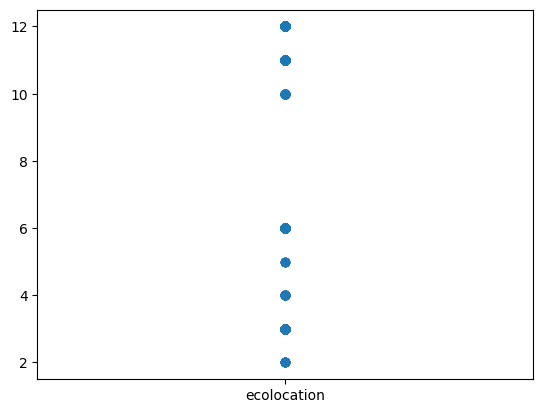

In [145]:
plt.scatter(x  = pup2mother_All['com_type'], y = pup2mother_All['label_context'])

In [98]:
pup2mother_All.columns

Index(['commonSourceID', 'voc_segments', 'voc_segments_ix',
       'voc_segments_duration', 'emitter', 'mfccs', 'mel_filtered', 'specs',
       'bandwidths', 'rolloff_max', 'rolloff_min', 'spec_centroids',
       'spec_centroids_stats', 'spec_contrasts', 'f0', 'flatness',
       'temporal_stats', 'label_context', 'label_addressee', 'FileID',
       'Folder', 'File name', 'Pos_segment', 'Start_seg', 'End_seg',
       'Emitter'],
      dtype='object')

In [291]:
ds_spectroids = compute_dtw([s.T for s in pup2mother_All['spec_centroids'].to_list()])

### Hierarchical Clustering

In [197]:
# Hierarchical Clustering


from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from scipy.spatial.distance import squareform

def norm_dendrogram(ds):
    
    ds = (ds-np.min(ds))/(np.max(ds)-np.min(ds))
    return ds

def get_dendrogram(ds, method = 'ward'):
    
    # norm if not..
    ds = (ds-np.min(ds))/(np.max(ds)-np.min(ds))
    
    # sparse matrix 
    condensed_dist = squareform(ds)
    
    # Create dendrogram using hierarchical clustering
    Z = linkage(condensed_dist, method= method)
    
    return Z


def plot_dendrogram(Z, sub_title = '', threshold=None):

    
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.set_title("Dendrogram")

    # Plot the dendrogram
    dendrogram(Z, labels=None, ax = ax, no_labels=True)

    if threshold:
        
        ax.axhline(y=threshold, color='r', linestyle='--')
        ax.set_title(f"Dendrogram - {sub_title} Threshold: {threshold} (normalized DTW)")

    plt.show()

In [392]:
t_step = np.arange(0, 1, .01)[30:]
c_size = [ len(np.unique(fcluster(Z_small_test, t, criterion='distance'))) for t in t_step]
len(c_size)

70

In [228]:
import numpy as np
from kneed import KneeLocator

from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform

def get_threshold(Z, cophene_distance_quantile=0.05, elbow=False):
    
    # use cophene distance to estimate elbow

    coph_dists = hierarchy.cophenet(Z)
    t = np.quantile(coph_dists, cophene_distance_quantile)
    clusters = np.unique( hierarchy.fcluster(Z, t, criterion='distance') )
    
    coph_steps = np.arange(0, coph_dists.max(), .1)
    c_size = [len(np.unique( hierarchy.fcluster(Z, t, criterion='distance')))  for t in coph_steps]

    
    kn = KneeLocator(coph_steps[1:], c_size[1:], curve='convex', direction='decreasing')
    elbow_point = (kn.knee, kn.knee_y)

    threshold_quantile = ( t, len(clusters))
    
    
    # plot the point
    fig, ax = plt.subplots()
    ax.plot(coph_steps, c_size)
    ax.axvline(x=elbow_point[0], color='r', linestyle='--')
    ax.axvline(x=threshold_quantile[0], color='b', linestyle='--')
    
    # add labels
    ax.text(elbow_point[0], 0.99, f'elbow method = {elbow_point[0]:.2f}', color='r', ha='right', va='top', rotation=90,
            transform=ax.get_xaxis_transform())
    ax.text(threshold_quantile[0], 0.99, f'quantile method = {threshold_quantile[0]:.2f}', color='b', ha='right', va='top', rotation=90,
            transform=ax.get_xaxis_transform())
    
    ax.set_xlabel('Cophene distance')
    ax.set_ylabel('Number of clusters')
    ax.set_title('''
    Clustering based on Cophene distance thresholds
        (Ward Dendrogram on DTW distance matrix) 
        ''')
    #ax.legend(['Elbow Method', 'Quantile Method'])
    plt.show()

    print("Elbow point: ", elbow_point)
    print(f"{cophene_distance_quantile} Quantile point: {threshold_quantile}")
    
    if elbow:
        return elbow_point
    else:
        return threshold_quantile

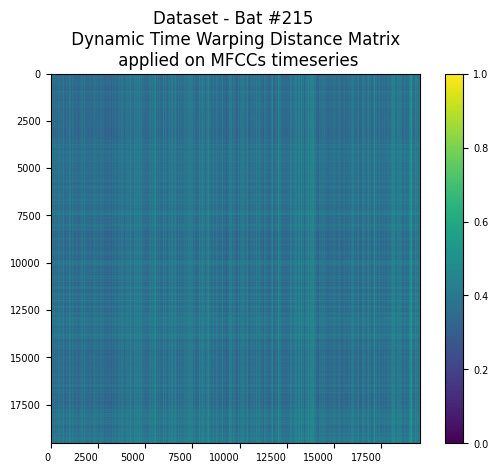

In [199]:
plot_dtw_matrix(norm_dendrogram(ds), 'Dataset - Bat #215 \n', '\n applied on MFCCs timeseries')
                

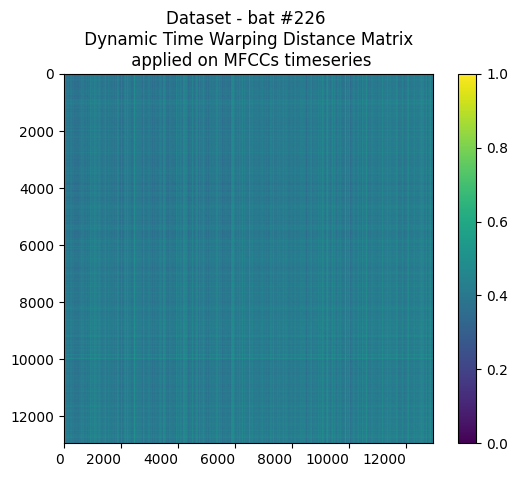

In [291]:
plot_dtw_matrix(norm_dendrogram(ds), 'Dataset - bat #226 \n', '\n applied on MFCCs timeseries')
                

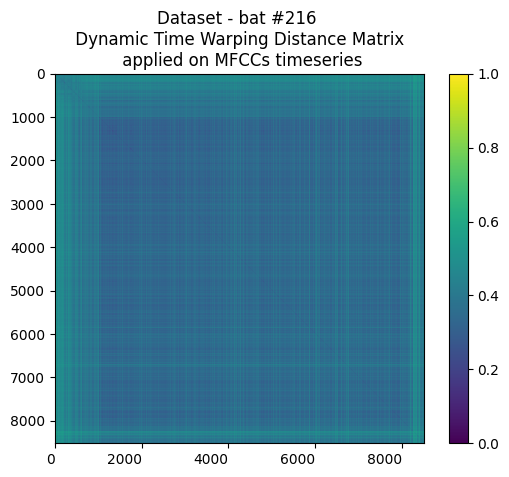

In [218]:
plot_dtw_matrix(norm_dendrogram(ds), 'Dataset - bat #216 \n', '\n applied on MFCCs timeseries')
                

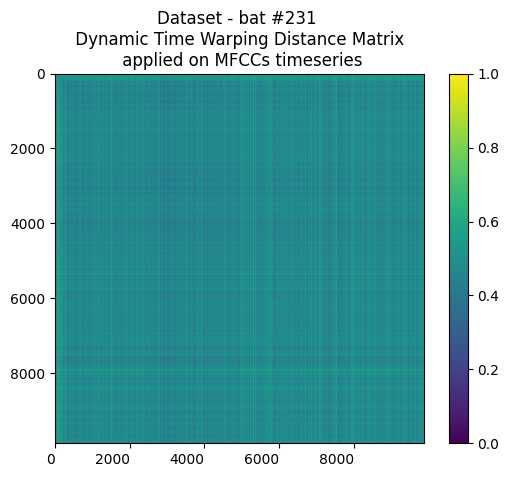

In [118]:
plot_dtw_matrix(norm_dendrogram(ds), 'Dataset - bat #231 \n', '\n applied on MFCCs timeseries')
                

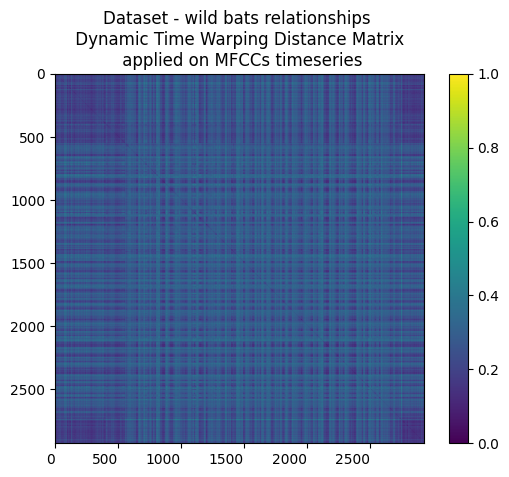

In [134]:
plot_dtw_matrix(norm_dendrogram(ds), 'Dataset - wild bats relationships \n', '\n applied on MFCCs timeseries')
                

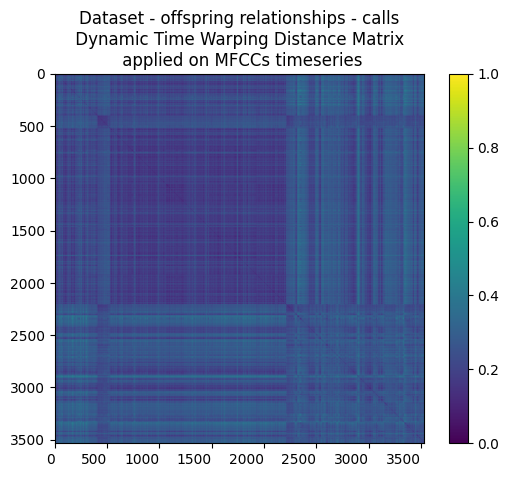

In [30]:
plot_dtw_matrix(norm_dendrogram(ds), 'Dataset - offspring relationships - calls\n', '\n applied on MFCCs timeseries')
                

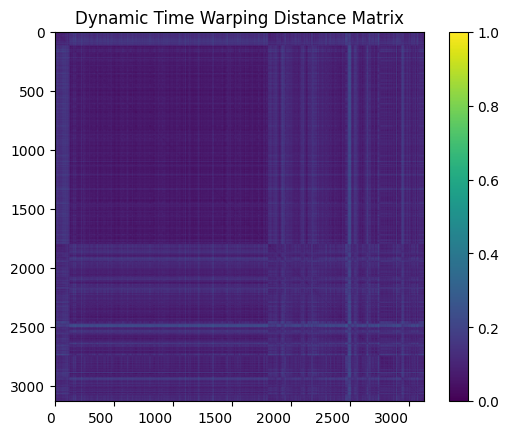

In [301]:
#plot_dtw_matrix(norm_dendrogram(ds_spectroids))

In [150]:
#plot_dtw_matrix(norm_dendrogram(ds_spectrograms))

In [151]:
#plot_dtw_matrix(norm_dendrogram(ds * ds_spectroids))

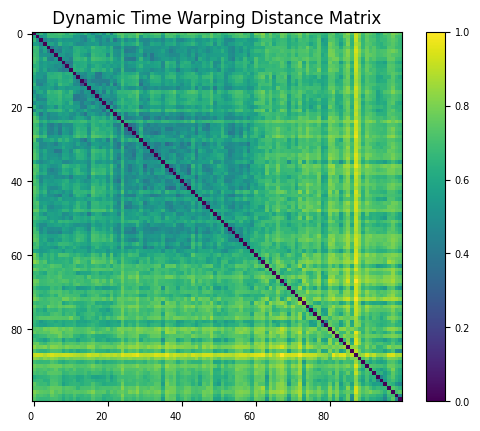

In [204]:
plot_dtw_matrix(norm_dendrogram(ds[:100, :100] ))

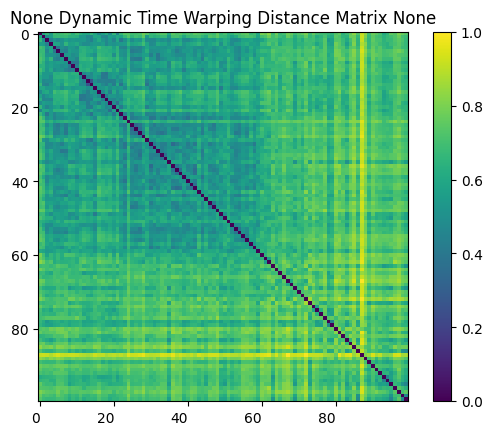

In [368]:
plot_dtw_matrix(norm_dendrogram(ds[:100, :100]))

In [31]:
norm_dendrogram(ds).mean(), norm_dendrogram(ds).std()

(0.5071533525503088, 0.07846702192205293)

In [383]:
0.07655014389375961 * 2 + 0.38228332099541146

0.5353836087829307

In [119]:
Z = get_dendrogram(norm_dendrogram(ds), method = 'ward')

In [220]:
Z_small_test = get_dendrogram(ds[:100, :100], method = 'single')

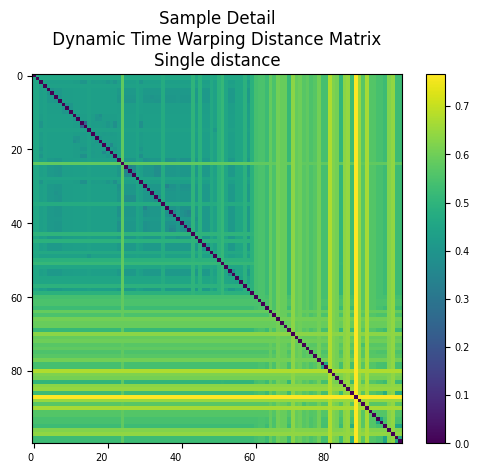

In [221]:
# Calculate the cophenetic distances

from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform
coph_dists = hierarchy.cophenet(Z_small_test)

# Compute the mean and standard deviation of cophenetic distances
mean_coph_dist = np.mean(coph_dists)
std_coph_dist = np.std(coph_dists)

plot_dtw_matrix(squareform(coph_dists), 'Sample Detail\n', '\nSingle distance')

In [33]:
coph_dists.mean(), coph_dists.std(), coph_dists.max()

NameError: name 'coph_dists' is not defined

In [95]:
coph_dists[-1]

1.1494887315383935

In [138]:
np.quantile(coph_dists, .05)

0.5030749073359555

In [139]:
# Perform clustering with the chosen parameters
clusters = hierarchy.fcluster(Z_small_test, 0.5, criterion = 'distance')

In [35]:
# Perform clustering with the chosen parameters
clusters = hierarchy.fcluster(Z_small_test, 10, criterion = 'maxclust')


In [140]:
np.unique(clusters).shape

(54,)

(array([2242., 1733., 1273., 1371.,   81.,  717., 3406., 2752., 2692.,
        3282.]),
 array([ 1. ,  3.8,  6.6,  9.4, 12.2, 15. , 17.8, 20.6, 23.4, 26.2, 29. ]),
 <BarContainer object of 10 artists>)

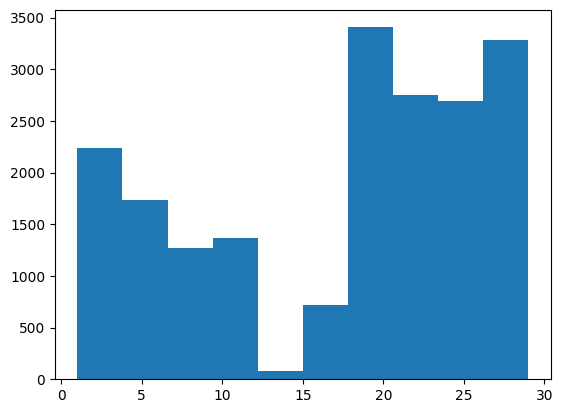

In [99]:
plt.hist(clusters)

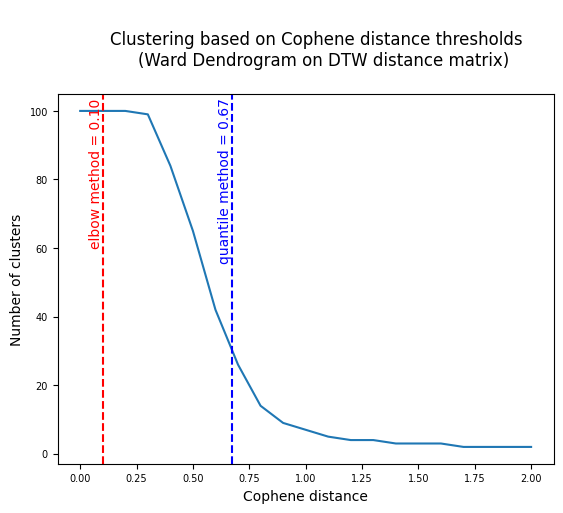

Elbow point:  (0.1, 100)
0.05 Quantile point: (0.6735144025701343, 29)


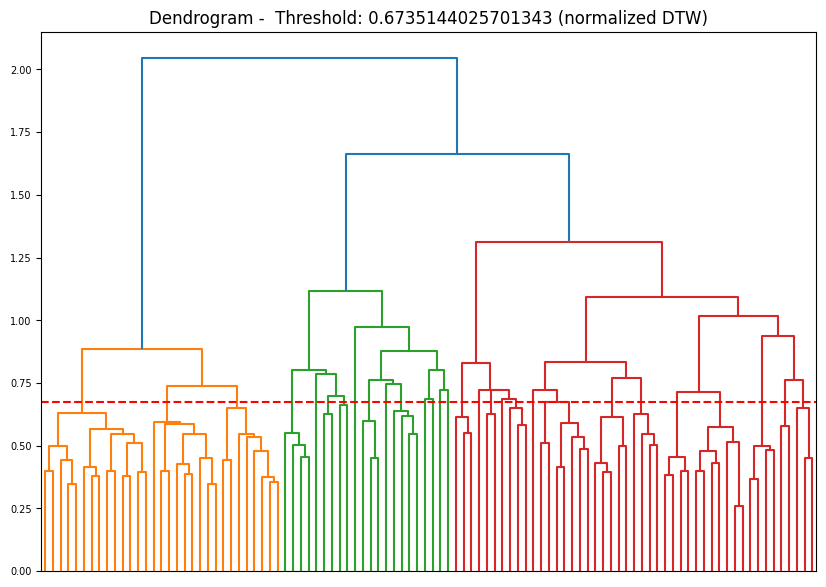

In [239]:
Z_small_test = get_dendrogram(ds[:100, :100], method = 'ward')
elbow_point = get_threshold(Z_small_test)
plot_dendrogram(Z_small_test, sub_title = '', threshold = elbow_point[0])

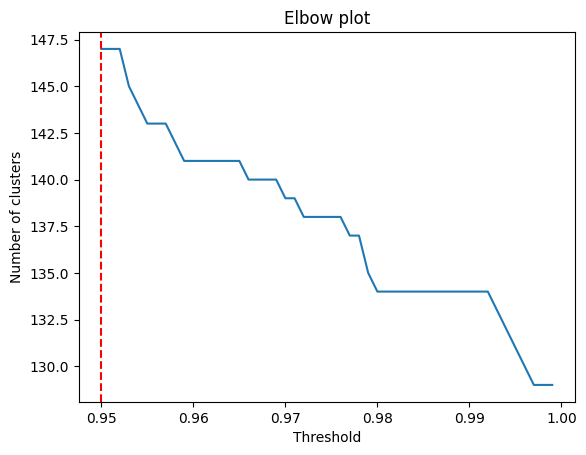

Elbow point:  (0.9500000000000001, 147)


In [341]:
Z = get_dendrogram(norm_dendrogram(ds), method='ward')
elbow_point = get_threshold(Z, shift_right_steps = 950)
#plot_dendrogram(Z, elbow_point)

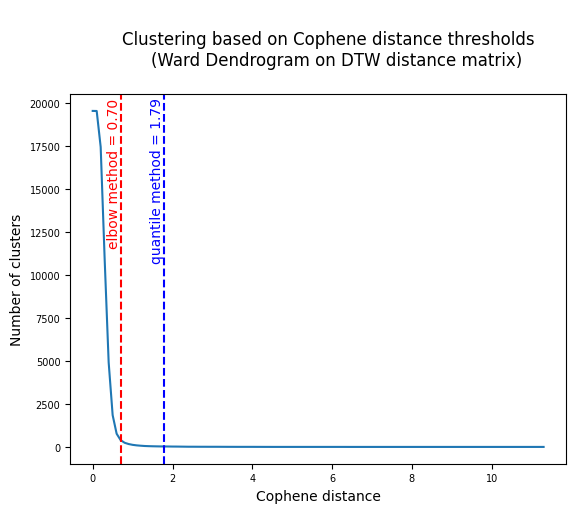

Elbow point:  (0.7000000000000001, 398)
0.05 Quantile point: (1.7897610854538375, 29)


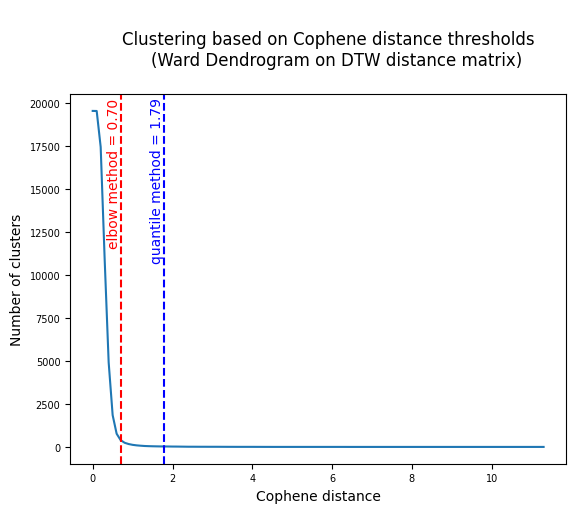

Elbow point:  (0.7000000000000001, 398)
0.05 Quantile point: (1.7897610854538375, 29)


In [230]:
Z = get_dendrogram(norm_dendrogram(ds), method='ward')
q_threshold = get_threshold(Z, elbow=False)
elbow_threshold = get_threshold(Z, elbow=True)

## Vocabulary of Syllables

In [275]:
#THRESHOLD = elbow_threshold
THRESHOLD = q_threshold

SYLLABLE_ID_TYPE = 'syllableID_qt_ward' if THRESHOLD == q_threshold else 'syllableID_et_ward'

In [232]:
THRESHOLD, SYLLABLE_ID_TYPE

((1.7897610854538375, 29), 'syllableID_qt_ward')

In [278]:
def get_clusters(Z, threshold, criterion = 'distance'):
    clusters_dendrogram = fcluster(Z, threshold, criterion=criterion)
    return clusters_dendrogram

def plot_clusters_frequences(clusters_list, pretitle = '', subtitle = ''):
    """
    A list with a numerical ID associated to the Index of each segment
    """
    bars, freq = np.unique(clusters_list, return_counts=True)
    
    plt.bar(bars, freq)
    plt.title(f'{pretitle} Number of segments per cluster {subtitle}')
    plt.show()

In [331]:
THRESHOLD

(1.7897610854538375, 29)

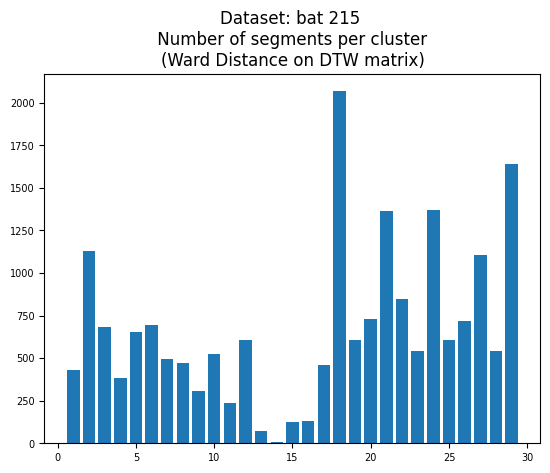

In [280]:
clusters_dendrogram = get_clusters(Z, THRESHOLD[0], criterion = 'distance')

plot_clusters_frequences(clusters_dendrogram, f"Dataset: {DS_FILENAME.replace('_', ' ')} \n", "\n(Ward Distance on DTW matrix)")

In [286]:
import collections

def map_syllables_df(df, cluster, syllableID_column_name  = 'syllableID',  rebuild=False):
    
    assert df.shape[0] == sum([v for k, v in collections.Counter(clusters_dendrogram).items()])
            
    
    # Check if any of the columns are present in the dataframe
    if any(col in df.columns for col in ['Folder', 'File name', 'sequenceID', 'start', 'end']):
        
        print("Db already exploded. Please check.")
        
    else:
        
        df.reset_index(inplace=True)
        if 'index' in df.columns:
            df.drop('index', axis=1)
        
        # expand the origin of the db: 'Folder', 'File name', 'sequenceID', 'start', 'end'
        df = pd.concat(
            [ df,
              pd.DataFrame([_ for _ in df['voc_segments_ix'].values], 
                 columns = ['FileID', 'Folder', 'File name', 'sequenceID', 'start', 'end']),
            ], axis=1)
        
    if not any(col in df.columns for col in ['syllableID']) or rebuild:
        # map the cluster labels as syllables ID
        
        df.reset_index(drop=True, inplace=True)
        
        # recreate index
        df['segmentID'] = range(len(df.index))
        
    
        df[ syllableID_column_name ] = df['segmentID'].apply(lambda x : cluster[x])
        #df['duration'] = df['end'] - df['start']
        
        df.set_index('segmentID', inplace=True)
    
        #move column on the right for readability
        df.insert(0, syllableID_column_name , df.pop( syllableID_column_name ))
        
    return df

#pup2mother_All = map_syllables_df(pup2mother_All, clusters_dendrogram)
#pup2mother_All.tail()

SELECTED_DATAFRAME_SEGMENTS = map_syllables_df(SELECTED_DATAFRAME_SEGMENTS, clusters_dendrogram, SYLLABLE_ID_TYPE, rebuild=True)
SELECTED_DATAFRAME_SEGMENTS.tail()


Db already exploded. Please check.


,syllableID_qt_ward,commonSourceID,voc_segments,voc_segments_ix,voc_segments_duration,emitter,mfccs,mel_filtered,specs,bandwidths,...,flatness,temporal_stats,label_context,label_addressee,FileID,Folder,File name,Pos_segment,Start_seg,End_seg
segmentID,,,,,,,,,,,,,,,,,,,,,
19544,27,0,"[-4.3459977e-06, 1.7754257e-07, 4.478548e-06, ...","(293184.0, files224, 140219055925290410.WAV, 2...",10612,215,"[[-798.8522, -798.4424, -799.38367, -800.0, -8...","[[1.9877374e-08, 9.914001e-09, 1.3031582e-13, ...","[[3.0337326e-06, 1.5130976e-06, 3.102174e-11, ...","[[21901.39924141116, 18183.053149709194, 9263....",...,"[[0.026959617, 0.014718509, 0.032987434, 0.087...",0.000099,9,221,293184.0,files224,140219055925290410.WAV,2,151347,161959
19545,19,0,"[2.0383354e-06, -2.4169108e-06, 2.572534e-06, ...","(293184.0, files224, 140219055925290410.WAV, 3...",15246,215,"[[-799.98645, -798.5542, -797.7297, -797.47186...","[[5.8715535e-09, 2.9242249e-09, 1.7433099e-12,...","[[8.9609193e-07, 4.4648593e-07, 1.6491791e-10,...","[[19422.58807588085, 11388.133891217323, 4978....",...,"[[0.054485, 0.0044255424, 0.0009924177, 0.0006...",0.000104,9,221,293184.0,files224,140219055925290410.WAV,3,188847,204093
19546,8,0,"[-1.1442537e-05, -1.6485361e-06, 4.191636e-06,...","(293184.0, files224, 140219055925290410.WAV, 4...",34967,215,"[[-790.35736, -774.5462, -754.98816, -745.9334...","[[9.019414e-08, 4.4780872e-08, 8.6568766e-11, ...","[[1.3724749e-05, 7.0441956e-06, 1.2092089e-08,...","[[41753.819074118794, 24084.825572408645, 6596...",...,"[[0.016793009, 0.0005310431, 1.0092545e-05, 5....",0.000172,9,221,293184.0,files224,140219055925290410.WAV,4,227847,262814
19547,26,0,"[-1.6214052e-06, 6.172995e-06, -9.03307e-06, 9...","(293184.0, files224, 140219055925290410.WAV, 5...",20493,215,"[[-753.9838, -753.9437, -753.9404, -753.3426, ...","[[3.4884888e-09, 2.3939675e-09, 2.752834e-11, ...","[[4.5662443e-07, 3.2813838e-07, 8.463364e-09, ...","[[16924.469121055063, 14767.156867483855, 1050...",...,"[[0.044726152, 0.027868668, 0.021530148, 0.010...",0.000164,9,221,293184.0,files224,140219055925290410.WAV,5,302134,322627
19548,26,0,"[2.1318483e-06, 2.0727928e-06, -5.532336e-06, ...","(293184.0, files224, 140219055925290410.WAV, 6...",23034,215,"[[-756.31836, -753.6846, -750.2814, -749.1728,...","[[1.5209096e-08, 7.5915e-09, 2.9336433e-11, 6....","[[2.3210373e-06, 1.1582343e-06, 4.6263313e-09,...","[[35930.485157153584, 40106.048441762185, 2548...",...,"[[0.019971244, 0.005239957, 0.00042055186, 0.0...",0.000226,9,221,293184.0,files224,140219055925290410.WAV,6,340347,363381


In [290]:
SELECTED_DATAFRAME_SEGMENTS['Emitter'] = SELECTED_DATAFRAME_SEGMENTS.emitter.iloc[:]

In [291]:
#save
#with open(f'{DS_FILENAME}_{THRESHOLD[1]}_map_complete.pkl','wb') as f:
#            pickle.dump(SELECTED_DATAFRAME_SEGMENTS, f, protocol=pickle.HIGHEST_PROTOCOL)


In [292]:
# test

def play_syllable_type(df, label_type = 1, sr = 88200):
    
    for i, row in df[df['syllableID_qt_ward'] == label_type].head().iterrows():

        display(Audio(data = row['voc_segments'], rate = 88200))
        print(f"Emitter {row['Emitter']} - Context { row['label_context'] } - Addressee {  row['label_addressee'] }  ")

play_syllable_type(SELECTED_DATAFRAME_SEGMENTS, label_type = 29, sr = 88200)

Emitter 215 - Context 11 - Addressee 207  


Emitter 215 - Context 12 - Addressee 0  


Emitter 215 - Context 12 - Addressee 0  


Emitter 215 - Context 12 - Addressee 230  


Emitter 215 - Context 12 - Addressee 210  


In [332]:
SELECTED_DATAFRAME_SEGMENTS.columns

Index(['syllableID_qt_ward', 'commonSourceID', 'voc_segments',
       'voc_segments_ix', 'voc_segments_duration', 'emitter', 'mfccs',
       'mel_filtered', 'specs', 'bandwidths', 'rolloff_max', 'rolloff_min',
       'spec_centroids', 'spec_centroids_stats', 'spec_contrasts', 'f0',
       'flatness', 'temporal_stats', 'label_context', 'label_addressee',
       'FileID', 'Folder', 'File name', 'Pos_segment', 'Start_seg', 'End_seg',
       'Emitter'],
      dtype='object')

In [294]:
def get_syllables_df(df, cluster, syllableID_column = 'syllableID'):
    

    tmp = df[['label_addressee', 'label_context', syllableID_column, 'Pos_segment', 'voc_segments_duration', 'voc_segments', 'Start_seg', 'End_seg', 'Folder', 'File name', 'FileID', 'Emitter' ]]
    
    # export a df 
        
    filenames = tmp['File name'].unique()
    sequences = []
    durations = []
    sequences_ix = []
    pos_segments = []
    folders = []
    fileIDs = []
    emitters = []
    label_addressee = []
    label_context = []
    
    
    for filename in filenames:
        
        tmp_file_seq = tmp[tmp['File name'] == filename]
        #tmp_file_seq.reset_index(inplace=True)

        #print(tmp_file_seq)
        # ensure sequence is sorted by increamental Pos_segment - example:
        # 0, 1, 2, ... !
        try:
            tmp_file_seq = tmp_file_seq.loc[tmp_file_seq['Pos_segment'].sort_values().index]
            pos_segments.append( tmp_file_seq['Pos_segment'].tolist() )
        except AttributeError:
            pass
        
        folders.append( tmp_file_seq['Folder'].unique()[0] )
        fileIDs.append( tmp_file_seq['FileID'].unique()[0].astype(int) )
        emitters.append( tmp_file_seq['Emitter'].unique())

        # sequence of syllables and durations
        sequences.append( tmp_file_seq[ syllableID_column ].tolist() )
        durations.append( tmp_file_seq['voc_segments_duration'].tolist() )
        
        # segmentID is the index
        sequences_ix.append( tmp_file_seq.T.columns.tolist() )
        
        # aggregate context classes, if more than one
        #label_addressee.append( tmp_file_seq['label_addressee'].unique().tolist() )
        #label_context.append( tmp_file_seq['label_context'].unique().tolist() )
        label_addressee.append( tmp_file_seq['label_addressee'].tolist() )
        label_context.append( tmp_file_seq['label_context'].tolist() )
        

                
    return pd.DataFrame.from_dict({
        'File name' : filenames, 
        'Seq_Syllables' : sequences, 
        'Seq_Syllables_ix' : sequences_ix, 
        'Pos_Segment' : pos_segments, 
        'Duration' : durations, 
        'Folder' : folders,
        'FileID' : fileIDs  ,
        'Emitter' : emitters,
        'label_addressee' :label_addressee,
        'label_context' : label_context})

        

In [334]:
symbolic_sequences = get_syllables_df(SELECTED_DATAFRAME_SEGMENTS, clusters_dendrogram, syllableID_column = SYLLABLE_ID_TYPE)
symbolic_sequences.head()

,File name,Seq_Syllables,Seq_Syllables_ix,Pos_Segment,Duration,Folder,FileID,Emitter,label_addressee,label_context
0,121004165931143478.WAV,"[13, 13]","[0, 1]","[0, 1]","[35952, 31246]",files201,61822,[215],"[217, 217]","[6, 6]"
1,121004172433181482.WAV,"[13, 13]","[2, 3]","[0, 1]","[29746, 28934]",files201,61879,[215],"[217, 217]","[6, 6]"
2,121004172647137483.WAV,[13],[4],[0],[27746],files201,61882,[215],[217],[6]
3,121004172921179484.WAV,"[13, 13, 13]","[5, 6, 7]","[0, 1, 2]","[34746, 34746, 33246]",files201,61894,[215],"[217, 217, 217]","[6, 6, 6]"
4,121004173710156486.WAV,[13],[8],[0],[21940],files201,61900,[215],[217],[6]


In [296]:
symbolic_sequences[symbolic_sequences['File name'] == filename_test]

,File name,Seq_Syllables,Seq_Syllables_ix,Pos_Segment,Duration,Folder,FileID,Emitter,label_addressee,label_context


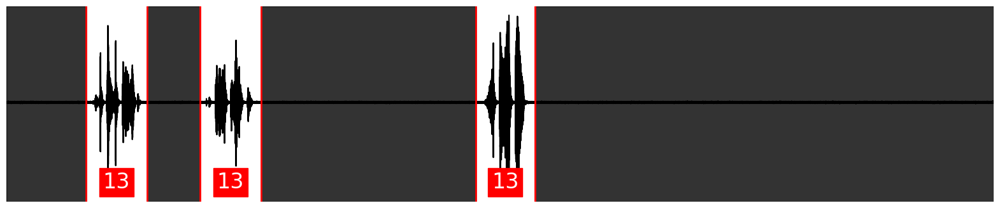

In [313]:
#filename_test = '121129045223287585.WAV'
#filename_test = '121004173718193940.WAV'
filename_test = '121002053413724422.WAV' 
filename_test = '121209010250178680.WAV' #very long file
filename_test = '121004172433181482.WAV' # this and 121129045223287585 sound similar but different bats?
filename_test = '121004172921179484.WAV'
#filename_test = '140218050022138776.WAV' # questo file ha errori - un segmento e' marcato come silenzio e invece no
#filename_test = '140217162446769945.WAV'

seq_test = symbolic_sequences[symbolic_sequences['File name'] == filename_test]['Seq_Syllables'].values[0]



plot_and_play_wav(filename_test, 44100, seq_test)

In [63]:
#file_info[file_info['File name' == '121129045223287585.WAV']];

In [289]:
symbolic_sequences[symbolic_sequences['Seq_Syllables'].apply(lambda x : len(x) == 8)]

,File name,Seq_Syllables,Seq_Syllables_ix,Pos_Segment,Duration,Folder,FileID,Emitter,label_addressee,label_context
159,130101165443241337.WAV,"[118, 321, 273, 307, 179, 83, 274, 390]","[300, 301, 302, 303, 304, 305, 306, 307]","[0, 1, 2, 3, 4, 5, 6, 7]","[37668, 13480, 7446, 18445, 46746, 30890, 9894...",files211,154205,[215],"[220, 220, 220, 220, 220, 220, 220, 220]","[12, 12, 12, 12, 12, 12, 12, 12]"
190,130102050608317751.WAV,"[268, 178, 179, 176, 179, 174, 196, 317]","[438, 439, 440, 441, 442, 443, 444, 445]","[0, 1, 2, 3, 4, 5, 6, 7]","[8682, 32942, 37420, 36592, 34929, 19427, 2724...",files211,154780,[215],"[207, 207, 207, 207, 207, 207, 207, 207]","[11, 11, 11, 11, 11, 11, 11, 11]"
198,130102053538821809.WAV,"[388, 84, 176, 177, 179, 85, 319, 260]","[471, 472, 473, 474, 475, 476, 477, 478]","[0, 1, 2, 3, 4, 5, 6, 7]","[11291, 23746, 31246, 35461, 39746, 17296, 132...",files211,154866,[215],"[207, 207, 207, 207, 207, 207, 207, 207]","[12, 12, 12, 12, 12, 12, 12, 12]"
199,130102064450330822.WAV,"[340, 83, 338, 396, 317, 168, 273, 388]","[479, 480, 481, 482, 483, 484, 485, 486]","[0, 1, 2, 3, 4, 5, 6, 7]","[16091, 30616, 21376, 17665, 11752, 19881, 122...",files211,154911,[215],"[0, 0, 0, 0, 0, 0, 0, 0]","[12, 12, 12, 12, 12, 12, 12, 12]"
201,130102071534636833.WAV,"[182, 181, 275, 177, 268, 330, 268, 261]","[489, 490, 491, 492, 493, 494, 495, 496]","[0, 1, 2, 3, 4, 5, 6, 7]","[28998, 21029, 11405, 37851, 10102, 16701, 133...",files211,154922,[215],"[0, 0, 0, 0, 0, 0, 0, 0]","[12, 12, 12, 12, 12, 12, 12, 12]"
...,...,...,...,...,...,...,...,...,...,...
5960,140216021431860145.WAV,"[25, 32, 272, 48, 275, 149, 149, 275]","[17867, 17868, 17869, 17870, 17871, 17872, 178...","[0, 1, 2, 3, 4, 5, 6, 7]","[48179, 59828, 9746, 29426, 20241, 42174, 3391...",files224,291229,[215],"[221, 221, 221, 221, 221, 221, 221, 221]","[9, 9, 9, 9, 9, 9, 9, 9]"
6008,140217162446769945.WAV,"[275, 150, 350, 158, 76, 38, 331, 350]","[18384, 18385, 18386, 18387, 18388, 18389, 183...","[0, 1, 2, 3, 4, 5, 6, 7]","[8223, 40246, 22048, 29524, 30746, 42571, 1432...",files224,292132,[215],"[221, 221, 221, 221, 221, 221, 221, 221]","[9, 9, 9, 9, 9, 9, 9, 9]"
6031,140218050022138776.WAV,"[263, 372, 370, 272, 271, 272, 268, 375]","[18801, 18802, 18803, 18804, 18805, 18806, 188...","[0, 1, 2, 3, 4, 5, 6, 7]","[8562, 13713, 19755, 8260, 8818, 6504, 9246, 1...",files224,292540,[215],"[221, 221, 221, 221, 221, 221, 221, 221]","[9, 9, 9, 9, 9, 9, 9, 9]"
6054,140219025639377016.WAV,"[362, 275, 17, 69, 75, 75, 249, 331]","[18962, 18963, 18964, 18965, 18966, 18967, 189...","[0, 1, 2, 3, 4, 5, 6, 7]","[25746, 10246, 31660, 30955, 24557, 26389, 535...",files224,293025,[215],"[221, 221, 221, 221, 221, 221, 221, 221]","[9, 9, 9, 9, 9, 9, 9, 9]"


In [190]:
# how many have consecutive segments

#121103045057225251

def test_consecutive_segment(sequence_of_positions):
    sequence_of_positions = np.array(sequence_of_positions)
    
    if np.array_equal(sequence_of_positions, np.arange(0, sequence_of_positions.max() + 1, 1)):
        return True
    else:
        return False

symbolic_sequences['Pos_Segment'].apply(test_consecutive_segment).value_counts()

True     5845
False     234
Name: Pos_Segment, dtype: int64

In [243]:
file_info[file_info.FileID == 63549]

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
63549,63549,11,121005221219635013.WAV,files202,11,2012-10-05 22:21:17,44263.0,71019.0,99273.0,136019.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [244]:
q[q.FileID == 63549]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
15666,63549,207,209,6,0,0,0,0,1.0,99272.0
15667,63549,207,209,6,0,0,0,0,168273.0,467792.0


In [238]:
annotations[annotations.FileID == 63549]

,FileID,Emitter,Addressee,Context,Emitter pre-vocalization action,Addressee pre-vocalization action,Emitter post-vocalization action,Addressee post-vocalization action,Start sample,End sample
15666,63549,207,209,6,0,0,0,0,1.0,99272.0
15667,63549,207,209,6,0,0,0,0,168273.0,467792.0


In [ ]:
compute_segment_props_by_emitter(207, q[q.FileID == 63549], preprocess=True, test = True)

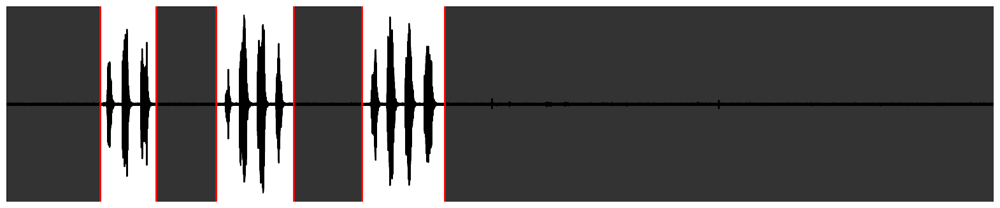

In [191]:
# check 121031222322554175.WAV
# file '121005221219635013.WAV' reports annotations for only 2 syllables out of 3
# are there others out there ?
plot_and_play_wav('121005221219635013.WAV')

In [ ]:
pup2mother_All

In [229]:
Audio(data = pup2mother_All.loc[5]['voc_segments'], rate =44100)

In [252]:
symbolic_sequences.set_index('File name').loc['121101222250043465.WAV']

Seq_Syllables                            [9, 17, 5, 2, 17, 17]
Seq_Syllables_ix                [409, 410, 411, 412, 413, 414]
Duration            [28752, 29744, 14137, 20792, 17676, 21540]
Folder                                                files204
FileID                                                   85919
Emitter                                                  [120]
label_addressee                 [213, 213, 213, 213, 213, 213]
label_context                         [11, 11, 11, 11, 11, 11]
Name: 121101222250043465.WAV, dtype: object

## Dictionaries

In [335]:
def plot_repertoire(symbolic_sequences, plot_labels=False, sub_title = ''):

    # flatten the sequences column and count the frequencies of each item
    items = symbolic_sequences['Seq_Syllables'].explode().value_counts().sort_values(ascending=False)

    # plot the bar chart
    fig, ax = plt.subplots(figsize=(8, 6))
    items.plot(kind='bar', ax=ax)

    # set axis labels and title
    ax.set_xlabel('Syllable-type')
    ax.set_ylabel('Frequency')
    ax.set_title(f'Distribution of Syllables in the Repertoire {sub_title}')

    # sort the x-axis based on the frequency of items
    sorted_items = items.index.tolist()
    ax.set_xticklabels(sorted_items, rotation=90)
    plt.show()
    

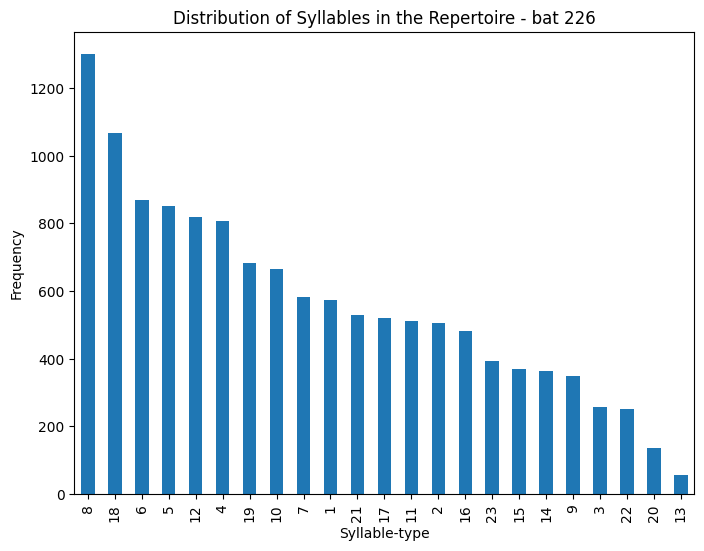

In [310]:
plot_repertoire(symbolic_sequences,  plot_labels=False, sub_title = f"- {DS_FILENAME.replace('_',' ')}")

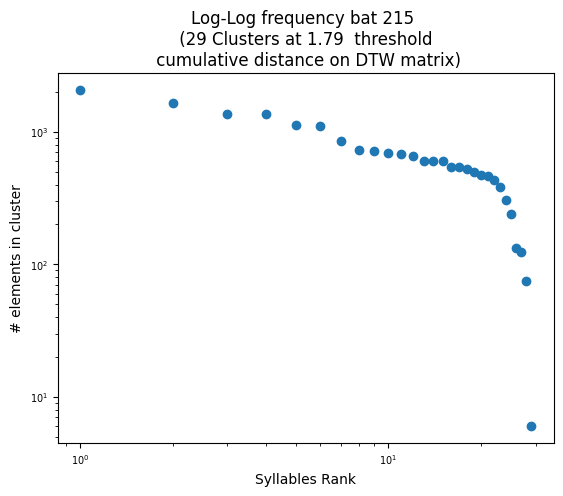

In [337]:
def plot_loglog_frequencies(seq_syllables_series, title = DS_FILENAME, subtitle = ''):

    # get the frequency counts of items
    counts = seq_syllables_series.explode().value_counts()

    # sort the items by their frequency
    sorted_items = counts.index.to_list()
    sorted_items.sort(key=lambda x: counts[x], reverse=True)

    # get the frequency counts and ranks
    freq = counts[sorted_items].values
    rank = np.arange(1, len(sorted_items)+1)

    # Create a list of all the items in the sequences
    items = []
    for seq in seq_syllables_series:
        items += seq

    # Get frequency distribution of items
    counts = pd.Series(items).value_counts().sort_values(ascending=False)

    # Plot log-log plot
    fig, ax = plt.subplots()
    ax.loglog(range(1, len(counts) + 1), counts.values, 'o')
    ax.set_xlabel('Syllables Rank')
    ax.set_ylabel('# elements in cluster')
    ax.set_title(f'Log-Log frequency {title.replace("_"," ")} {subtitle }')
    plt.show()

plot_loglog_frequencies(symbolic_sequences['Seq_Syllables'], 
                        title = DS_FILENAME, 
                        subtitle = f"\n ({THRESHOLD[1]} Clusters at {THRESHOLD[0]:.2f}  threshold \n cumulative distance on DTW matrix)")


In [273]:
def create_bigrams(series):
    """
    Transforms lists in a pandas Series into bi-grams.
    
    Args:
        series (pd.Series): Pandas Series containing lists.
        
    Returns:
        pd.Series: New Pandas Series with bi-grams.
    """
    # Create an empty list to store the bi-grams
    bigrams = []
    
    # Iterate through each list in the Series
    for lst in series:
        # If the list has only one element, skip it
        if len(lst) <= 1:
            continue
        # Otherwise, create bi-grams from the list
        else:
            bi_grams = [[lst[i], lst[i+1]] for i in range(len(lst)-1)]
            bigrams.append(bi_grams)
            
    # Convert the list of bi-grams to a new Series
    return pd.Series(bigrams, name=series.name)

In [286]:
create_bigrams(symbolic_sequences['Seq_Syllables'])

# Blackboard

In [20]:
ds = compute_dtw(pup2mother['mfccs'].to_list())

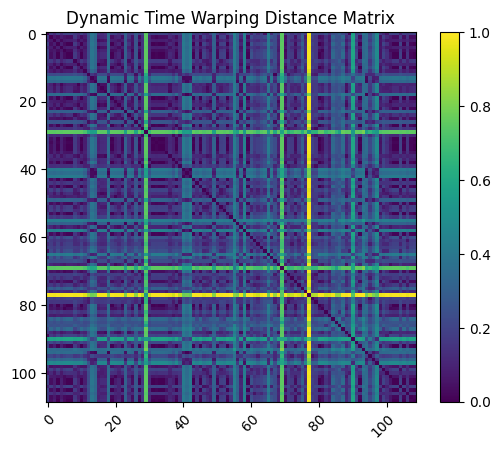

In [21]:
# mfcc OR mel_filtered ??
distances = dynamic_time_warping_by_mfcc(pup2mother['mfccs']) 

# normalize
distances = np.array(distances)
distances_norm = (distances-np.min(distances))/(np.max(distances)-np.min(distances))
        
# corr_matrix
n = int(np.sqrt(len(distances_norm)))
distances_norm = distances_norm.reshape(n,n)

#distances = softmax(distances)

# Plot correlation matrix
import matplotlib.pyplot as plt
import numpy as np

fig, ax = plt.subplots()
im = ax.imshow(distances_norm)

# Set axis labels and ticks
#ax.set_xticks(np.arange(len(mfccs)))
#ax.set_yticks(np.arange(len(mfccs)))
#ax.set_xticklabels(np.arange(1, len(mfccs)+1))
#ax.set_yticklabels(np.arange(1, len(mfccs)+1))

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Set colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Show plot
plt.title('Dynamic Time Warping Distance Matrix')
plt.show()

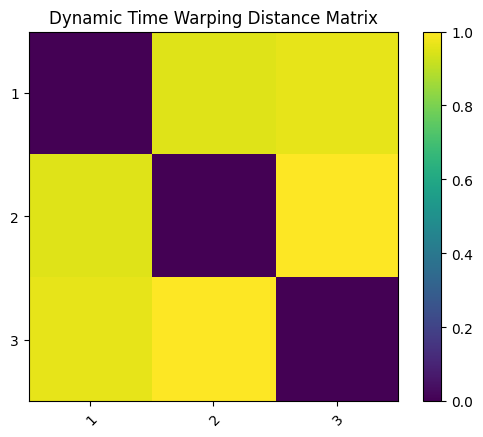

CPU times: user 1.01 s, sys: 3.22 s, total: 4.23 s
Wall time: 267 ms


In [116]:
%%time


# segments_audio
voc_segments = []

# segments_indexes
voc_segments_ix = []

#duration segments
duration_segments = []

# total_mfccs
mfccs = []

# total mel_filtered
mel_filtered = []

# spectrograms
specs = []



for name in file_info.loc[sample_fileIDs[:1]]['File name'].values:
    rate, data, start_times, end_times = get_wav_info(name)    
    
    y_filtered = butter_bandpass_filter(data)
    #y_filtered = data
    
    mfccs.extend(get_mfccs(y_filtered, rate, start_times, end_times))
    voc_segments.extend(get_segments_audio(y_filtered, rate, start_times, end_times))
    voc_segments_ix.extend(get_segments_ix(name, start_times, end_times))
    
    # too computational expensive?
    # mel_filtered.extend(get_mel_filterbanks(y_filtered, sr, start_times, end_times))
    
    segments, durations = get_segment_list(start_times, end_times)
    duration_segments.extend(durations)
    
    #specs.extend(get_segment_spectrogram(data, rate, start_times, end_times))
    
# mfcc OR mel_filtered ??
distances = dynamic_time_warping_by_mfcc(mfccs) 

# normalize
distances = np.array(distances)
distances_norm = (distances-np.min(distances))/(np.max(distances)-np.min(distances))
        
# corr_matrix
n = int(np.sqrt(len(distances_norm)))
distances_norm = distances_norm.reshape(n,n)

#distances = softmax(distances)

# Plot correlation matrix
import matplotlib.pyplot as plt
import numpy as np

fig, ax = plt.subplots()
im = ax.imshow(distances_norm)

# Set axis labels and ticks
ax.set_xticks(np.arange(len(mfccs)))
ax.set_yticks(np.arange(len(mfccs)))
ax.set_xticklabels(np.arange(1, len(mfccs)+1))
ax.set_yticklabels(np.arange(1, len(mfccs)+1))

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Set colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Show plot
plt.title('Dynamic Time Warping Distance Matrix')
plt.show()

In [ ]:
# multipyling by their time ??

mfccs = [mfccs[i] * duration_segments[i].T for i in range(len(mfccs))]

distances_time = dynamic_time_warping_by_mfcc(mfccs) 

# normalize
distances_time = np.array(distances_time)
distances_time_norm = (distances_time-np.min(distances_time))/(np.max(distances_time)-np.min(distances_time))
        
# corr_matrix
n = int(np.sqrt(len(distances_time_norm)))
distances_time_norm = distances_time_norm.reshape(n,n)

#distances = softmax(distances)

# Plot correlation matrix
import matplotlib.pyplot as plt
import numpy as np

fig, ax = plt.subplots()
im = ax.imshow(distances_time_norm)

# Set axis labels and ticks
ax.set_xticks(np.arange(len(mfccs)))
ax.set_yticks(np.arange(len(mfccs)))
ax.set_xticklabels(np.arange(1, len(mfccs)+1))
ax.set_yticklabels(np.arange(1, len(mfccs)+1))

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Set colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Show plot
plt.title('Dynamic Time Warping Distance Matrix')
plt.show()

In [ ]:
fig3, ax3 = plt.subplots()
ax3.set_title('Durations');
ax3.boxplot(duration_segments_norm)
plt.show()

In [173]:
import numpy as np
from sklearn.manifold import MDS
import matplotlib.pyplot as plt

# Use MDS to find a 2D representation of the distances
mds = MDS(n_components=2, dissimilarity='precomputed',  normalized_stress='auto')
pos = mds.fit_transform(distances)

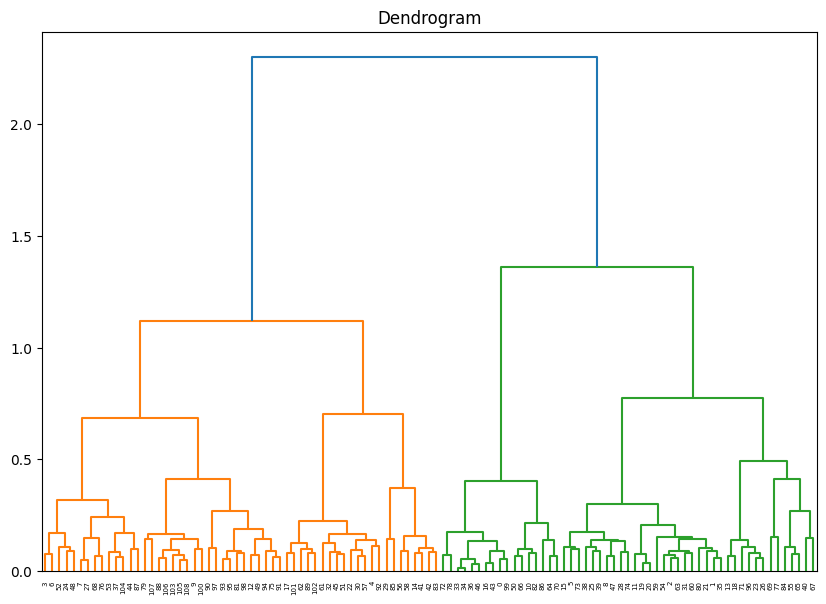

In [217]:
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from scipy.spatial.distance import squareform

# feeding directly the distances
ds = (ds-np.min(ds))/(np.max(ds)-np.min(ds))

condensed_dist = squareform(ds)

# Create dendrogram using hierarchical clustering
Z = linkage(condensed_dist, method='ward')
plt.figure(figsize=(10, 7))
plt.title("Dendrogram")

# Plot the dendrogram
dendrogram(Z, labels=None)
plt.show()

In [66]:
len(mfccs)

3452

In [227]:
t_step[index]

0.0

In [96]:
clusters_dendrogram

array([ 9, 12, 12,  1,  6, 11,  1,  2, 11,  3, 10, 12,  5, 13,  8, 11,  9,
        6, 13, 12, 12, 12,  6, 13,  1, 11, 13,  2, 11,  7,  6, 12,  6,  9,
        9, 12,  9,  2, 11, 11, 16,  8,  8,  9,  2,  6,  9, 11,  1,  5, 10,
        6,  1,  2, 12, 15,  8,  6,  8, 12, 12,  6,  6, 12, 10, 15, 10, 16,
        2, 14, 10, 13,  9, 11, 11,  5,  2, 14,  9,  3, 12,  5, 10,  8, 15,
        7, 10,  2,  3,  6,  4,  5,  6,  5,  5,  5, 13,  4,  5,  9,  3,  6,
        6,  3,  2,  3,  3,  3,  3], dtype=int32)

## Vocabulary of Syllables

In [ ]:
from IPython.display import HTML


# vocabulary using dendrogram

def voc_syllables(df, clusters):
    """
    Return 2 vocabularies:  voc_syllables_clusters, voc_syllables_clusters_ix
    
    voc_syllables_clusters:  voc of numpy audios
    voc_syllables_clusters_ix: voc of their Index in the DataFrame
    """

    voc_syllables_clusters = dict()
    voc_syllables_clusters_ix = dict()

    for i, s in enumerate(df['voc_segments']):
        c = clusters_dendrogram[i]
        if c in voc_syllables_clusters:
            voc_syllables_clusters[c].append(s)
            voc_syllables_clusters_ix[c].append(voc_segments_ix[i])
        else:
            voc_syllables_clusters[c] = [s]
            voc_syllables_clusters_ix[c] = [voc_segments_ix[i]]
        
# make a copy for comparison of clustering experiments
syllables_from_dendrograms_t = make_token(voc_syllables_clusters_ix.copy())

c = 3
[display(Audio(data = s, rate = 88200), HTML(f'{voc_syllables_clusters_ix[c][i]}')) for i, s in enumerate(voc_syllables_clusters[c])] 
   


In [56]:
t = 0.24

clusters_dendrogram = fcluster(Z, t, criterion='distance')

bars, freq = np.unique(clusters_dendrogram, return_counts=True)

In [ ]:
import pickle

  
store = {
    'classes' : classes,
    'voc_segments' : voc_segments,
    'duration_segments' : duration_segments,
    'mfccs' : mfccs,
    'distances' : distances,
    'distances_norm' : distances_norm
}


#with open('test.pkl','wb') as f:
#    pickle.dump(store, f)

In [75]:
with open('test.pkl','rb') as f:
    store = pickle.load(f)
    print(len(store))
    
classes = store['classes']
voc_segments = store['voc_segments']
voc_segments = store['voc_segments']
duration_segments = store['duration_segments']
mfccs = store['mfccs']
distances = store['distances']
distances_norm = store['distances_norm']

6


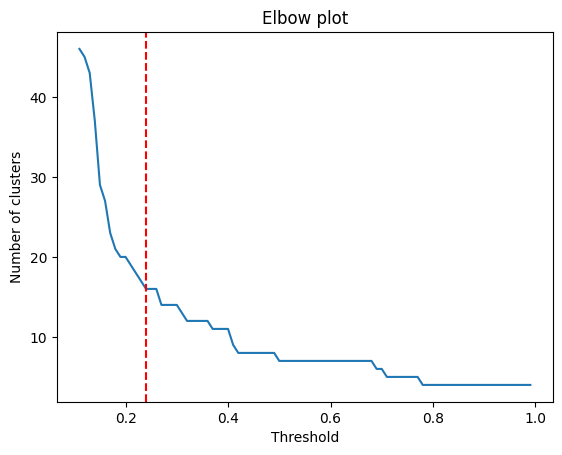

Elbow point:  (0.24, 16)


In [102]:
import numpy as np
from kneed import KneeLocator

t_step = np.arange(0, 1, .01)[11:]
c_size = [ len(np.unique(fcluster(Z, t, criterion='distance'))) for t in t_step]

# Find the elbow point using the KneeLocator function from the kneed library
kn = KneeLocator(t_step, c_size, curve='convex', direction='decreasing')

elbow_point = (kn.knee, kn.knee_y)

# plot the point
fig, ax = plt.subplots()
ax.plot(t_step, c_size)
ax.axvline(x=elbow_point[0], color='r', linestyle='--')
ax.set_xlabel('Threshold')
ax.set_ylabel('Number of clusters')
ax.set_title('Elbow plot')
plt.show()

print("Elbow point: ", elbow_point)

<BarContainer object of 16 artists>

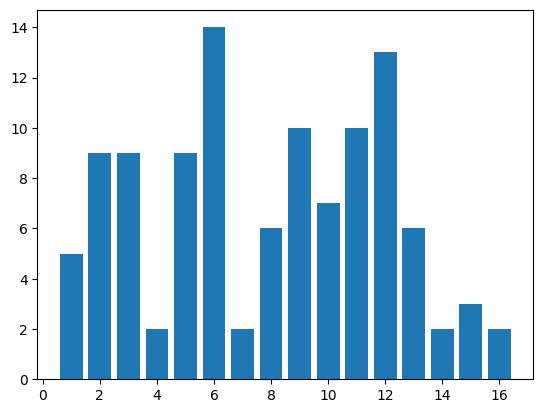

In [57]:
plt.bar(bars, freq)

(array([539., 399., 608., 287., 152., 232., 394., 369., 305., 412.]),
 array([ 1. ,  7.3, 13.6, 19.9, 26.2, 32.5, 38.8, 45.1, 51.4, 57.7, 64. ]),
 <BarContainer object of 10 artists>)

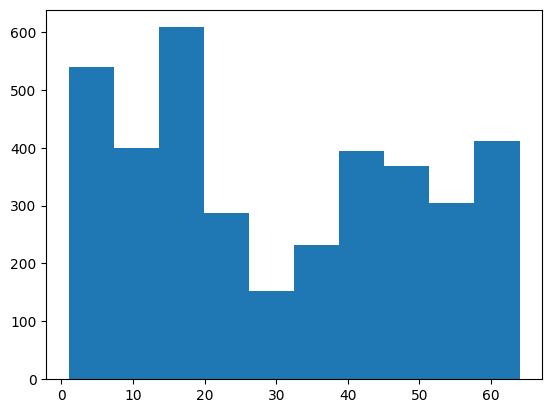

In [160]:
plt.hist(clusters_dendrogram, bins=10)

In [62]:
len(Z)

108

(array([1., 4., 1., 1., 2., 1., 3., 2., 0., 2.]),
 array([ 0. ,  1.4,  2.8,  4.2,  5.6,  7. ,  8.4,  9.8, 11.2, 12.6, 14. ]),
 <BarContainer object of 10 artists>)

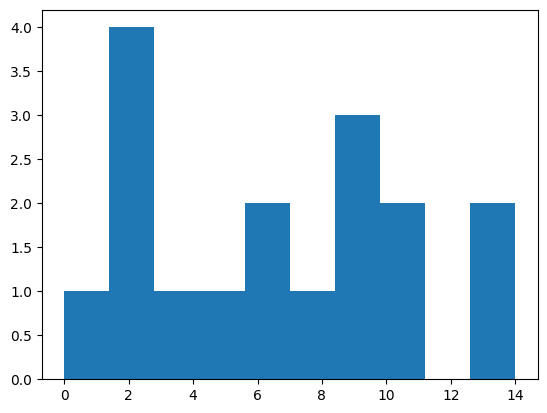

In [58]:
# this shows how many segments per syllables
plt.hist(np.bincount(clusters_dendrogram))

In [20]:
# trying to find clusters with hdbscan
# https://towardsdatascience.com/clustering-sentence-embeddings-to-identify-intents-in-short-text-48d22d3bf02e

In [76]:
import hdbscan

In [77]:
def pad_right(mfccs):
    # Determine the length of the longest MFCC
    max_len = max(len(mfcc[0]) for mfcc in mfccs)

    # Initialize array for padded/truncated MFCCs
    mfccs_fixed = np.zeros((len(mfccs), 20, max_len))

    # Pad or truncate MFCCs to fixed length
    for i, mfcc in enumerate(mfccs):
        if mfcc.shape[1] < max_len:
            # Pad MFCC with zeros
            mfccs_fixed[i, :, :mfcc.shape[1]] = mfcc
        #else:
        #    # Truncate MFCC
        #    mfccs_fixed[i, :, :] = mfcc[:, :max_len]
    return mfccs_fixed

In [78]:
def generate_clusters(message_embeddings,
                      n_neighbors,
                      n_components, 
                      min_cluster_size,
                      random_state = None):
    """
    Generate HDBSCAN cluster object after reducing embedding dimensionality with UMAP
    """

    umap_embeddings = (umap.UMAP(n_neighbors=n_neighbors, 
                                n_components=n_components, 
                                metric='cosine', 
                                random_state=random_state)
                            .fit_transform(message_embeddings))

    clusters = hdbscan.HDBSCAN(min_cluster_size = min_cluster_size,
                               metric='euclidean', 
                               cluster_selection_method='eom').fit(umap_embeddings)

    return clusters

In [79]:
def score_clusters(clusters, prob_threshold = 0.05):
    """
    Returns the label count and cost of a given cluster supplied from running hdbscan
    """
    
    cluster_labels = clusters.labels_
    label_count = len(np.unique(cluster_labels))
    total_num = len(clusters.labels_)
    cost = (np.count_nonzero(clusters.probabilities_ < prob_threshold)/total_num)
    
    return label_count, cost

In [93]:
import random 
def random_search(embeddings, space, num_evals):
    """
    Randomly search hyperparameter space and limited number of times 
    and return a summary of the results
    """
    
    results = []
    
    for i in range(num_evals):
        n_neighbors = random.choice(space['n_neighbors'])
        n_components = random.choice(space['n_components'])
        min_cluster_size = random.choice(space['min_cluster_size'])
        
        clusters = generate_clusters(embeddings, 
                                     n_neighbors = n_neighbors, 
                                     n_components = n_components, 
                                     min_cluster_size = min_cluster_size, 
                                     random_state = 42)
    
        label_count, cost = score_clusters(clusters, prob_threshold = 0.05)
                
        results.append([i, n_neighbors, n_components, min_cluster_size, 
                        label_count, cost])
    
    result_df = pd.DataFrame(results, columns=['run_id', 'n_neighbors', 'n_components', 
                                               'min_cluster_size', 'label_count', 'cost'])
    
    return result_df.sort_values(by='cost')

In [94]:
space = {
    'n_neighbors' : np.arange(12, 16,1),
    'n_components' : np.arange(2,5, 1),
    'min_cluster_size': np.arange(2, 16, 1),
    'random_state':42
}

In [95]:
# padded 
mfccs_fixed = pad_right(mfccs)

# Convert mfccs to a 2D array, skip first component
mfccs_flat = np.array([mfcc[0:].flatten() for mfcc in mfccs_fixed] )

In [96]:
random_use = random_search(mfccs_flat, space, 10)

In [97]:
random_use.head()

,run_id,n_neighbors,n_components,min_cluster_size,label_count,cost
4,4,13,4,5,197,0.060545
7,7,14,2,6,187,0.061414
8,8,12,4,7,177,0.061414
9,9,14,2,5,201,0.061703
0,0,13,2,6,188,0.064021


In [98]:
#use baysian optimisation to tune hyperparameters

def objective(params, embeddings, label_lower, label_upper):
    """
    Objective function for hyperopt to minimize, which incorporates constraints
    on the number of clusters we want to identify
    """
    
    clusters = generate_clusters(embeddings, 
                                 n_neighbors = params['n_neighbors'], 
                                 n_components = params['n_components'], 
                                 min_cluster_size = params['min_cluster_size'],
                                 random_state = params['random_state'])
    
    label_count, cost = score_clusters(clusters, prob_threshold = 0.05)
    
    #15% penalty on the cost function if outside the desired range of groups
    if (label_count < label_lower) | (label_count > label_upper):
        penalty = 0.15 
    else:
        penalty = 0
    
    loss = cost + penalty
    
    return {'loss': loss, 'label_count': label_count, 'status': STATUS_OK}

In [99]:
# Tree-Structured Parzen Estimator

def bayesian_search(embeddings, space, label_lower, label_upper, max_evals=100):
    """
    Perform bayseian search on hyperopt hyperparameter space to minimize objective function
    """
    
    trials = Trials()
    fmin_objective = partial(objective, embeddings=embeddings, label_lower=label_lower, label_upper=label_upper)
    best = fmin(fmin_objective, 
                space = space, 
                algo=tpe.suggest,
                max_evals=max_evals, 
                trials=trials)

    best_params = space_eval(space, best)
    print ('best:')
    print (best_params)
    print (f"label count: {trials.best_trial['result']['label_count']}")
    
    best_clusters = generate_clusters(embeddings, 
                                      n_neighbors = best_params['n_neighbors'], 
                                      n_components = best_params['n_components'], 
                                      min_cluster_size = best_params['min_cluster_size'],
                                      random_state = best_params['random_state'])
    
    return best_params, best_clusters, trials

In [100]:
hspace =  {
    'n_neighbors' : hp.choice( 'n_neighbors', np.arange(15, 50, 1)),
    'n_components' : hp.choice( 'n_components', np.arange(2, 5, 1)),
    'min_cluster_size': hp.choice( 'min_cluster_size', np.arange(2, 30, 1)),
    'random_state':42
}

best_params, best_clusters, trials = bayesian_search(mfccs_flat, hspace, 30, 100, max_evals=10)



TypeError: 'int' object is not callable

In [38]:
clusters = generate_clusters(mfccs_flat, 
                                     n_neighbors = 13, 
                                     n_components = 2, 
                                     min_cluster_size = 4, 
                                     random_state = 42)

In [101]:
# Dimensionality reduction with UMAP
reducer = umap.UMAP(n_components = 2, n_neighbors=13, min_dist=1, random_state=42, metric='euclidean')

# embedding
embedding = reducer.fit_transform(mfccs_flat)

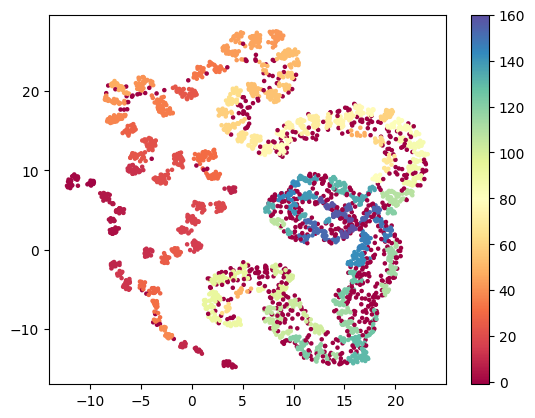

In [111]:
# Cluster the UMAP embedding using HDBSCAN
clusterer = hdbscan.HDBSCAN(min_cluster_size=5)
clusters_hdbscan_over_umap = clusterer.fit_predict(embedding)

# Visualize the clusters in the UMAP embedding
plt.scatter(embedding[:, 0], embedding[:, 1], c=clusterer.labels_, cmap='Spectral', s=5)
plt.colorbar()
plt.show()

In [110]:
np.unique(clusterer.labels_)

array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
        12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
        25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
        38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
        51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
        64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
        77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
        90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
       103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
       116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
       129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
       142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
       155, 156, 157, 158, 159, 160])

In [491]:
np.unique(cluster_labels).shape

NameError: name 'cluster_labels' is not defined

In [42]:
len(np.unique(cluster_labels))

48

(array([161.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   1.]),
 array([  5. ,  77.4, 149.8, 222.2, 294.6, 367. , 439.4, 511.8, 584.2,
        656.6, 729. ]),
 <BarContainer object of 10 artists>)

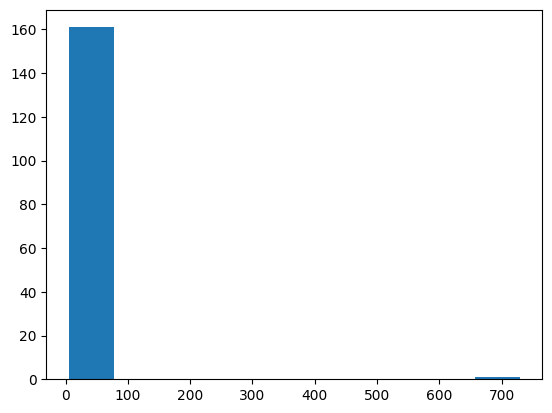

In [112]:
clusters_hdbscan_over_umap_2  = clusters_hdbscan_over_umap + 1
plt.hist(np.bincount(clusters_hdbscan_over_umap_2))

In [524]:
#hdbscan over umap, VS dendrograms using elbow
np.unique(clusters_hdbscan_over_umap), np.unique(clusters_dendrogram)

(array([0, 1]),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15],
       dtype=int32))

In [493]:
np.bincount(clusters_hdbscan_over_umap_2), np.bincount(clusters_dendrogram)

NameError: name 'clusters_hdbscan_over_umap_2' is not defined

In [125]:
# TODO
# check this sound
#('files203', '121029231456383416.WAV', 3, 379841, 398245)

In [113]:
def make_token(syllables_dictionary):
    d = {}
    for k in syllables_dictionary:
        tuples = syllables_dictionary[k]
        new_tuples = []
        for t in tuples:
            new_tuples.append( ' '.join(map(str,t)))
                
        d.update({k : new_tuples})
    return d

In [114]:
voc_syllables_clusters.keys()

NameError: name 'voc_syllables_clusters' is not defined

In [234]:
from IPython.display import HTML
# vocabulary using dendrogram
#assert len(voc_segments) == len(voc_segments_ix)

voc_syllables_clusters = dict()
voc_syllables_clusters_ix = dict()

for i, s in enumerate(voc_segments):
    c = clusters_dendrogram[i]
    if c in voc_syllables_clusters:
        voc_syllables_clusters[c].append(s)
        voc_syllables_clusters_ix[c].append(voc_segments_ix[i])
    else:
        voc_syllables_clusters[c] = [s]
        voc_syllables_clusters_ix[c] = [voc_segments_ix[i]]
        
# make a copy for comparison of clustering experiments
syllables_from_dendrograms_t = make_token(voc_syllables_clusters_ix.copy())

c = 3
[display(Audio(data = s, rate = 88200), HTML(f'{voc_syllables_clusters_ix[c][i]}')) for i, s in enumerate(voc_syllables_clusters[c])] 
   


NameError: name 'voc_segments' is not defined

In [286]:
len(voc_segments_ix)

3697

In [123]:
from IPython.display import HTML
# vocabulary using hdscan umap
#assert len(voc_segments) == len(voc_segments_ix)

voc_syllables_clusters = dict()
voc_syllables_clusters_ix = dict()

for i, s in enumerate(voc_segments):
    c = clusters_hdbscan_over_umap[i]
    if c in voc_syllables_clusters:
        voc_syllables_clusters[c].append(s)
        voc_syllables_clusters_ix[c].append(voc_segments_ix[i])
    else:
        voc_syllables_clusters[c] = [s]
        voc_syllables_clusters_ix[c] = [voc_segments_ix[i]]

        
# make a copy for comparison of clustering experiments
syllables_from_hdbscan_over_umap_t = make_token(voc_syllables_clusters_ix.copy())

c = 1
[display(Audio(data = s, rate = 88200), HTML(f'{voc_syllables_clusters_ix[c][i]}')) for i, s in enumerate(voc_syllables_clusters[c])] 
                                             

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [75]:
#syllables_from_dendrograms = voc_syllables_clusters_ix.copy()

#syllables_from_dendrograms_t = make_token(voc_syllables_clusters_ix.copy())

#syllables_from_hdbscan_over_umap_t = make_token(voc_syllables_clusters_ix.copy())
#syllables_from_dendrograms_t = syllables_from_dendrograms_bkp.copy()
#syllables_from_hdbscan_over_umap_t = syllables_from_hdbscan_over_umap_bkp.copy()


In [537]:
# Compare the two approaches for clustering, if they are more or less equivalent

from itertools import product
from sklearn.metrics import jaccard_score, adjusted_rand_score, normalized_mutual_info_score, adjusted_mutual_info_score

A = syllables_from_dendrograms_t
B = syllables_from_hdbscan_over_umap_t


# Get all pairwise combinations of clusters in A and B
combinations = list(product(A.values(), B.values()))

max_element_in_clusters = max([len(A), len(B)])

comparison_matrix = np.zeros((max_element_in_clusters, max_element_in_clusters))


# Calculate ARI for each combination and print the results
for i, (a, b) in enumerate(combinations):
    
    tmp_a = a.copy()
    tmp_b = b.copy()
    
    # Find length of longer list
    max_len = max(len(tmp_a), len(tmp_b))

    # Pad list1 with None values
    
    while len(tmp_a) < max_len:
        tmp_a.append('XXX')

    # Pad list2 with None values
    
    while len(tmp_b) < max_len:
        tmp_b.append('YYY')
        
    
    #jcs = jaccard_score(tmp_a, tmp_b, average = 'micro')
    jcc = len(set(a).intersection(b)) / len(set(a).union(b))
    
    #ari = adjusted_rand_score(tmp_a, tmp_b)
    del tmp_a
    del tmp_b
    
    #nmi = normalized_mutual_info_score(a, b)
    #ami = adjusted_mutual_info_score(a, b)
    #print(f"ARI between A cluster {i//len(B)+1} and B cluster {i%len(B)+1}: {ari}")
    #print(f"NMI between A cluster {i//len(B)+1} and B cluster {i%len(B)+1}: {nmi}")
    #print(f"AMI between A cluster {i//len(B)+1} and B cluster {i%len(B)+1}: {ami}")
    comparison_matrix[-1 + i//len(B)+1][-1 + i%len(B)+1] = jcc

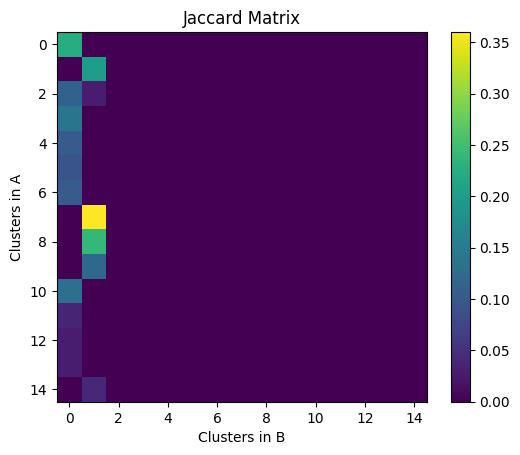

In [538]:
# Create a heatmap of the matrix
fig, ax = plt.subplots()
im = ax.imshow(comparison_matrix, cmap='viridis')

# Add colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Set axis labels
#ax.set_xticks(np.arange(n))
#ax.set_yticks(np.arange(n))
#ax.set_xticklabels(np.arange(1, n+1))
#ax.set_yticklabels(np.arange(1, n+1))
ax.set_xlabel('Clusters in B')
ax.set_ylabel('Clusters in A')

# Rotate the tick labels and set their alignment
#plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Loop over data dimensions and create text annotations
#n = len(ari_matrix)
#for i in range(n):
#    for j in range(n):
#        text = ax.text(j, i, f'{ari_matrix[i, j]:.2f}', ha="center", va="center", color="w")

# Set title and show plot
ax.set_title("Jaccard Matrix")
#fig.tight_layout()
plt.show()

In [98]:
# padded 
mfccs_fixed = pad_right(mfccs)

# Convert mfccs to a 2D array, skip first component
mfccs_flat = np.array([mfcc[0:].flatten() for mfcc in mfccs_fixed] )

# Dimensionality reduction with UMAP
#reducer = umap.UMAP(n_components = 5, n_neighbors=15, min_dist=0.1, random_state=42, metric='euclidean')

# embedding
#embedding = reducer.fit_transform(mfccs_flat)

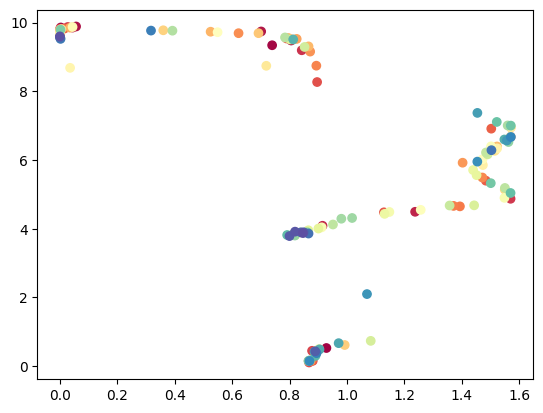

In [540]:
#https://umap-learn.readthedocs.io/en/latest/embedding_space.html

gaussian_mapper = umap.UMAP(output_metric='gaussian_energy',
                            n_components=2,
                            random_state=42).fit(mfccs_flat)

plt.scatter(gaussian_mapper.embedding_.T[0], gaussian_mapper.embedding_.T[1], c=[i for i, _ in enumerate(np.array(classes))], cmap='Spectral')
                                   

In [ ]:
reducer = umap.UMAP(n_components = 2, n_neighbors=15, min_dist=1., random_state=42,  metric='euclidean')
mapper = reducer.fit(mfccs_flat)
embedding = reducer.fit_transform(mfccs_flat)
umap.plot.points(mapper, labels= np.array(classes))

# Transitions

In [190]:
import networkx as nx

for i, row in symbolic_sequences.iterrows():
    seq = row['Seq_Syllables']
    filename = row['File name']
    if 46 in seq:
        print(filename, '\n', seq)

121014215253336381.WAV 
 [144, 147, 69, 145, 46, 49]
121207175754068173.WAV 
 [45, 24, 150, 32, 46, 45, 137, 158, 40, 161, 45, 43, 49, 17, 40, 45, 137, 137, 19, 49, 137, 13, 45, 40, 3, 147, 45, 44, 49, 19, 150, 13, 69]
121209010250178680.WAV 
 [72, 48, 13, 13, 73, 48, 65, 13, 20, 48, 49, 48, 48, 169, 2, 48, 147, 48, 147, 147, 147, 2, 2, 48, 168, 13, 37, 42, 6, 42, 21, 5, 109, 28, 45, 37, 37, 5, 33, 21, 46, 20, 109, 49, 131, 27, 140, 72, 159, 143, 75, 155, 171, 126, 37, 48, 13, 37, 40, 44]
121209020825515892.WAV 
 [147, 30, 144, 45, 40, 3, 45, 48, 147, 48, 40, 48, 45, 2, 171, 45, 147, 137, 40, 45, 95, 60, 19, 70, 126, 46, 70, 45, 66, 168, 45, 13, 40, 69, 53, 135, 66, 6, 12, 15, 22, 37, 36, 66, 138, 40]
121210020853639687.WAV 
 [3, 2, 45, 45, 48, 45, 44, 22, 72, 49, 49, 49, 45, 49, 3, 45, 49, 49, 72, 174, 46, 143, 157, 24, 139, 30, 169, 72, 169, 45, 74, 156, 44, 49, 3, 45, 67, 45, 114, 47, 30, 49, 13, 137, 137, 47, 18, 149, 112, 24, 11, 69, 3, 3]
121210025620210780.WAV 
 [149, 69, 45, 45

In [98]:
import networkx as nx

def make_graph_transitions(df, degree_type = 'out_degree'):
    """
    Input: df of symbolic sequences
    Output: graph of transitions
    transition probability as: 
    P(y|x) = 1 / out_degree(x) 
    """

    # Create a dictionary to count the items and transitions
    item_counts = {}
    transition_counts = {}

    # Iterate over the sequences and update the counts
    for seq in df['Seq_Syllables']:
        for i, item in enumerate(seq):
            # Update item counts
            if item not in item_counts:
                item_counts[item] = 1
            else:
                item_counts[item] += 1

            # Update transition counts
            if i > 0:
                transition = (seq[i-1], item)
                if transition not in transition_counts:
                    transition_counts[transition] = 1
                else:
                    transition_counts[transition] += 1

    # Create a directed graph using NetworkX
    G = nx.DiGraph()

    # Add nodes with sizes proportional to their counts
    for item, count in item_counts.items():
        G.add_node(item, size=count)

    # Add edges with weights reflecting frequences  
    for transition, freq in transition_counts.items():
        G.add_edge(*transition, weight=freq )

    # normalise using transition probability 
    for u, v, w in G.edges(data='weight'):
        
        # degree verse                   
        verse_degree = G.out_degree(u) if degree_type == 'out_degree' else G.in_degree(u)
        if verse_degree > 0:
            G[u][v]['p'] = 1 / verse_degree
            
    return G
        
    
def plot_graph_transitions(G, subtitle = ''):
    # Decoration properties

    # nodes
    # node_sizes = [count * 10 for count in item_counts.values()]
    node_sizes = { node : G.out_degree(node) for node in G.nodes() }
    nx.set_node_attributes(G, node_sizes, 'node_size')

    # edges
    """
    helper function to render width between [chosen_min, chosen_max]
    freqs  = [freq for u, v, freq in G.edges(data='weight')]
    max_freq = max(freqs)
    min_freq = min(freqs)
    
    
    def transform_edge_width(value, chosen_max=1, chosen_min=0.1, max_freq=max_freq, min_freq=min_freq):
        a = (chosen_max - chosen_min)/(max_freq - min_freq)
        b = max_freq - a * max_freq
        print(max_freq, min_freq, a, b, value, a * value + b)
        #return a * value + b
        return (chosen_max - chosen_min)/(max_freq - min_freq) * (value - max_freq) + chosen_max
    """
    edge_widths = {(u, v): w for u, v, w in G.edges(data='p')}
    edge_colors = {(u, v): (0.1, 0.1, 0.1, w/10 + 0.3) for u, v, w in G.edges(data='p')}
    
    nx.set_edge_attributes(G, edge_colors, 'edge_color')
    nx.set_edge_attributes(G, edge_widths, 'edge_width')

    # Create a layout for the graph
    #pos = nx.spring_layout(G, k=0.3)
    pos = nx.spring_layout(G, k = 10) # large graphs



    # props

    node_sizes = [n[1]['size'] / 10 for n in G.nodes(data=True)]
    node_sizes = [n[1]['size']  for n in G.nodes(data=True)]
    edge_widths = [np.log(e[2]['edge_width']) / 10 for e in G.edges(data=True)]
    edge_colors = [e[2]['edge_color'] for e in G.edges(data=True)]


    # Draw the nodes with sizes proportional to their counts
    
    color_map = []
    for node in G:
        if node < 0:
            color_map.append('grey')
        else: 
            color_map.append('lightblue') 
    
    nx.draw_networkx_nodes(G, pos, 
                           node_size=node_sizes, 
                           node_color=color_map,
                           edgecolors = 'lightgray')

    nx.draw_networkx_edges(G, pos, 
                           width = edge_widths, 
                           edge_color = edge_colors, 
                           arrowsize=10)

    # Draw labels for the nodes
    nx.draw_networkx_labels(G, pos, font_size=8, font_family='sans-serif')

    # Remove the axis
    plt.axis('off')
    plt.title(f'Syllabic Transitions Graph { subtitle}')

    # Show the plot
    plt.show()

In [346]:
##### THIS PART IS ONLY TEMPORARY TO CHECKK ALLL THE BATS! ####

In [348]:
#{'lightblue' : n[0] for n in G.nodes(data=True) if n[0] != -1}

In [97]:
graph_trans = make_graph_transitions(symbolic_sequences, degree_type = 'in_degree')
plot_graph_transitions(graph_trans, subtitle ="\n(Qt-ward alphabet, Bat #215)")

AttributeError: 'MultiGraph' object has no attribute 'in_degree'

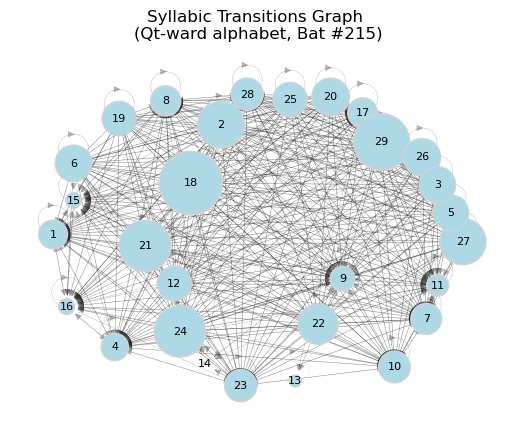

In [11]:
graph_trans = make_graph_transitions(symbolic_sequences)
plot_graph_transitions(graph_trans, subtitle ="\n(Qt-ward alphabet, Bat #215)")

In [106]:
symbolic_sequences['Seq_Syllables'].loc[symbolic_sequences['Seq_Syllables'].apply(lambda x : 13 in x and len(x) > 1)]

0                         [13, 13]
1                         [13, 13]
3                     [13, 13, 13]
5                         [13, 13]
7                     [13, 13, 13]
14                    [13, 13, 13]
16                    [13, 13, 13]
18    [13, 13, 13, 13, 13, 13, 13]
19                [13, 13, 13, 13]
21                    [13, 13, 19]
27                        [13, 19]
29                    [13, 13, 13]
30                        [13, 13]
31                        [13, 13]
40                [13, 13, 22, 13]
44                        [13, 13]
46                        [17, 13]
50                        [13, 19]
Name: Seq_Syllables, dtype: object

In [270]:
import itertools
import networkx as nx


def make_graph_bat(df):

    G = nx.DiGraph()

    for seq in df['Seq_Syllables']:
        for edge in itertools.pairwise(seq):
            if G.has_edge(*edge):
                # if the edge already exists, increase the weight
                G[edge[0]][edge[1]]['weight'] += 1
            else:
                # otherwise, add the edge with weight = 1
                G.add_edge(*edge, weight=1)
                
    return G


graph_bat = make_graph_bat(symbolic_sequences)

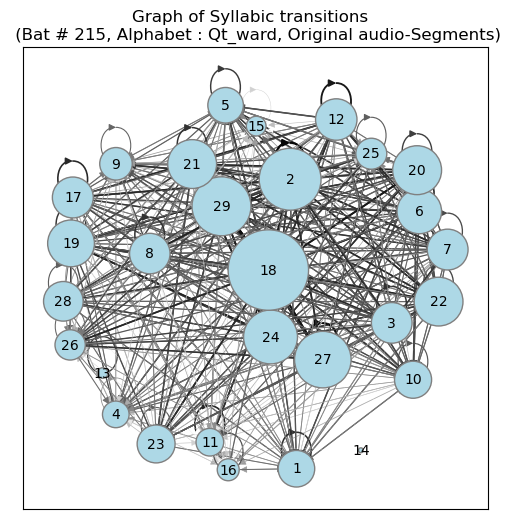

In [311]:
import matplotlib.pyplot as plt


def plot_graph_bat(G, subtitle = ''):
    """
    G is a DiGraph()
    NOTE: Paralellel edges are counted on 'weight' edge attribute
    
    """


    # Calculate in-degrees
    in_degrees = dict(G.in_degree(weight='weight'))

    # Calculate out-degrees
    out_degrees = dict(G.out_degree(weight='weight'))


    # Aestehtics
    colors = []
    node_sizes = []

    for node in G.nodes:
        if node != -1:
            colors.append('lightblue')
            node_sizes.append(in_degrees[node] * 2)  
        else:
            colors.append('lightgray')
            node_sizes.append(out_degrees[node] * 2)

    edge_widths = collections.Counter(G.edges)
    edge_widths = [  (np.log(edge_widths[e]['weight']**3 +1))/10 for e in edge_widths]
    edge_colors = np.round(np.tanh(edge_widths),2)*100



    # Draw the graph

    plt.figure(figsize=(6, 6))  
    pos = nx.spring_layout(G, k = 10) # use K large for large graph
    nx.draw_networkx_nodes(G, pos, node_color=colors, node_size=node_sizes, linewidths = 1, edgecolors = 'gray')
    nx.draw_networkx_edges(G, pos, width = edge_widths, edge_color= edge_colors, edge_cmap = plt.cm.Greys, arrowsize=10)
    nx.draw_networkx_labels(G, pos, font_size=10, font_family='sans-serif')

    plt.title(f'Graph of Syllabic transitions {subtitle} \n (Bat # 215, Alphabet : Qt_ward, Original audio-Segments)', fontsize=12)

    plt.show()
    
    
plot_graph_bat(graph_bat)

In [177]:
# Transition probabilities
transition_probabilities = {}
for edge in graph_bat.edges(data=True):
    transition_probabilities[edge[0], edge[1]] = edge[2]['weight'] / out_degrees[edge[0]]

# Conditional probabilities
conditional_probabilities = {}
for edge in graph_bat.edges(data=True):
    conditional_probabilities[edge[0], edge[1]] = edge[2]['weight'] / in_degrees[edge[1]]

In [217]:
symbolic_sequences.groupby('context').size()

context
2      292
3       96
4       50
5       48
6       78
7       48
8        1
9      629
10      46
11     627
12    4164
dtype: int64

In [151]:
degrees = {'in_degree' : sorted([v for k, v in in_degrees.items()]), 'out_degree' :sorted([v for k, v in out_degrees.items()]) }

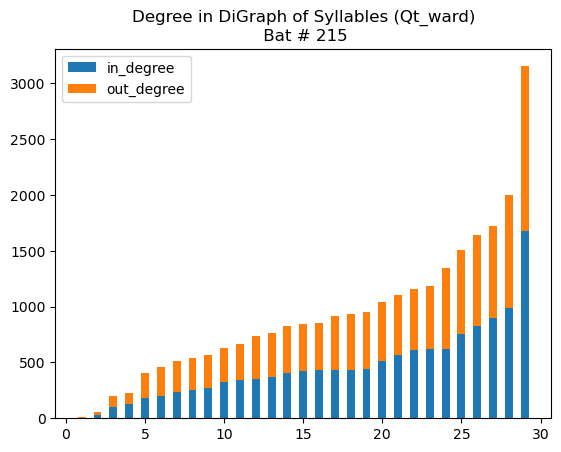

In [160]:
fig, ax = plt.subplots()
bottom = np.zeros(29)

for degree, degree_count in degrees.items():
    p = ax.bar(sorted(graph_trans.nodes), degree_count, 0.5, label=degree, bottom=bottom)
    bottom += degree_count

    #ax.bar_label(p, label_type='center')
    
ax.set_title(f'Degree in DiGraph of Syllables (Qt_ward)\n Bat # 215')
ax.legend()


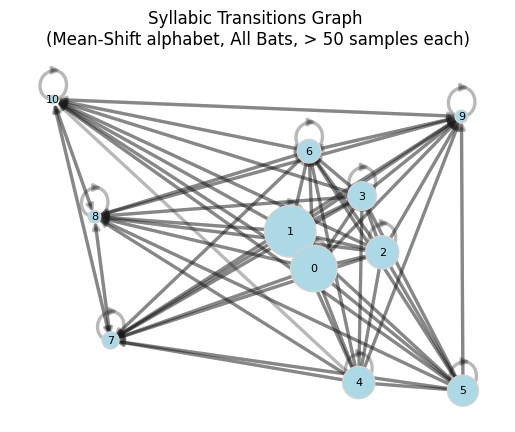

In [1977]:
graph_trans = make_graph_transitions(symbolic_sequences)
plot_graph_transitions(graph_trans, subtitle ="\n(Mean-Shift alphabet, All Bats)")

In [208]:
nx.sigma(graph_bat.to_undirected())

1.0000000000000004

In [209]:
nx.omega(graph_bat.to_undirected())

3.3306690738754696e-16

In [295]:
#!pip install python-louvain

In [315]:
import networkx as nx
import community # you might need to install this package if not already installed (pip install python-louvain)


def graph_complexity_stats(G):

        # Diameter
    diameter = nx.diameter(G)

    # Density
    density = nx.density(G)

    # Average Clustering Coefficient
    avg_clustering_coeff = nx.average_clustering(G)

    # Modularity
    # First find the best partition
    partition = community.best_partition(G.to_undirected())
    # Then compute the modularity
    modularity = community.modularity(partition, G.to_undirected())

    # Largest clique
    big_clique = nx.graph_clique_number(G.to_undirected()) 
    
    #all clique
    all_clique = nx.find_cliques(G.to_undirected()) 
    
    return {
        'diameter' : diameter,
        'density' : density,
        'avg_clustering_coeff' : avg_clustering_coeff,
        'modularity' : modularity,
        'big_clique' : big_clique,
        'all_clique' : len(list(all_clique)),
        'top_5_betweenness_centrality': collections.Counter(nx.betweenness_centrality(G, normalized=True, weight = 'weight')).most_common()[:5]
    }

In [309]:
graph_complexity_stats(graph_bat);

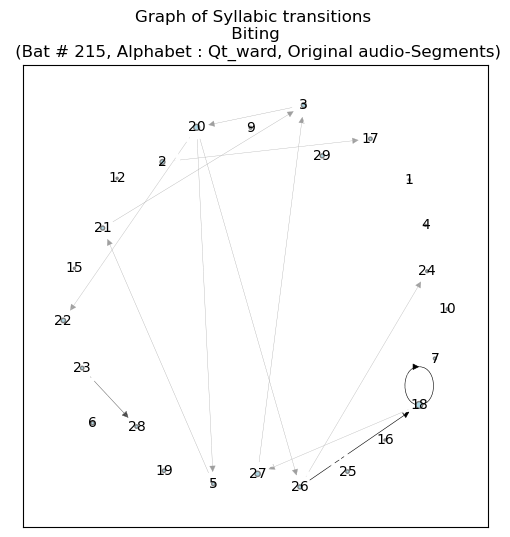

1.0000000000000004
3.3306690738754696e-16
Graph disconnected


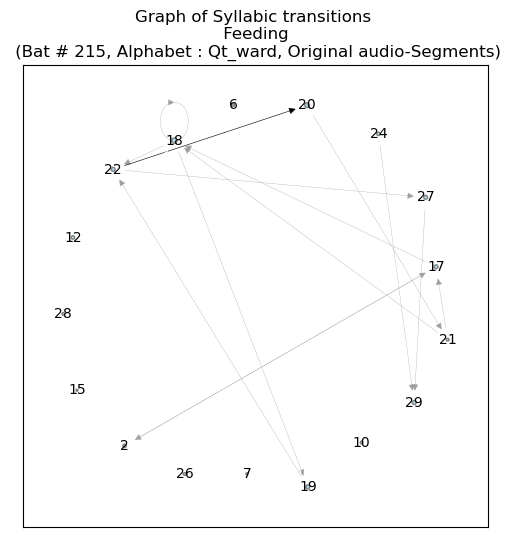

1.0000000000000004
3.3306690738754696e-16
{'diameter': 8, 'density': 0.13970588235294118, 'avg_clustering_coeff': 0.1424100409394527, 'modularity': 0.3792169929196168, 'big_clique': 3, 'all_clique': 21, 'top_5_betweenness_centrality': [(20, 0.3520833333333333), (28, 0.3375), (18, 0.3208333333333333), (27, 0.2520833333333333), (10, 0.21041666666666667)]}


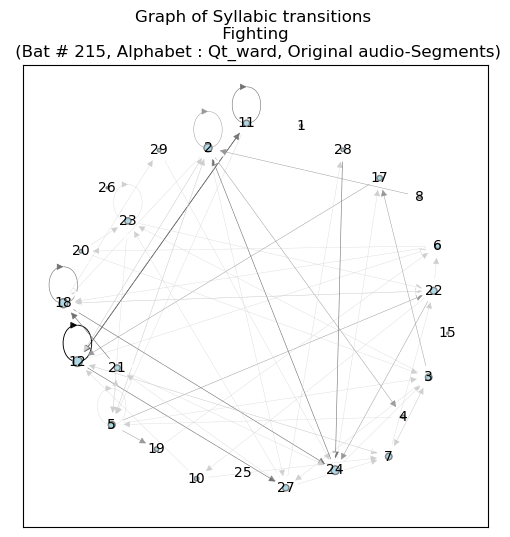

1.0000000000000004
0.00012916439860166662
Graph disconnected


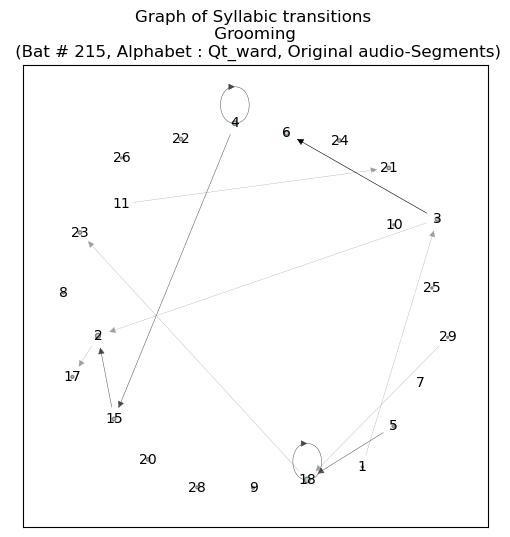

1.0000000000000004
3.3306690738754696e-16
Graph disconnected


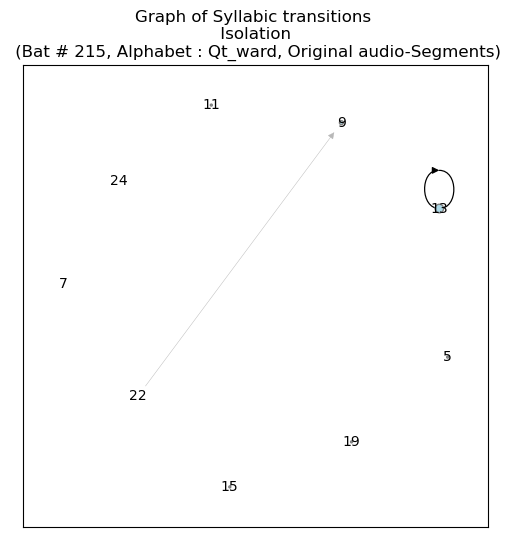

1.0000000000000004
3.3306690738754696e-16
Graph disconnected


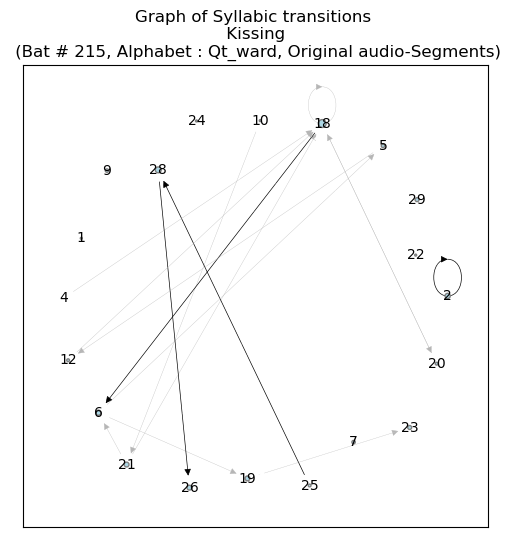

1.0000000000000004
3.3306690738754696e-16
Graph disconnected


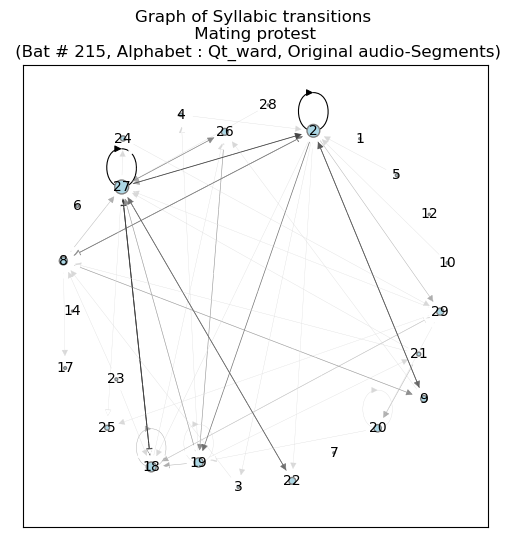

1.0000000000000004
3.3306690738754696e-16
Graph disconnected


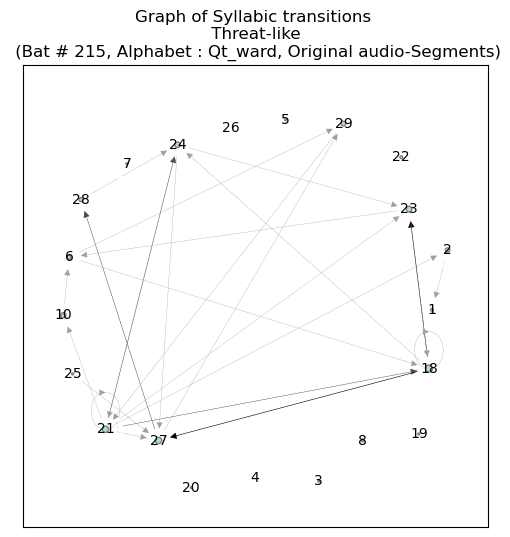

1.0000000000000004


In [ ]:
# plot graphs for context-type 
for context in [2,3,4,5,6,7,9,10]:    
    test_context = context
    test_ix = symbolic_sequences.context.explode()[symbolic_sequences.context.explode() == test_context].index.values
    
    #graph_trans = make_graph_transitions(symbolic_sequences.loc[test_ix])
    
    #plot_graph_transitions(graph_trans, subtitle = f'\n((Mean-Shift alphabet, All Bats, Context {context_dict[context]})')
    
    graph_bat_context = make_graph_bat ( symbolic_sequences.loc[test_ix].sample(n = 50, replace=True))
    plot_graph_bat(graph_bat_context, subtitle = f'\n {context_dict[context]}')
    
    
    
    try:
        print(nx.sigma(graph_bat.to_undirected()))
        print(nx.omega(graph_bat.to_undirected()))
        
    except:
        print('Graph disconnected ?')
    
    try:
        print(graph_complexity_stats(graph_bat_context))
    except:
        print('Graph disconnected ?')
    

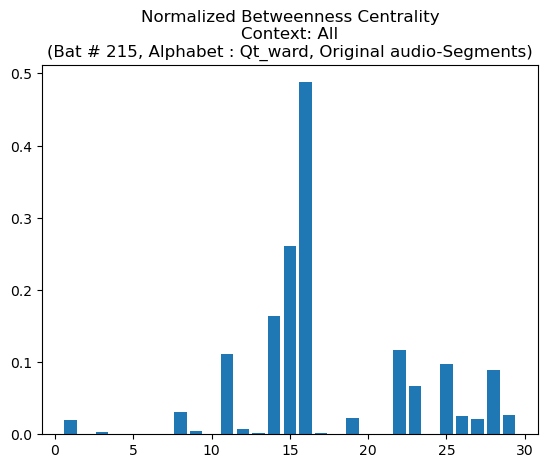

In [283]:
def plot_graph_centralities(G):
    centrality = collections.Counter(nx.betweenness_centrality(G, normalized=True, weight = 'weight')).most_common()
    nodes, values = zip(*centrality)
    plt.bar(nodes, values, width = 0.8)
    plt.title(f'Normalized Betweenness Centrality\nContext: All\n(Bat # 215, Alphabet : Qt_ward, Original audio-Segments)')
    
plot_graph_centralities(graph_bat)

In [287]:
collections.Counter(nx.degree_centrality(graph_bat)).most_common()

[(19, 2.0357142857142856),
 (22, 2.0357142857142856),
 (3, 2.0),
 (2, 1.9642857142857142),
 (23, 1.9642857142857142),
 (8, 1.9642857142857142),
 (17, 1.9285714285714284),
 (7, 1.9285714285714284),
 (9, 1.9285714285714284),
 (24, 1.9285714285714284),
 (10, 1.9285714285714284),
 (29, 1.9285714285714284),
 (18, 1.9285714285714284),
 (21, 1.9285714285714284),
 (28, 1.9285714285714284),
 (6, 1.8928571428571428),
 (5, 1.8928571428571428),
 (20, 1.8928571428571428),
 (12, 1.8928571428571428),
 (1, 1.8928571428571428),
 (27, 1.857142857142857),
 (4, 1.857142857142857),
 (25, 1.857142857142857),
 (26, 1.857142857142857),
 (15, 1.7142857142857142),
 (11, 1.6785714285714284),
 (16, 1.6428571428571428),
 (14, 0.39285714285714285),
 (13, 0.21428571428571427)]

In [292]:
symbolic_sequences.loc[symbolic_sequences['Seq_Syllables'].apply(lambda x : 16 in x)].sample()

,File name,Seq_Syllables,Seq_Syllables_ix,Pos_Segment,Duration,Folder,FileID,Emitter,label_addressee,label_context,context,addressee
2367,130228053727982070.WAV,"[26, 16]","[7317, 7318]","[0, 1]","[28976, 55384]",files215,201211,[215],"[207, 207]","[12, 12]",12,207


In [284]:
collections.Counter(nx.betweenness_centrality(graph_bat, normalized=True, weight = 'weight')).most_common()

[(16, 0.4876560388465151),
 (15, 0.26041537827252104),
 (14, 0.16337925742687648),
 (22, 0.11701940035273369),
 (11, 0.1119047619047619),
 (25, 0.0979591836734694),
 (28, 0.08881931560502987),
 (23, 0.06699649556792411),
 (8, 0.031273620559334844),
 (29, 0.02630070546737213),
 (26, 0.02466931216931217),
 (19, 0.022685185185185187),
 (27, 0.021087003825099062),
 (1, 0.020113836780503443),
 (12, 0.007826278659611993),
 (9, 0.004122574955908289),
 (3, 0.002513227513227513),
 (13, 0.001984126984126984),
 (17, 0.001984126984126984),
 (4, 0.00033068783068783067),
 (7, 0.0),
 (6, 0.0),
 (24, 0.0),
 (10, 0.0),
 (5, 0.0),
 (20, 0.0),
 (18, 0.0),
 (2, 0.0),
 (21, 0.0)]

In [272]:
list(collections.Counter(nx.edge_betweenness_centrality(graph_bat, normalized=True, weight = 'weight')).most_common())
         

[((22, 16), 0.10812807881773397),
 ((16, 28), 0.07677691766361718),
 ((14, 22), 0.07169540229885057),
 ((25, 16), 0.06157049026507155),
 ((15, 16), 0.0614308105687416),
 ((16, 8), 0.057339315036359376),
 ((25, 15), 0.05272402064273985),
 ((15, 27), 0.05156979719787601),
 ((23, 14), 0.0493461177574478),
 ((26, 11), 0.04597701149425288),
 ((16, 25), 0.0450944170771757),
 ((28, 15), 0.04450664278250485),
 ((1, 15), 0.04444506642782505),
 ((11, 1), 0.04150992685475445),
 ((15, 12), 0.04135878489326765),
 ((16, 22), 0.03940886699507389),
 ((11, 28), 0.03916815942678012),
 ((28, 14), 0.0372337022583328),
 ((16, 23), 0.036875439831104855),
 ((11, 20), 0.034482758620689655),
 ((18, 16), 0.034482758620689655),
 ((21, 15), 0.034482758620689655),
 ((16, 18), 0.034482758620689655),
 ((16, 6), 0.034482758620689655),
 ((14, 3), 0.034183673469387756),
 ((5, 16), 0.03407224958949097),
 ((20, 16), 0.033045977011494254),
 ((15, 26), 0.03300492610837438),
 ((16, 21), 0.03294334975369458),
 ((8, 14), 0.03

In [1969]:
##### END APART ####

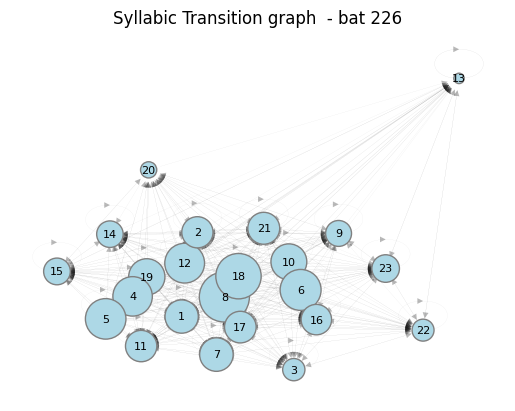

In [312]:
graph_trans = make_graph_transitions(symbolic_sequences)
plot_graph_transitions(graph_trans, subtitle = f" - {DS_FILENAME.replace('_',' ') }")

In [60]:
q.Emitter.unique()

array([230])

In [147]:
symbolic_sequences.Emitter.explode().value_counts()

231    3010
Name: Emitter, dtype: int64

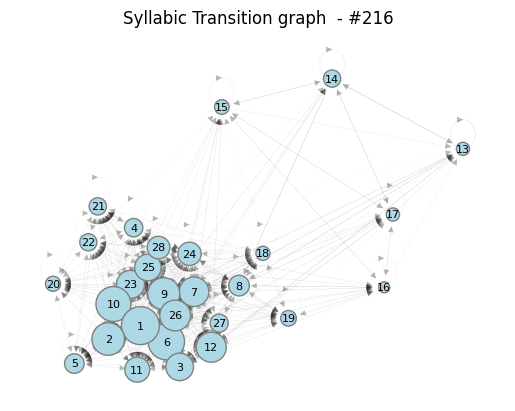

In [241]:
# plot graphs for emitters with more recordings
# for emitter in [111, 120, 216, 221]: # offspring
for emitter in q.Emitter.unique():
    
    test_emitter = emitter
    test_ix = symbolic_sequences.Emitter.explode()[symbolic_sequences.Emitter.explode() == test_emitter].index.values
    
    graph_trans = make_graph_transitions(symbolic_sequences.loc[test_ix])
    
    plot_graph_transitions(graph_trans, subtitle = f' - #{test_emitter}')
    

In [63]:
context_dict = {
    0:'Unknown',
    1:'Separation',
    2:'Biting',
    3:'Feeding',
    4:'Fighting',
    5:'Grooming',
    6:'Isolation',
    7:'Kissing',
    8:'Landing',
    9:'Mating protest',
    10:'Threat-like',
    11:'General',
    12:'Sleeping',
}

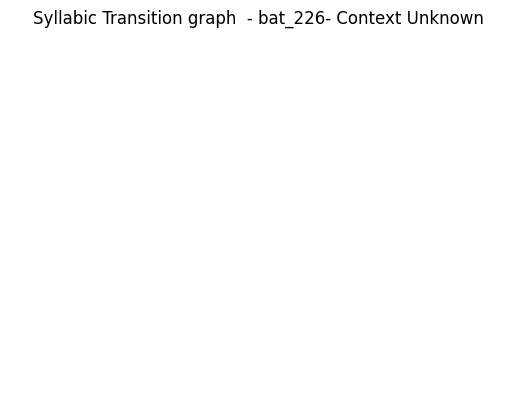

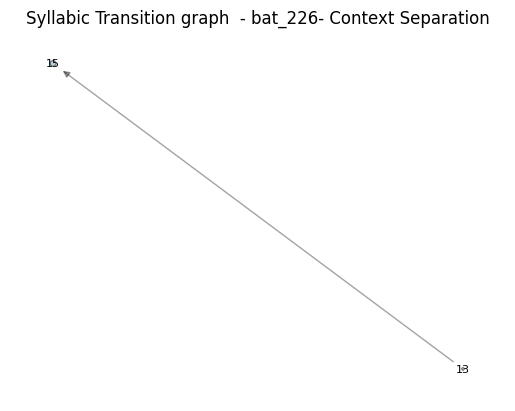

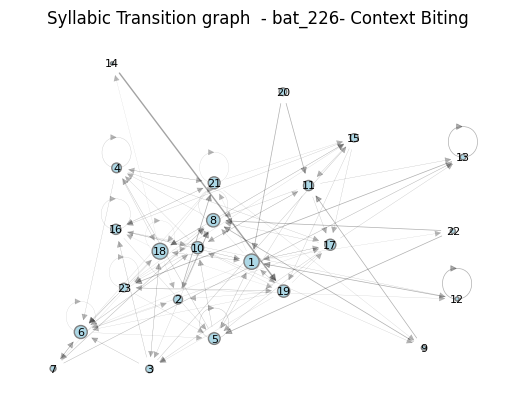

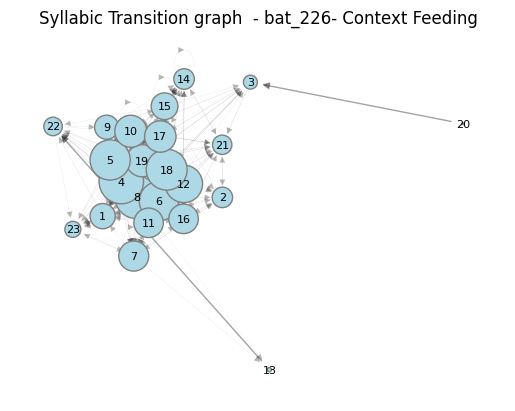

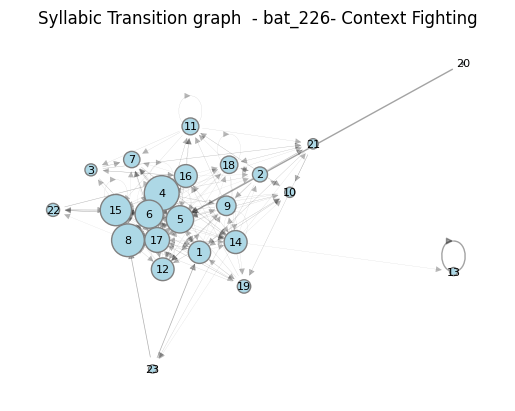

...

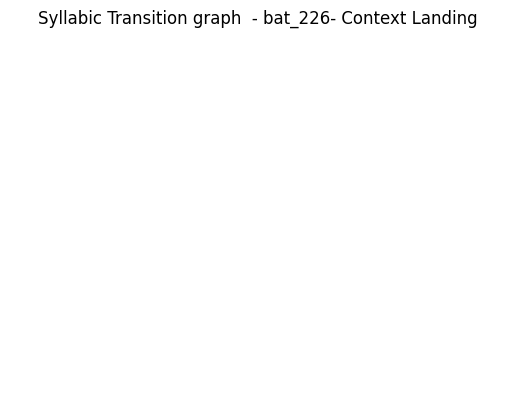

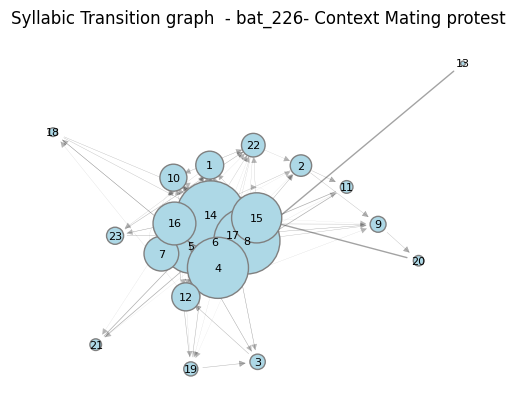

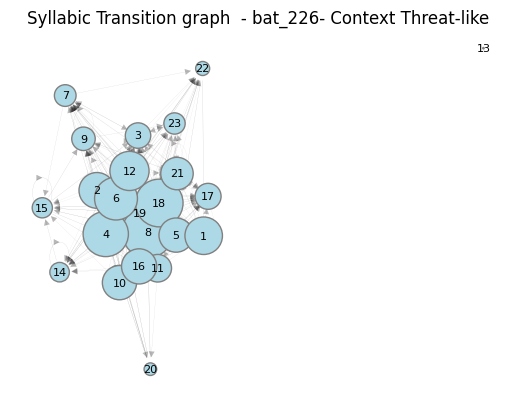

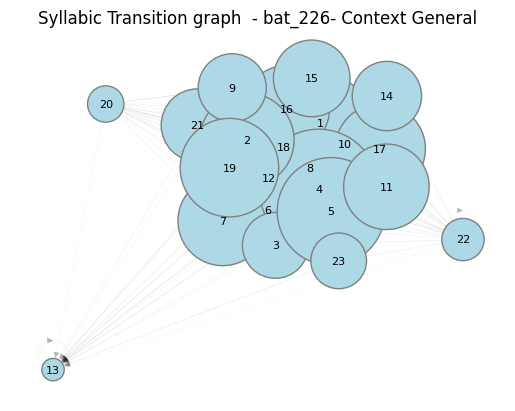

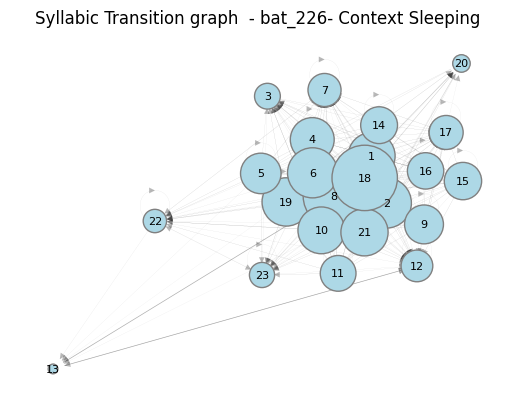

In [313]:
# plot graphs for context-type 
for context in context_dict.keys():    
    test_context = context
    test_ix = symbolic_sequences.label_context.explode()[symbolic_sequences.label_context.explode() == test_context].index.values
    
    graph_trans = make_graph_transitions(symbolic_sequences.loc[test_ix])
    
    plot_graph_transitions(graph_trans, subtitle = f' - {DS_FILENAME}- Context {context_dict[context]}')
    

In [314]:
# Save The Sequences!

def save_sequences(DS_FILENAME, number_of_clusters):
    with open(f'symbolic_sequences_{DS_FILENAME}_{number_of_clusters}_symseq.pkl','wb') as f:
        pickle.dump(symbolic_sequences, f)

    # Save The Graph!
    with open(f'graph_symbolic_sequences_{DS_FILENAME}_{number_of_clusters}_graphsymseq.pkl','wb') as f:
        pickle.dump(graph_trans, f)
        
save_sequences(DS_FILENAME, THRESHOLD[1])

In [393]:
# Get transition probabilities and classes 

tp_df = symbolic_sequences['Seq_Syllables'] \
    .apply(lambda x : list(zip(x[0:], x[1:]))) \
    .apply(lambda x : [G.edges[u, v]['weight'] for u, v in x]) \

tp_df = tp_df[ tp_df.apply(lambda x: len(x) > 0) ]

tp_df

NameError: name 'G' is not defined

In [200]:
y = pup2mother_All.loc[tp_df.index]['Emitter']

In [215]:
X = tp_df
X

0                     [0.13636363636363635, 0.1875]
2        [0.13157894736842105, 0.13157894736842105]
3        [0.09090909090909091, 0.13157894736842105]
10      [0.10526315789473684, 0.037037037037037035]
11        [0.2727272727272727, 0.13157894736842105]
                           ...                     
1552                          [0.08333333333333333]
1554                                          [0.2]
1559                          [0.09090909090909091]
1562                                         [0.16]
1572                                         [0.16]
Name: Seq_Syllables, Length: 766, dtype: object

In [195]:
# Convert X and Y to numpy arrays
X = tp_df.values
Y = y.values

# Get unique labels and convert them to integers
unique_labels = np.unique(Y)

# Define and train the HMM
n_components = len(unique_labels)
hmm_model = hmm.GaussianHMM(n_components=n_components)
hmm_model.fit(X)


ValueError: setting an array element with a sequence.

In [226]:
import numpy as np
from pomegranate import *



from keras.utils.data_utils import  pad_sequences


# Define the number of hidden states
n_states = 5

# Define the initial probabilities for the hidden states
start_prob = np.ones(n_states) / n_states

# Define the transition probabilities between hidden states
trans_mat = np.random.rand(n_states, n_states)
trans_mat /= np.sum(trans_mat, axis=1, keepdims=True)

# Define the emission probabilities for each hidden state
dists = [MultivariateGaussianDistribution.from_samples(np.random.rand(100, 2)) for _ in range(n_states)]

# Create the HMM model
model = HiddenMarkovModel.from_matrix(trans_mat, dists, start_prob)

# Train the HMM model on the transition probabilities X
X_lengths = [len(x) for x in X]
X_padded = pad_sequences(X, padding='post')
model.fit(X_padded, Y, X_lengths)

# Predict the classes for a new sequence
new_X = [[0.3, 0.4, 0.5, 0.6, 0.7]]
max_len = max(len(seq) for seq in new_X)
new_X_padded = pad_sequences(new_X, padding='post', maxlen=max_len, dtype='float32')

pred_Y = model.predict(new_X)

print(pred_Y)

[2]


In [ ]:
dists

In [220]:
X = X.to_list()

# Convert X to a 2D numpy array
X_padded = pad_sequences(X, padding='post')
X_np = np.array(X_padded)

In [224]:
new_X_padded

array([[0.1, 0.2, 0. , 0. , 0. ],
       [0.3, 0.4, 0.5, 0.6, 0.7]], dtype=float32)

In [156]:
G.edges(54, data=True)

OutEdgeDataView([(54, 50, {'weight': 0.3333333333333333, 'edge_color': (0.0, 0.0, 0.0, 0.13333333333333333), 'edge_width': 1}), (54, 55, {'weight': 0.6666666666666666, 'edge_color': (0.0, 0.0, 0.0, 0.16666666666666669), 'edge_width': 2}), (54, 30, {'weight': 0.3333333333333333, 'edge_color': (0.0, 0.0, 0.0, 0.13333333333333333), 'edge_width': 1})])

In [155]:
list(G.successors(54, data=True))

TypeError: DiGraph.successors() got an unexpected keyword argument 'data'

In [255]:
from hmmlearn import hmm

# Define the HMM model
n_components = 3  # Number of hidden states
model = hmm.MultinomialHMM(n_components=n_components)

# Train the HMM model
model.fit(transition_probabilities)

MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


NameError: name 'transition_probabilities' is not defined

In [232]:
def get_node_transitions(G, parent, order = 1):
    
    for child in G.successors(parent):
        p = G.get_edge_data(parent, child)['weight']
        yield (parent, p, child)


In [228]:
list(get_node_transitions(G, 54, order = 1))

[(54, 1, 50), (54, 2, 55), (54, 1, 30)]

In [233]:
# find the second neighbors of node 1
second_neighbors = []
for child in G.successors(54):
    for grandchild in G.successors(child):
        p = G.get_edge_data(child, grandchild)['weight']
        second_neighbors.append((child, p, grandchild))

print(second_neighbors)

[(50, 7, 48), (50, 2, 26), (50, 13, 42), (50, 1, 28), (50, 13, 49), (50, 14, 50), (50, 9, 44), (50, 5, 36), (50, 4, 5), (50, 2, 21), (50, 1, 43), (50, 1, 3), (50, 2, 9), (50, 2, 17), (50, 2, 46), (50, 3, 16), (50, 3, 23), (50, 1, 51), (50, 1, 45), (50, 5, 47), (50, 1, 52), (50, 1, 4), (50, 1, 40), (50, 1, 35), (50, 1, 41), (50, 1, 34), (50, 1, 29), (50, 1, 15), (50, 1, 19), (50, 1, 13), (50, 1, 38), (50, 1, 18), (55, 2, 51), (55, 3, 55), (55, 1, 34), (55, 2, 19), (55, 1, 14), (55, 1, 41), (55, 1, 29), (55, 1, 23), (55, 1, 17), (55, 1, 25), (55, 1, 36), (55, 1, 16), (55, 1, 7), (55, 1, 48), (55, 1, 56), (55, 1, 39), (55, 1, 57), (55, 1, 49), (55, 1, 21), (55, 1, 40), (30, 1, 45), (30, 1, 34), (30, 1, 56), (30, 2, 36), (30, 1, 28), (30, 1, 16), (30, 1, 43), (30, 1, 10), (30, 1, 31), (30, 1, 44), (30, 1, 6)]


In [ ]:
def find_paths(graph, node, order):
    """Find all paths of a given order from a node in a directed weighted graph.
    Returns a list of tuples with the path from the original node to each found node.
    """
    if order == 0:
        return [(node,)]
    elif order == 1:
        return [(node, n, graph.edges[(node, n)]['weight']) for n in graph.successors(node)]
    else:
        paths = []
        for n in graph.successors(node):
            child_paths = find_paths(graph, n, order-1)
            for p in child_paths:
                paths.append([(node, n, graph.edges[(node, n)]['weight']), p])
        return paths


# Example usage:
# Assuming `graph` is a directed weighted graph, and `node` is a node in the graph:
for path in find_paths(G, 54, 3):
    print(path)

In [300]:
import numpy as np
import networkx as nx
from scipy.optimize import curve_fit

# Define mutual information decay function
def mutual_info_decay(x, a, b, c):
    return a * np.exp(-b * x) + c

def power_law_decay(x, a, b):
    return a * np.power(x, -b)

# Create a sample graph representing the probability of transitions between syllables
G = nx.DiGraph()
G.add_weighted_edges_from([(1,2,0.2), (1,3,0.3), (1,4,0.1), (1,5,0.4),
                           (2,3,0.5), (2,4,0.2), (2,5,0.3),
                           (3,4,0.6), (3,5,0.4),
                           (4,5,1)])

# Extract edge weights as y data
y = np.array([G[u][v]['weight'] for u,v in G.edges()])

# Compute shortest path length between all pairs of nodes
dist_matrix = nx.floyd_warshall_numpy(G)

dist_matrix[np.isinf(dist_matrix)] = 0

# Extract shortest path lengths as x data
x = dist_matrix.flatten()

# Remove NaNs from x and y
#x = x[~np.isnan(x).any()]
#x = x[~np.isnan(x).any()]


In [289]:
y.shape

(10,)

In [297]:

# Fit mutual information decay function to x and y data
popt, pcov = curve_fit(mutual_info_decay, x, y)

In [317]:
def markov_order1_decay(x, a, b):
    return a * np.exp(-b * x)

# Example data
x1 = np.array([[1, 2, 3, 4, 5]])
x2 = np.array([1, 2, 3, 4, 5])
x = np.vstack((x1,x2))
y1 = np.array([0.5, 0.111, 0.1, 0.01, 0.01])
y2 = np.array([0.5, 0.111, 0.1, 0.01, 0.01])
y = np.vstack((y1,y2))

# Check if x and y have the same length
if len(x) != len(y):
    # Iterate through pairs of nodes and remove pairs that don't have a mutual information value
    for i in range(len(x)):
        if np.isnan(y[i]):
            x = np.delete(x, i)
            y = np.delete(y, i)

# Fit the mutual information decay function to the data
popt1, pcov1 = curve_fit(mutual_info_decay, x, y)
popt2, pcov2 = curve_fit(power_law_decay, x, y)
popt3, pcov3 = curve_fit(markov_order1_decay, x, y)




TypeError: Improper input: func input vector length N=3 must not exceed func output vector length M=2

Optimal parameter values:
a: 2.099192016725555
b: 1.4878363024326196
c: 0.023781042074671143


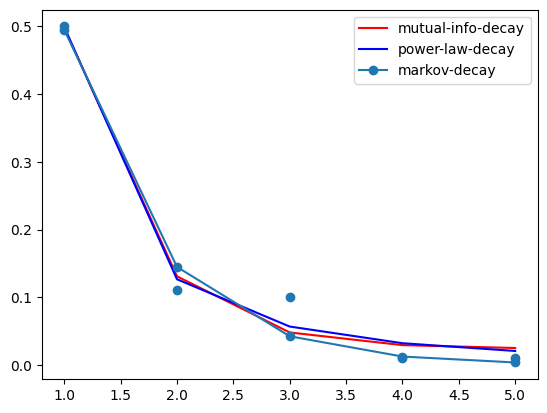

In [313]:
# Print optimal parameter values
print('Optimal parameter values:')
print('a:', popt[0])
print('b:', popt[1])
print('c:', popt[2])

# Plot x and y data along with the fitted mutual information decay function
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.scatter(x, y)
ax.plot(x, mutual_info_decay(x, *popt1), 'r-', label='mutual-info-decay')
ax.plot(x, power_law_decay(x, *popt2), 'b-', label='power-law-decay')
ax.plot(x, markov_order1_decay(x, *popt3), 'o-', label='markov-decay')
ax.legend()
plt.show()

In [ ]:
# Fit the mutual information decay function to the data
popt, pcov = curve_fit(power_law_decay, x, y)

[-4.80000004e+00  4.25596141e-02  5.60000004e+00  1.20122746e+02]


/tmp/ipykernel_1588045/2836444084.py:6: RuntimeWarning: overflow encountered in exp
  return a * np.exp(-b * x**n) + c
/tmp/ipykernel_1588045/2823389734.py:10: RuntimeWarning: divide by zero encountered in power
  return a * np.power(x, -b)


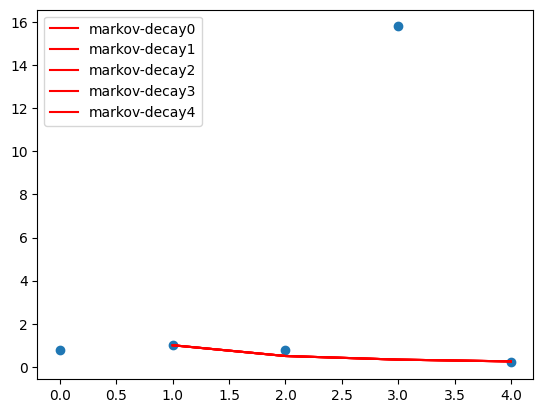

In [337]:
import numpy as np
from scipy.optimize import curve_fit

# Define markov decay function
def markov_decay(x, a, b, c, n):
    return a * np.exp(-b * x**n) + c

# Create an example matrix of observed transitions between syllables
observed_transitions = np.array([
    [0.1, 0.2, 0.3, 0.2, 0.2],
    [3.3, 4.1, 3.2, 78.2, 0.2],
    [0.2, 0.3, 0.1, 0.2, 0.2],
    [0.2, 0.2, 0.2, 0.1, 0.3],
    [0.2, 0.2, 0.2, 0.3, 0.1]
])

#t = np.array([[1, 2, 3, 4, 5]])

# Calculate the average transition probability for each time step
average_transitions = observed_transitions.mean(axis=0)

# Define x values as time steps
x = np.arange(len(average_transitions))

# Fit the markov decay function to the observed transitions
popt, pcov = curve_fit(markov_decay, x, average_transitions, p0=[1, 1, 0, 2], maxfev=1000)

# Print the optimal parameters
print(popt)

fig, ax = plt.subplots()
ax.scatter(x, average_transitions)
#ax.plot(x, markov_decay(x, *popt), 'r-', label='markov-decay')
for i, obs in enumerate(observed_transitions):
    #ax.scatter(x, obs)
    popt, pcov = curve_fit(power_law_decay, x, obs, maxfev=1000)
    ax.plot(x, power_law_decay(x, *popt), 'r-', label=f'markov-decay{i}')
ax.legend()
plt.show()

In [325]:
for obs in observed_transitions:
    print(obs)
    break

[0.1 0.2 0.3 0.2 0.2]


In [321]:
x

array([0, 1, 2, 3, 4])

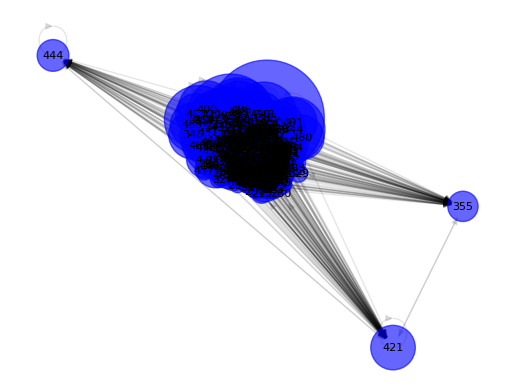

In [256]:
from collections import Counter

# Compute the directed graph
seq = symbolic_sequences['Seq_Syllables'].tolist()
edges = [(seq[i][j], seq[i][j+1]) for i in range(len(seq)) for j in range(len(seq[i])-1)]
G = nx.DiGraph()
G.add_edges_from(edges)

# Count the occurrences of each node
counts = Counter([item for sublist in seq for item in sublist])

# Compute the node sizes based on their counts
node_sizes = [counts[node]**1.5 for node in G.nodes()]

# Compute the node positions using a circular layout
pos = nx.spring_layout(G)

# Adjust the positions based on the node degrees
for node, degree in G.degree:
    pos[node] *= (degree + 1) * 10

# Draw the graph
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color='blue', alpha=0.6)
nx.draw_networkx_edges(G, pos, width=1, alpha=0.1, arrowsize=10)
nx.draw_networkx_labels(G, pos, font_size=8, font_family='sans-serif')
plt.axis('off')
plt.show()

/tmp/ipykernel_826237/3878603939.py:34: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(embedding[:, 0], embedding[:, 1],  cmap='Spectral', s=10)


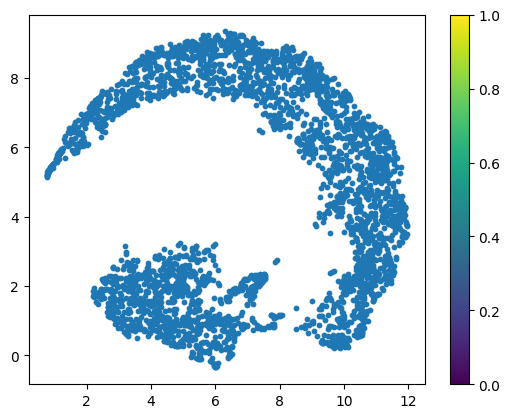

In [113]:
# Determine the length of the longest MFCC
max_len = max(len(mfcc[0]) for mfcc in mfccs)

# Initialize array for padded/truncated MFCCs
mfccs_fixed = np.zeros((len(mfccs), 20, max_len))

# Pad or truncate MFCCs to fixed length
for i, mfcc in enumerate(mfccs):
    if mfcc.shape[1] < max_len:
        # Pad MFCC with zeros
        mfccs_fixed[i, :, :mfcc.shape[1]] = mfcc
    #else:
    #    # Truncate MFCC
    #    mfccs_fixed[i, :, :] = mfcc[:, :max_len]
    
    
import umap
import umap.plot
from sklearn.cluster import KMeans

# Convert mfccs to a 2D array, skip first component
mfccs_flat = [mfcc[1:].flatten() for mfcc in mfccs_fixed]

# Dimensionality reduction with UMAP
reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, random_state=42, metric='euclidean')

# embedding
embedding = reducer.fit_transform(mfccs_flat)

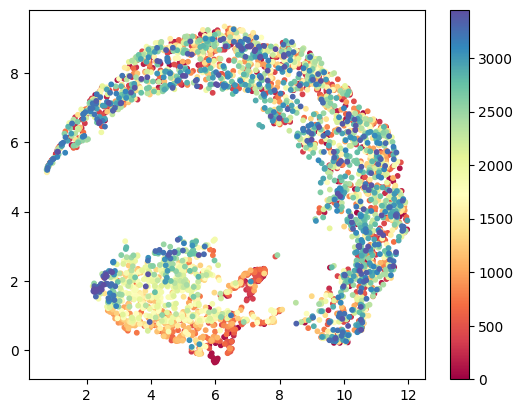

In [123]:
import matplotlib.pyplot as plt

# Plot UMAP embeddings
plt.scatter(embedding[:, 0], embedding[:, 1], c=range(len(np.array(context_classes))), cmap='Spectral', s=10)
plt.colorbar()
plt.show()

<Axes: >

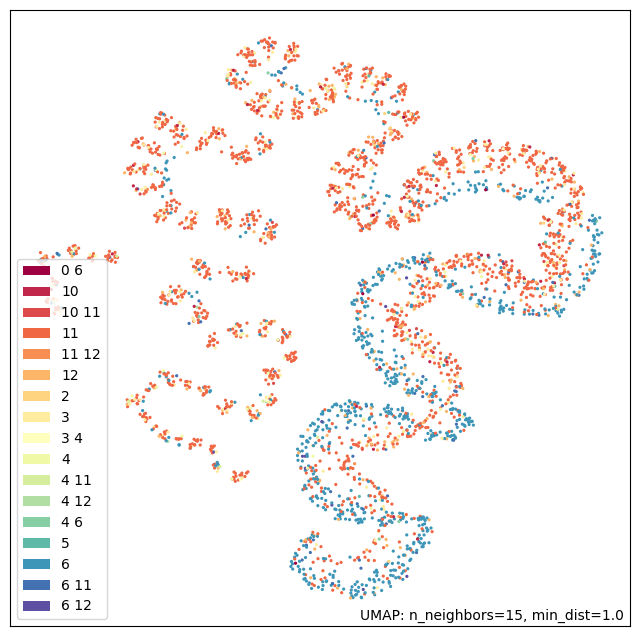

In [122]:
umap.plot.points(mapper, labels= np.array(context_classes))

Trustworthiness: 0.972520067445616


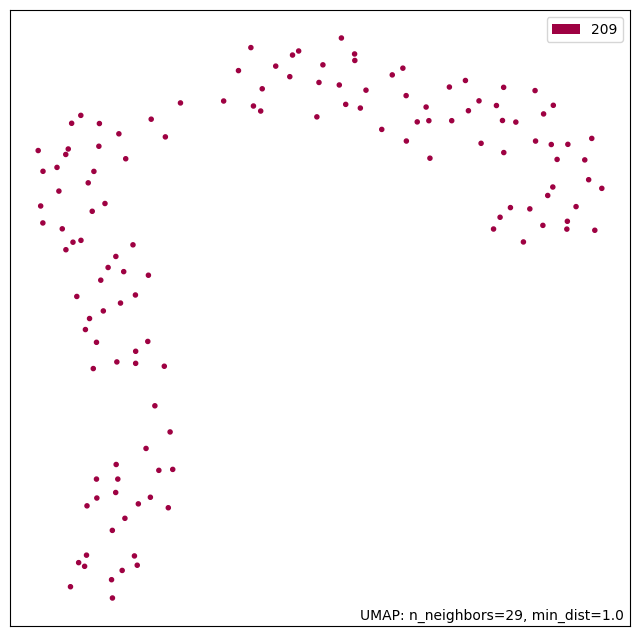

In [578]:
from sklearn.manifold import trustworthiness



mfccs_flat = np.array([mfcc[0:].flatten() for mfcc in mfccs_fixed])


reducer = umap.UMAP(min_dist=1., random_state=42, n_neighbors=29, metric='euclidean')
mapper = reducer.fit(mfccs_flat)
embedding = reducer.fit_transform(mfccs_flat)
umap.plot.points(mapper, labels= np.array(classes))


trust = trustworthiness(mfccs_flat, embedding, n_neighbors=29)
#cont = continuity(dist_umap / dist_orig)

print("Trustworthiness:", trust)

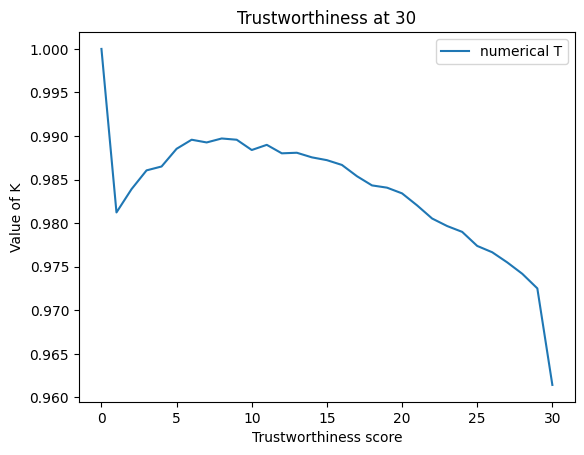

In [579]:
from umap import validation

K = 30

numerical_trustworthiness = validation.trustworthiness_vector(source=np.array(mfccs_flat)
                                  ,embedding=embedding
                                  ,max_k=K)

#categorical_trustworthiness = validation.trustworthiness_vector(source=np.array(mfccs_flat),embedding=embedding ,max_k=K)


_=plt.plot(numerical_trustworthiness)
#_=plt.plot(categorical_trustworthiness)
_=plt.ylabel("Value of K")
_= plt.xlabel(f"Trustworthiness score")
_=plt.title(f"Trustworthiness at {K}")
_=plt.legend(["numerical T"], loc="upper right")

In [581]:
from sklearn.decomposition import PCA

# Concatenate the matrices along the columns to form a single matrix
mfcc_matrix = np.vstack(mfccs_fixed)
#mfcc_matrix = mfccs_fixed

# Apply PCA to the matrix
pca = PCA()
pca.fit(mfcc_matrix)

# Select the first two principal components and project them onto UMAP
#mfcc_pca = pca.transform(mfcc_matrix.T)[:, :2]
#umap_embedding = umap.UMAP().fit_transform(mfcc_pca)

PCA()

In [582]:
# List of MFCC
#mfcc_list = [...]  # replace [...] with your MFCC data

# Convert list of MFCC to numpy array
#mfcc_array = np.array(mfcc_list)

# Apply PCA
pca = PCA()
pca.fit(mfccs_fixed[7])

# Get explained variance ratio for each component
explained_var_ratio = pca.explained_variance_ratio_

# Print explained variance ratio for each component
print(explained_var_ratio)

[9.86447705e-01 9.91299478e-03 1.00934388e-03 6.37420242e-04
 4.53278808e-04 3.05723870e-04 2.76773568e-04 1.94411248e-04
 1.91023473e-04 1.44590306e-04 1.04717819e-04 8.95216299e-05
 5.84994517e-05 5.21054627e-05 3.83233792e-05 2.99520893e-05
 2.37318696e-05 2.00174155e-05 9.86581510e-06 6.31080636e-34]


In [583]:
mfccs_fixed.shape

(132, 20, 240)

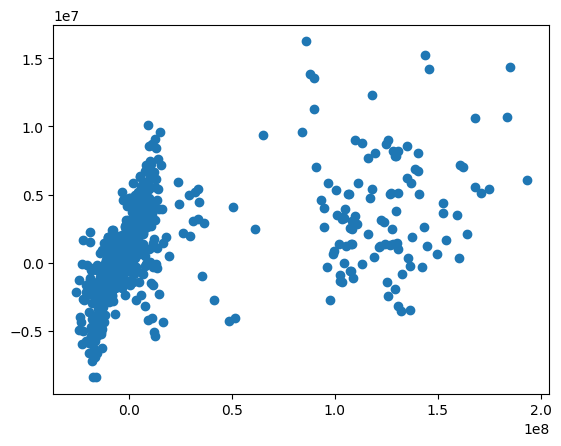

In [584]:
mfcc_pca = pca.transform(mfcc_matrix)[:, :2]
plt.scatter(mfcc_pca[:,0], mfcc_pca[:,1])

In [585]:
# find the principal component with the highest proportion of variance
variance_ratios = pca.explained_variance_ratio_
max_var_idx = np.argmax(variance_ratios)

# examine the corresponding eigenvector
eigenvectors = pca.components_
max_var_eigenvector = eigenvectors[max_var_idx]

# plot the scores of the samples along the first two principal components
scores = pca.transform(X)[:, :2]

NameError: name 'X' is not defined

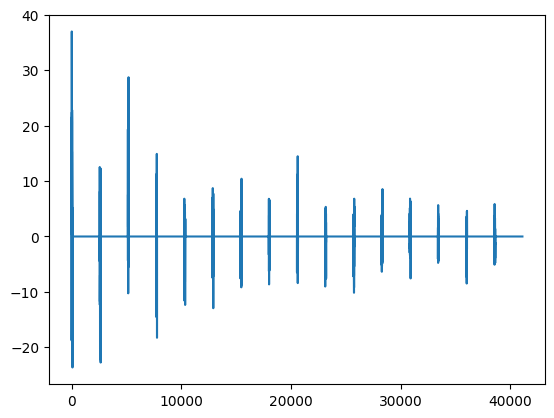

In [46]:
plt.plot(mfccs_fixed[23][4:].flatten())

In [580]:
from sklearn.cluster import DBSCAN 

dbscan = DBSCAN(eps=.05, min_samples=5).fit(pos)

# Plot DBSCAN results
plt.scatter(embedding[:, 0], embedding[:, 1], c=[i for i in range(len(classes))], cmap='Spectral', s=5)
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.title("DBSCAN Clustering Results")
plt.show()

ValueError: Expected 2D array, got scalar array instead:
array={15: array([ 1.10000000e+03, -6.55651111e-06]), 2: array([365.41817089, 162.69465915]), 13: array([468.39138794, 520.20141968]), 10: array([247.2135623 , 760.84524916]), 5: array([-94.07568681, 895.06974474]), 14: array([-250.00005141,  433.01270361]), 4: array([-809.0170547 ,  587.78525496]), 11: array([-1173.77721949,   249.49393276]), 12: array([-782.51809865, -166.32944109]), 1: array([-728.11529558, -529.00679384]), 6: array([ -99.99999076, -173.20509575]), 3: array([ -31.35850863, -298.35658516]), 7: array([  92.70513057, -285.31695413]), 9: array([ 133.8261466 , -148.62894367]), 8: array([ 365.41821857, -162.69460432])}.
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [125]:
from IPython.display import Audio, HTML, display


i, k = 1, 37
display(Audio(data = voc_segments[i], rate = 88200), Audio(data = voc_segments[k], rate = 88200) )

In [71]:
def LB_Keogh(s1,s2,r):
    LB_sum=0
    for ind,i in enumerate(s1):
        
        lower_bound=min(s2[(ind-r if ind-r>=0 else 0):(ind+r)])
        upper_bound=max(s2[(ind-r if ind-r>=0 else 0):(ind+r)])
        
        if i>upper_bound:
            LB_sum=LB_sum+(i-upper_bound)**2
        elif i<lower_bound:
            LB_sum=LB_sum+(i-lower_bound)**2
    
    return sqrt(LB_sum)

In [133]:
import numpy as np
from tslearn.metrics import lb_keogh

# Generate two example spectrogram matrices


In [167]:
distances_specs = [] 
distances_specs_dwt = []

for spec1 in specs[:10]:
    for spec2 in specs[:10]:
        max_time = max(spec1.shape[1], spec2.shape[1])
        spec1_padded = np.pad(spec1, ((0, 0), (0, max_time - spec1.shape[1])), 'constant')
        spec2_padded = np.pad(spec2, ((0, 0), (0, max_time - spec2.shape[1])), 'constant')
        
        d = lb_keogh(spec1_padded.flatten(), spec2_padded.flatten(), radius=10) 
        distances_specs.append(d)

        D, wp = librosa.sequence.dtw(spec1, spec2)
        distances_specs_dwt.append(D[wp[-1, 0], wp[-1, 1]])
        
distances_specs, distances_specs_dwt

KeyboardInterrupt: 

In [160]:
distances_specs

0.0

In [73]:
for x in test:
    for y in test:
        LB_Keogh(x,y,20)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [74]:
x.shape

(2049, 3364)

In [75]:
y.shape

(2049, 3364)

In [103]:
import librosa
import numpy as np
import umap

# Load audio file
#y, sr = librosa.load('example.wav')

y, sr = data, rate

# Apply bandpass filter
y_filtered = butter_bandpass_filter(data, 1000, 120000, sr, order=5)

# Compute MFCCs and chroma features for segments of different durations
win_sizes = [0.1, 0.5, 1.0] # duration of segments in seconds
n_mfcc = 13
n_chroma = 12

mfccs = []
chromas = []

for win_size in win_sizes:
    win_length = int(win_size * sr)
    hop_length = int(win_length / 2)
    mfcc = librosa.feature.mfcc(y_filtered, sr=sr, n_mfcc=n_mfcc, n_fft=win_length, hop_length=hop_length)
    chroma = librosa.feature.chroma_stft(y_filtered, sr=sr, n_chroma=n_chroma, n_fft=win_length, hop_length=hop_length)
    mfccs.append(mfcc)
    chromas.append(chroma)

# Pad arrays to have same dimensions
max_frames = max([mfcc.shape[1] for mfcc in mfccs] + [chroma.shape[1] for chroma in chromas])

mfccs_padded = []
chromas_padded = []

for mfcc, chroma in zip(mfccs, chromas):
    mfcc_pad_width = ((0, 0), (0, max_frames - mfcc.shape[1]))
    chroma_pad_width = ((0, 0), (0, max_frames - chroma.shape[1]))
    mfcc_padded = np.pad(mfcc, pad_width=mfcc_pad_width, mode='constant')
    chroma_padded = np.pad(chroma, pad_width=chroma_pad_width, mode='constant')
    mfccs_padded.append(mfcc_padded)
    chromas_padded.append(chroma_padded)

# Stack arrays
mfccs_stacked = np.stack(mfccs_padded, axis=2)
chromas_stacked = np.stack(chromas_padded, axis=2)

# Flatten arrays
mfccs_flattened = mfccs_stacked.reshape(mfccs_stacked.shape[0], -1)
chromas_flattened = chromas_stacked.reshape(chromas_stacked.shape[0], -1)

# Apply UMAP
mfccs_umap = umap.UMAP().fit_transform(mfccs_flattened)
chromas_umap = umap.UMAP().fit_transform(chromas_flattened)

TypeError: mfcc() takes 0 positional arguments but 1 positional argument (and 2 keyword-only arguments) were given

### Test HMM and Power-Law

In [219]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from sklearn.metrics import mutual_info_score
import powerlaw
import hmmlearn.hmm as hmm

# Define the threads
threads = [
    [12, 2, 12, 12, 3, 5],
    [2, 12],
    [2,3,5,5],
    [3,4],
    [2,5,5,5]
]

# Define the order of HMM to test
hmm_orders = [1, 2, len(threads[0])]

# Define the power law fit range
power_law_range = [1, len(threads[0]) // 2]

# Loop over each thread
for thread in threads:
    # Calculate the mutual information
    mutual_infos = [mutual_info_score(thread[:-i-1], thread[i+1:]) for i in range(len(thread)-1)]
    
    # Divide the sequence into two parts
    n = len(mutual_infos) // 2
    mi_1, mi_2 = mutual_infos[:n], mutual_infos[n:]
    
    # Fit the decay curve using HMM of different orders
    aic_scores = []
    for order in hmm_orders:
        model = hmm.MultinomialHMM(n_components=order)
        model.fit(np.array([mi_1]).T)
        aic_scores.append(model.score(np.array([mi_2]).T))
    
    best_hmm_order = np.argmin(aic_scores)
    model = hmm.MultinomialHMM(n_components=hmm_orders[best_hmm_order])
    model.fit(np.array([mi_1]).T)
    hmm_predicted = model.predict(np.array([mi_2]).T)
    
    # Fit the decay curve using power law function
    fit = powerlaw.Fit(mi_2, xmin=power_law_range[0], xmax=power_law_range[1])
    alpha = fit.alpha
    
    # Test if the sequence better follows a combination of HMM and power law decay
    hmm_count = [0] * hmm_orders[best_hmm_order]
    for i in range(len(hmm_predicted)):
        hmm_count[hmm_predicted[i]] += 1
    hmm_prob = [c / len(hmm_predicted) for c in hmm_count]
    
    if hmm_prob[0] < 0.5:
        print("The sequence better follows a combination of HMM and power law decay")
    else:
        print("The sequence does not follow a combination of HMM and power law decay")
    
    # Plot the results
    plt.figure()
    plt.plot(np.arange(len(mutual_infos)-1), mutual_infos)
    plt.axvline(n, linestyle='--', color='grey')
    plt.xlabel("Time lag")
    plt.ylabel("Mutual information")
    
    plt.twinx()
    plt.plot(np.arange(n, len(mutual_infos)), hmm_prob, '-o', label="HMM")

MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


ValueError: Symbol counts should be nonnegative integers

In [215]:
# Scale the mutual information values and convert to integer counts
counts = np.round(mi_1 * 100).astype(int)

# Create an instance of the power-law model and fit the counts
model = powerlaw.Fit(counts)

# Get the alpha parameter of the power-law fit
alpha = model.alpha

# Print the alpha parameter
print(f"Alpha parameter for power-law fit: {alpha}")

Calculating best minimal value for power law fit
Alpha parameter for power-law fit: nan


Values less than or equal to 0 in data. Throwing out 0 or negative values
Less than 2 unique data values left after xmin and xmax options! Cannot fit. Returning nans.


In [216]:
from hmmlearn import hmm
import numpy as np

# define the number of hidden states
n_states = 3

# define the model
model = hmm.MultinomialHMM(n_components=n_states, n_iter=100)

# fit the model to the data
for thread in threads:
    # calculate the mutual information between adjacent elements in the thread
    mi_1 = mutual_information(thread[:-1], thread[1:])
    
    # normalize the mutual information to be between 0 and 1
    mi_1 = (mi_1 - mi_1.min()) / (mi_1.max() - mi_1.min())
    
    # estimate the transition matrix and the emission probabilities based on the mutual information
    transition_matrix = np.zeros((n_states, n_states))
    for i in range(n_states):
        for j in range(n_states):
            if i != j:
                transition_matrix[i, j] = np.mean(mi_1)
    np.fill_diagonal(transition_matrix, 1 - np.sum(transition_matrix, axis=1))
    
    emission_probabilities = np.zeros((n_states, len(set(thread))))
    for i in range(n_states):
        for j in range(len(set(thread))):
            emission_probabilities[i, j] = np.mean(thread == j)
    
    # set the model parameters
    model.transmat_ = transition_matrix
    model.emissionprob_ = emission_probabilities
    
    # predict the most likely sequence of hidden states for the thread
    hidden_states = model.predict(np.array([thread]).T)
    
    # print the most likely sequence of hidden states
    print(hidden_states)

MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340


NameError: name 'mutual_information' is not defined

In [217]:
import numpy as np

def mutual_information(x, y, bins=10):
    hist2d, _, _ = np.histogram2d(x, y, bins=bins)
    pxy = hist2d / np.sum(hist2d)
    px = np.sum(pxy, axis=1)
    py = np.sum(pxy, axis=0)
    px_py = px[:, np.newaxis] * py[np.newaxis, :]
    mask = np.nonzero(pxy)
    return np.sum(pxy[mask] * np.log2(pxy[mask] / px_py[mask]))

In [220]:
import numpy as np
from hmmlearn import hmm

# Define mutual_information function here

# Define the number of hidden states in the HMM
n_states = 2

# Define the order of the HMM
order = 1

# Define the number of bins for the mutual information calculation
n_bins = 10

# Loop over the threads and fit an HMM of the specified order
for i, thread in enumerate(threads):
    # Calculate the mutual information between consecutive elements of the thread
    mi = [mutual_information(thread[:-1], thread[1:], bins=n_bins)]
    
    # Fit an HMM of the specified order to the mutual information
    model = hmm.GaussianHMM(n_components=n_states, covariance_type='diag', n_iter=100)
    model.startprob_ = np.array([1.0, 0.0])
    model.transmat_ = np.array([[1.0, 0.0], [0.0, 1.0]])
    if order == 1:
        model.fit(np.array([mi]).T)
    else:
        obs = np.column_stack([mi[:-1], mi[1:]])
        model.fit(obs)
        
    # Plot the results
    # ...


Even though the 'startprob_' attribute is set, it will be overwritten during initialization because 'init_params' contains 's'
Even though the 'transmat_' attribute is set, it will be overwritten during initialization because 'init_params' contains 't'
Fitting a model with 7 free scalar parameters with only 1 data points will result in a degenerate solution.


ValueError: n_samples=1 should be >= n_clusters=2.

In [221]:
if len(mi) > 1:
    model = KMeans(n_clusters=2)
    model.fit(np.array([mi]).T)
    labels = model.labels_
    centers = model.cluster_centers_
    plt.plot(mi)
    plt.plot(np.arange(len(mi))[labels==0], mi[labels==0], 'ro')
    plt.plot(np.arange(len(mi))[labels==1], mi[labels==1], 'bo')
    plt.show()
else:
    print("Not enough data for clustering.")

Not enough data for clustering.


In [222]:
import numpy as np

transition_matrix = np.array([
    [0.7, 0.2, 0.1],
    [0.3, 0.4, 0.3],
    [0.2, 0.3, 0.5]
])

# Initial state is state A
state = 0
data = [state]

for i in range(1, 100):
    # Transition to new state based on transition probabilities
    state = np.random.choice(3, p=transition_matrix[state])
    data.append(state)
    
print(data)

[0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 2, 1, 0, 2, 2, 2, 2, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 2, 1, 2, 0, 0, 1, 2, 2, 2, 2, 1, 2, 2, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 0, 1, 2, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 2, 2, 2, 2, 1, 1, 2, 1, 1, 0, 0, 2, 1, 0, 0, 0, 0, 0]


In [ ]:
# HDBSCAN directly on MFCCS

In [139]:
import numpy as np
import hdbscan
from sklearn.preprocessing import StandardScaler

# Reshape MFCCs into a 2D array
mfccs_2d = np.concatenate(mfccs, axis=1).T

# Scale the MFCCs
scaler = StandardScaler()
mfccs_2d_scaled = scaler.fit_transform(mfccs_2d)

# Cluster the MFCCs using HDBSCAN
clusterer = hdbscan.HDBSCAN(min_cluster_size=5, min_samples=5, allow_single_cluster=True)
clusterer.fit(mfccs_2d_scaled)

# Get the cluster labels
labels = clusterer.labels_

# Print the number of clusters found
print(f"Number of clusters found: {len(set(labels))}")

Number of clusters found: 2


In [141]:
from sklearn.decomposition import TruncatedSVD


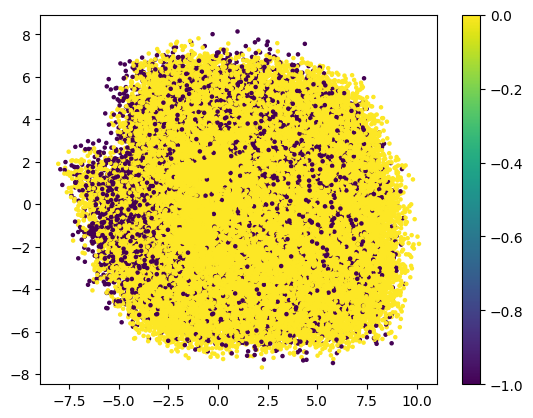

In [142]:
# Apply Truncated SVD to reduce the dimensionality for visualization
svd = TruncatedSVD(n_components=2)
mfccs_2d_svd = svd.fit_transform(mfccs_2d_scaled)

# Plot the clusters
plt.scatter(mfccs_2d_svd[:, 0], mfccs_2d_svd[:, 1], c=clusterer.labels_, cmap='viridis', s=5)
plt.colorbar()
plt.show()

# Query by Time

In [217]:
sample_fileIDs = file_info.query('FileID in [{}]'.format(','.join(str(x) for x in q['FileID'])))

In [218]:
sample_fileIDs

,FileID,TreatmentID,File name,File folder,Recording channel,Recording time,voice_start_sample_1,voice_end_sample_1,voice_start_sample_2,voice_end_sample_2,...,voice_start_sample_159,voice_end_sample_159,voice_start_sample_160,voice_end_sample_160,voice_start_sample_161,voice_end_sample_161,voice_start_sample_162,voice_end_sample_162,voice_start_sample_163,voice_end_sample_163
61822,61822,13,121004165931143478.WAV,files201,9,2012-10-04 16:59:31,35795.0,71747.0,210795.0,242041.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
61879,61879,13,121004172433181482.WAV,files201,9,2012-10-04 17:24:33,45141.0,74887.0,166141.0,195075.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
61882,61882,13,121004172647137483.WAV,files201,9,2012-10-04 17:26:47,34295.0,62041.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
61894,61894,13,121004172921179484.WAV,files201,9,2012-10-04 17:29:21,44829.0,79575.0,109329.0,144075.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
61900,61900,13,121004173710156486.WAV,files201,9,2012-10-04 17:37:10,39101.0,61041.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
293146,293146,20,140219054006223350.WAV,files224,1,2014-02-19 05:38:58,172697.0,192943.0,257361.0,294851.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
293155,293155,20,140219054741046380.WAV,files224,1,2014-02-19 05:46:33,50743.0,62473.0,111743.0,124989.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
293179,293179,20,140219055906489406.WAV,files224,1,2014-02-19 05:57:59,51288.0,69349.0,83372.0,105291.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
293182,293182,20,140219055915824409.WAV,files224,1,2014-02-19 05:58:08,50275.0,66021.0,100275.0,118021.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [219]:
# group rows by day and count the number of rows in each group
counts_by_day = sample_fileIDs.groupby(pd.Grouper(key='Recording time', freq='D')).size().reset_index(name='counts')


In [220]:
counts_by_day

,Recording time,counts
0,2012-10-04,6
1,2012-10-05,0
2,2012-10-06,0
3,2012-10-07,0
4,2012-10-08,0
...,...,...
499,2014-02-15,14
500,2014-02-16,37
501,2014-02-17,30
502,2014-02-18,28


In [222]:
fileID_by_emitter = q.set_index("Emitter").loc[215]["FileID"]

In [223]:
# group rows by day and count the number of rows in each group
counts_by_day = sample_fileIDs.loc[fileID_by_emitter].groupby(pd.Grouper(key='Recording time', freq='D')).size().reset_index(name='counts')

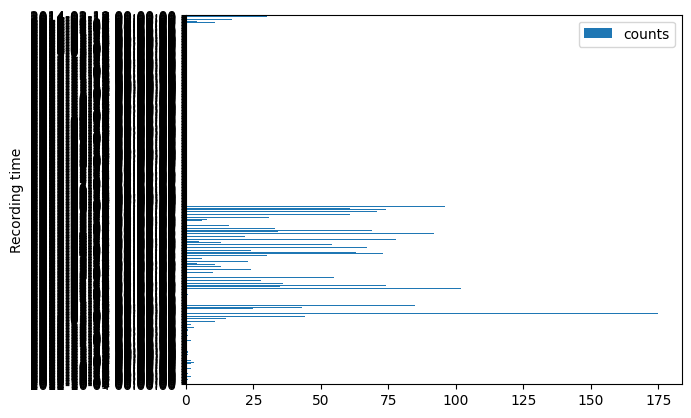

In [224]:
ax = counts_by_day.plot(
    kind='barh', 
    x='Recording time', 
    y='counts'
)


In [225]:
counts_by_day['Recording time']

0     2012-10-04
1     2012-10-05
2     2012-10-06
3     2012-10-07
4     2012-10-08
         ...    
499   2014-02-15
500   2014-02-16
501   2014-02-17
502   2014-02-18
503   2014-02-19
Name: Recording time, Length: 504, dtype: datetime64[ns]

In [227]:
counts_by_day

,Recording time,counts
0,2012-10-04,6
1,2012-10-05,0
2,2012-10-06,0
3,2012-10-07,0
4,2012-10-08,0
...,...,...
499,2014-02-15,14
500,2014-02-16,37
501,2014-02-17,30
502,2014-02-18,28


In [226]:
df['FileID']

Emitter
215     61822
215     61879
215     61882
215     61894
215     61900
        ...  
215    293146
215    293155
215    293179
215    293182
215    293184
Name: FileID, Length: 6136, dtype: int64

In [35]:
q.set_index('Emitter').loc[Emitter]

array([ 58196,  59887,  61127, ..., 146699, 146701, 146708])

Some things not clear:

Emitters produces more types of Contexts in 5 minutes:
- Emitter 111 : [ 3 11  4]
- Emitter 214 : [ 6 11 12  3]

In [245]:
# test if an Emitter "change topic" 
for Emitter in q.Emitter.unique():
    print(f'Emitter {Emitter}')
    df = q.set_index('Emitter').loc[Emitter]
    df.set_index('FileID')
    print(f"Contexts observed for this Emitter: {df['Context'].unique()} Number of vocalizations:{df.shape }")

    # collate each 5m
    groups = get_sample_files(q).set_index('FileID', drop=False).loc[df['FileID']].groupby(pd.Grouper(key='Recording time', freq='300s'))
    for name, group in groups:
        contexts_in_session = q.set_index('FileID').loc[group['FileID']]['Context'].unique()
        if len(contexts_in_session) > 1:
            print(f"Contexts: { contexts_in_session }")

Emitter 215
Contexts observed for this Emitter: [ 6 12 11  3  2  9  4  7  8 10  5] Number of vocalizations:(6136, 9)
Contexts: [ 6 12]
Contexts: [11  9  4]
Contexts: [12 11]
Contexts: [11 12]
Contexts: [12 11]
Contexts: [12  4]
Contexts: [12 11]
Contexts: [ 2 11]
Contexts: [11 12]
Contexts: [12 11]
Contexts: [11 12]
Contexts: [12  2]
Contexts: [12 11]
Contexts: [12 11]
Contexts: [12  2]
Contexts: [12 11]


KeyboardInterrupt: 

In [46]:
q.set_index('FileID').loc[group['FileID']]['Context'].unique()

array([6])

In [246]:
# Group the dataframe by 'Record time'
groups = sample_fileIDs.loc[df['FileID']].groupby(pd.Grouper(key='Recording time', freq='300s'))

# Loop through the groups and form sequences of 'File name'
sequences = []
for name, group in groups:
    if len(group) > 0:
        sequence = list(group['File name'])
        sequences.append(sequence)

In [247]:
for sequence in sequences:
    try:
        symbolic_sequences.loc[sequence]
    except:
        pass
        
        

In [268]:
tmp = symbolic_sequences.copy()

tmp.set_index('File name').loc[sequences[3]]

,Seq_Syllables,Seq_Syllables_ix,Pos_Segment,Duration,Folder,FileID,Emitter,label_addressee,label_context
File name,,,,,,,,,
121004173710156486.WAV,[13],[8],[0],[21940],files201,61900,[215],[217],[6]
121004173829175487.WAV,"[13, 13]","[9, 10]","[0, 1]","[28246, 27746]",files201,61902,[215],"[217, 217]","[6, 6]"


In [267]:
sequences[3]

['121004173710156486.WAV', '121004173829175487.WAV']

In [236]:
sample_fileIDs.set_index('File name').loc[symbolic_sequences.set_index('Fileoc[sequences[7]].index]

KeyError: "None of [Index(['121012171207154175.WAV'], dtype='object')] are in the [index]"

In [345]:
symbolic_sequences.loc[sequences[7]]

,Sequence,Duration,Folder
121005193853982507.WAV,[143],[14042],files201
121005193916033511.WAV,"[129, 141, 168]","[46807, 12966, 6404]",files201
121005193917444512.WAV,[137],[15497],files201


In [315]:
for ix in symbolic_sequences.loc[sequences[7]].index:
    sr, y, start_times, end_times = get_wav_info(ix)
    display(Audio(data = y, rate = 88200))

250000 394064


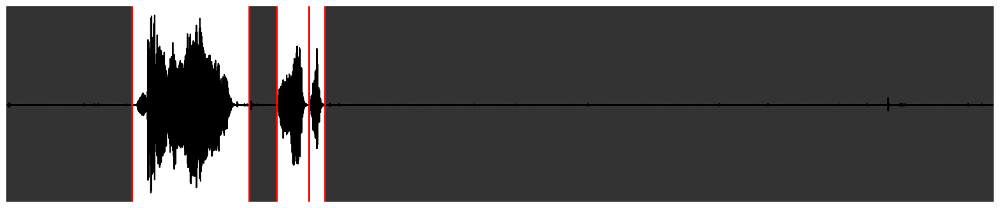

In [125]:
# test
#wav_loc = DSLOC/'zip_contents'/ 'files201' / '121004212010778472.WAV'
#wav_info = file_info[file_info['File name'] == '121004212010778472.WAV']


wav_loc = DSLOC/'zip_contents'/ 'files201' / '121005193916033511.WAV'
wav_info = file_info[file_info['File name'] == '121005193916033511.WAV']

rate, data = load_wav(wav_loc)
print(rate, len(data))

start_times = wav_info.loc[:, wav_info.columns.str.startswith('voice_start_')].dropna(axis=1).values[0]
end_times = wav_info.loc[:, wav_info.columns.str.startswith('voice_end_')].dropna(axis=1).values[0]

assert(len(start_times) == len(end_times))


fig, ax = plt.subplots(nrows=1,ncols=1, figsize=(20,4))
plt.plot(data, color='black')
ax.set_xlim((0, len(data)))
ax.axis('off')

# not selected silence
for st, et in zip(end_times[:-1], start_times[1:]):
    ax.axvspan(st, et, alpha=0.8, color='black')
    
ax.axvspan(0, start_times[0], alpha=0.8, color='black')
ax.axvspan(end_times[-1], len(data), alpha=0.8, color='black')

# selected
for st, et in zip(start_times, end_times):
    ax.axvline(x=st, color = 'red', lw=2)
    ax.axvline(x=et, color='red', lw=2)
plt.show()

Audio(data = data, rate = 88200)

In [129]:
Audio(data = np.array([data /  data.max()]), rate = 88200)


In [317]:
symbolic_sequences.loc[sequence]

KeyError: "None of [Index(['121215221048073824.WAV'], dtype='object')] are in the [index]"

In [197]:
sample_fileIDs.loc[fileID_by_emitter].groupby(pd.Grouper(key='Recording time', freq='D')).size().reset_index(name='counts')

,Recording time,counts
0,2012-10-04,7
1,2012-10-05,8
2,2012-10-06,9
3,2012-10-07,3
4,2012-10-08,2
...,...,...
68,2012-12-11,0
69,2012-12-12,10
70,2012-12-13,0
71,2012-12-14,4


In [204]:
symbolic_sequences

,Sequence,Duration,Folder
121002212651151905.WAV,"[135, -1, -1]","[28341, 19373, 28746]",files201
121004173829175487.WAV,"[135, 136]","[28246, 27746]",files201
121008193330171556.WAV,"[135, 60, 63]","[26246, 37246, 28246]",files202
121013043909583127.WAV,"[135, -1, 145, 147]","[6987, 10746, 9402, 28246]",files202
121014185946980156.WAV,"[135, -1, -1, -1, -1, 129, 62, 52, 77, 10]","[10569, 50161, 13841, 36379, 27525, 16854, 278...",files202
...,...,...,...
121207213417480542.WAV,[116],[46246],files209
121209175923901937.WAV,[116],[18676],files209
121209185628318962.WAV,[95],[23081],files209
121105224225528055.WAV,[148],[32668],files204


## Other tests

In [ ]:


X=10*np.log10(signal.welch(x, fs=fs, window='hanning', nperseg=256, noverlap=128+64)[1])

# Show one recording
plt.figure(figsize = (10,8))
plt.plot(np.linspace(0,len(x)/fs,len(x)),x)
plt.autoscale(enable=True, axis='x', tight=True)
plt.xlabel('time (s)')
plt.title('Wingbeat recording')
plt.show()